In [1]:
import numpy as np
import copy
import pandas as pd
import torch
from torch import nn
import torch.utils.data as Data
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.metrics import roc_auc_score, roc_curve
from sklearn.model_selection import cross_val_score, cross_validate, KFold
import os
from torch.nn import functional as F
import torch.utils.data as Data
from sklearn.metrics import confusion_matrix
import torch.nn.init as init
import random
from itertools import chain
import lightgbm as lgb
from scipy.misc import derivative
from sklearn.metrics import average_precision_score
import joblib
import shap
from sklearn.calibration import CalibratedClassifierCV
import matplotlib.pyplot as plt
from sklearn.metrics import brier_score_loss


WEIGHT = True
Youden = True
AUGMENT = False
RAND_TIME = 30
BIN = 15

In [2]:
data_temp = np.load('./data/T_MIND_new_data_prepare_without_dem_worst_no_norm_add_features.npy',allow_pickle=True)
data_temp = [i for i in data_temp]
dem_temp = np.load('./data/T_MIND_new_data_prepare_dem_instance_wise_worst_no_norm_add_features.npy',allow_pickle=True)
dem_temp = [i for i in dem_temp]
label_temp = np.load('./data/T_MIND_new_label_prepare_normal_worst_no_norm_add_features.npy',allow_pickle=True)
label_temp = [i for i in label_temp]
mask_temp = np.load('./data/T_MIND_new_mask_prepare_normal_worst_no_norm_add_features.npy',allow_pickle=True)
mask_temp = [i for i in mask_temp]

random.seed(0)
index_list = [i for i in range(len(data_temp))]
random.shuffle(index_list)
print(len(index_list))
data = []
dem = []
mask = []
label = []

for i in index_list:
    data.append(data_temp[i])
    dem.append(dem_temp[i])
    label.append(label_temp[i])
    mask.append(mask_temp[i])

data = np.array(data)
dem = np.array(dem)
label = np.array(label)
mask = np.array(mask)

1026


In [3]:
random.seed(1)
random_index_list = []
for rand_id in range(RAND_TIME):
    index_list = [i for i in range(len(data_temp))]
    random.shuffle(index_list)
    random_index_list.append(index_list)
# random_index_list

[[542,
  155,
  706,
  653,
  788,
  73,
  588,
  239,
  490,
  907,
  350,
  421,
  899,
  82,
  246,
  99,
  602,
  890,
  429,
  848,
  695,
  147,
  660,
  169,
  294,
  459,
  370,
  863,
  825,
  484,
  58,
  582,
  1022,
  454,
  107,
  284,
  927,
  940,
  148,
  984,
  16,
  47,
  311,
  440,
  34,
  778,
  654,
  972,
  656,
  724,
  716,
  450,
  865,
  52,
  158,
  323,
  804,
  971,
  869,
  54,
  481,
  409,
  888,
  546,
  479,
  285,
  381,
  742,
  197,
  125,
  884,
  649,
  814,
  95,
  769,
  49,
  970,
  580,
  749,
  412,
  243,
  830,
  766,
  643,
  906,
  417,
  134,
  362,
  827,
  137,
  534,
  506,
  678,
  951,
  131,
  640,
  652,
  700,
  959,
  800,
  770,
  502,
  575,
  4,
  121,
  705,
  1013,
  219,
  523,
  419,
  146,
  425,
  820,
  759,
  233,
  988,
  50,
  978,
  13,
  757,
  473,
  266,
  207,
  378,
  543,
  615,
  895,
  180,
  384,
  753,
  874,
  451,
  925,
  254,
  612,
  733,
  37,
  610,
  260,
  475,
  732,
  537,
  241,
  619,
  407,

In [5]:
def ECE_value(confidences, labels, bins):
    bin_boundaries = np.linspace(0, 1, bins + 1)
    bin_lowers = bin_boundaries[:-1]
    bin_uppers = bin_boundaries[1:]
#     accuracies = predictions==labels
    ece = 0
    for bin_lower, bin_upper in zip(bin_lowers, bin_uppers):
        # Calculated |confidence - accuracy| in each bin
        in_bin = (confidences >=bin_lower) * (confidences <=(bin_upper))
        prop_in_bin = in_bin.mean()
        if prop_in_bin > 0:
            positive_in_bin = labels[in_bin].mean()
            avg_confidence_in_bin = confidences[in_bin].mean()
            ece += abs(avg_confidence_in_bin - positive_in_bin) * prop_in_bin
    return ece

def focal_loss_lgb(y_pred, dtrain, alpha, gamma):
    a,g = alpha, gamma
    y_true = dtrain.label
    def fl(x,t):
        p = 1/(1+np.exp(-x))
        return -( a*t + (1-a)*(1-t) ) * (( 1 - ( t*p + (1-t)*(1-p)) )**g) * ( t*np.log(p)+(1-t)*np.log(1-p) )
    partial_fl = lambda x: fl(x, y_true)
    grad = derivative(partial_fl, y_pred, n=1, dx=1e-6)
    hess = derivative(partial_fl, y_pred, n=2, dx=1e-6)
    return grad, hess

def focal_loss_lgb_eval_error(y_pred, dtrain, alpha, gamma):
    a,g = alpha, gamma
    y_true = dtrain.label
    p = 1/(1+np.exp(-y_pred))
    loss = -( a*y_true + (1-a)*(1-y_true) ) * (( 1 - ( y_true*p + (1-y_true)*(1-p)) )**g) * ( y_true*np.log(p)+(1-y_true)*np.log(1-p) )
    return 'focal_loss', np.mean(loss), False


************************* SPLIT 0 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[792]	valid_0's binary_logloss: 0.28665
Validation AUROC: 0.8139, PRAUC: 0.4077, ACC: 0.6792, PPV: 0.2394, NPV: 0.9647, Sensitivity: 0.8148, Specificity: 0.6615. Best threshold 0.0868
| TN: 1229 (785/444) | FP: 629 (239/390) | FN: 45 (32/13) | TP: 198 (60/138) | Total: 2101
Before Calibration:   Test AUROC: 0.8567, PRAUC: 0.4784, ACC: 0.6901, PPV: 0.2660, NPV: 0.9693, Sensitivity: 0.8509, Specificity: 0.6673, FP_3rd_day_acc: 0.1852
| TN: 758 (411/347) | FP: 378 (164/214) | FN: 24 (18/6) | TP: 137 (37/100) | Total: 1297
ECE Loss Before Calibration: 0.08390537
After Calibration:   Test AUROC: 0.8527, PRAUC: 0.4383, ACC: 0.6901, PPV: 0.2660, NPV: 0.9693, Sensitivity: 0.8509, Specificity: 0.6673, Best threshold: 0.1203
| TN: 758 (411/347) | FP: 378 (164/214) | FN: 24 (18/6) | TP: 137 (37/100) | Total: 1297


LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08559257
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1241]	valid_0's binary_logloss: 0.284173
Validation AUROC: 0.8307, PRAUC: 0.3858, ACC: 0.6777, PPV: 0.2500, NPV: 0.9770, Sensitivity: 0.8840, Specificity: 0.6505. Best threshold 0.1038
| TN: 1234 (783/451) | FP: 663 (205/458) | FN: 29 (21/8) | TP: 221 (63/158) | Total: 2147
Before Calibration:   Test AUROC: 0.8510, PRAUC: 0.4683, ACC: 0.7309, PPV: 0.2902, NPV: 0.9635, Sensitivity: 0.8075, Specificity: 0.7201, FP_3rd_day_acc: 0.2044
| TN: 818 (448/370) | FP: 318 (127/191) | FN: 31 (21/10) | TP: 130 (34/96) | Total: 1297
ECE Loss Before Calibration: 0.08416692
After Calibration:   Test AUROC: 0.8426, PRAUC: 0.4326, ACC: 0.7309, PPV: 0.2902, NPV: 0.9635, Sensitivity: 0.8075, Specificity: 0.7201, Best threshold: 0.1280
| TN: 818 (448/370) | FP: 318 (127/191) | FN: 31 (21/10) | TP: 130 (34/96) | Total: 1297


LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08743750
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[972]	valid_0's binary_logloss: 0.27252
Validation AUROC: 0.8379, PRAUC: 0.4162, ACC: 0.7078, PPV: 0.2577, NPV: 0.9718, Sensitivity: 0.8427, Specificity: 0.6906. Best threshold 0.0952
| TN: 1344 (837/507) | FP: 602 (239/363) | FN: 39 (23/16) | TP: 209 (65/144) | Total: 2194
Before Calibration:   Test AUROC: 0.8522, PRAUC: 0.4812, ACC: 0.7224, PPV: 0.2851, NPV: 0.9652, Sensitivity: 0.8199, Specificity: 0.7086, FP_3rd_day_acc: 0.1873
| TN: 805 (445/360) | FP: 331 (130/201) | FN: 29 (20/9) | TP: 132 (35/97) | Total: 1297
ECE Loss Before Calibration: 0.08394451
After Calibration:   Test AUROC: 0.8526, PRAUC: 0.4514, ACC: 0.7224, PPV: 0.2851, NPV: 0.9652, Sensitivity: 0.8199, Specificity: 0.7086, Best threshold: 0.1268
| TN: 805 (445/360) | FP: 331 (130/201) | FN: 29 (20/9) | TP: 132 (35/97) | Total: 1297


LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08270824
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[616]	valid_0's binary_logloss: 0.321026
Validation AUROC: 0.8055, PRAUC: 0.4389, ACC: 0.7725, PPV: 0.3390, NPV: 0.9442, Sensitivity: 0.7065, Specificity: 0.7829. Best threshold 0.1480
| TN: 1540 (969/571) | FP: 427 (139/288) | FN: 91 (71/20) | TP: 219 (55/164) | Total: 2277
Before Calibration:   Test AUROC: 0.8562, PRAUC: 0.4762, ACC: 0.8088, PPV: 0.3662, NPV: 0.9568, Sensitivity: 0.7391, Specificity: 0.8187, FP_3rd_day_acc: 0.2476
| TN: 930 (511/419) | FP: 206 (64/142) | FN: 42 (28/14) | TP: 119 (27/92) | Total: 1297
ECE Loss Before Calibration: 0.08468218
After Calibration:   Test AUROC: 0.8555, PRAUC: 0.4518, ACC: 0.8088, PPV: 0.3662, NPV: 0.9568, Sensitivity: 0.7391, Specificity: 0.8187, Best threshold: 0.1587
| TN: 930 (511/419) | FP: 206 (64/142) | FN: 42 (28/14) | TP: 119 (27/92) | Total: 1297


LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08413171
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[727]	valid_0's binary_logloss: 0.30112
Validation AUROC: 0.8453, PRAUC: 0.4788, ACC: 0.8166, PPV: 0.4000, NPV: 0.9523, Sensitivity: 0.7320, Specificity: 0.8297. Best threshold 0.1578
| TN: 1637 (993/644) | FP: 336 (124/212) | FN: 82 (46/36) | TP: 224 (69/155) | Total: 2279
Before Calibration:   Test AUROC: 0.8581, PRAUC: 0.4820, ACC: 0.8211, PPV: 0.3772, NPV: 0.9484, Sensitivity: 0.6770, Specificity: 0.8415, FP_3rd_day_acc: 0.2667
| TN: 956 (514/442) | FP: 180 (61/119) | FN: 52 (32/20) | TP: 109 (23/86) | Total: 1297
ECE Loss Before Calibration: 0.08460554
After Calibration:   Test AUROC: 0.8553, PRAUC: 0.4650, ACC: 0.8211, PPV: 0.3772, NPV: 0.9484, Sensitivity: 0.6770, Specificity: 0.8415, Best threshold: 0.2000
| TN: 956 (514/442) | FP: 180 (61/119) | FN: 52 (32/20) | TP: 109 (23/86) | Total: 1297


LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08180219

************************* SPLIT 1 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[729]	valid_0's binary_logloss: 0.305343
Validation AUROC: 0.8194, PRAUC: 0.4014, ACC: 0.6992, PPV: 0.2766, NPV: 0.9657, Sensitivity: 0.8357, Specificity: 0.6792. Best threshold 0.1008
| TN: 1323 (828/495) | FP: 625 (202/423) | FN: 47 (38/9) | TP: 239 (76/163) | Total: 2234
Before Calibration:   Test AUROC: 0.8089, PRAUC: 0.4149, ACC: 0.6664, PPV: 0.2434, NPV: 0.9535, Sensitivity: 0.7801, Specificity: 0.6499, FP_3rd_day_acc: 0.1608
| TN: 635 (383/252) | FP: 342 (106/236) | FN: 31 (24/7) | TP: 110 (32/78) | Total: 1118
ECE Loss Before Calibration: 0.09003898
After Calibration:   Test AUROC: 0.8070, PRAUC: 0.3884, ACC: 0.6664, PPV: 0.2434, NPV: 0.9535, Sensitivity: 0.7801, Specificity: 0.6499, Best threshold: 0.1447
| TN: 635 (383/252) | FP: 342 (106/236) | FN: 31 (24/7) | TP: 110 (32/78) | Total: 1118


LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09255112
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1068]	valid_0's binary_logloss: 0.266025
Validation AUROC: 0.8319, PRAUC: 0.4276, ACC: 0.7224, PPV: 0.2602, NPV: 0.9737, Sensitivity: 0.8434, Specificity: 0.7076. Best threshold 0.1029
| TN: 1445 (929/516) | FP: 597 (281/316) | FN: 39 (28/11) | TP: 210 (58/152) | Total: 2291
Before Calibration:   Test AUROC: 0.8177, PRAUC: 0.4160, ACC: 0.6798, PPV: 0.2506, NPV: 0.9531, Sensitivity: 0.7730, Specificity: 0.6663, FP_3rd_day_acc: 0.1564
| TN: 651 (384/267) | FP: 326 (105/221) | FN: 32 (26/6) | TP: 109 (30/79) | Total: 1118
ECE Loss Before Calibration: 0.08973067
After Calibration:   Test AUROC: 0.8108, PRAUC: 0.3897, ACC: 0.6798, PPV: 0.2506, NPV: 0.9531, Sensitivity: 0.7730, Specificity: 0.6663, Best threshold: 0.1324
| TN: 651 (384/267) | FP: 326 (105/221) | FN: 32 (26/6) | TP: 109 (30/79) | Total: 1118


LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09155962
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1027]	valid_0's binary_logloss: 0.269739
Validation AUROC: 0.8557, PRAUC: 0.4531, ACC: 0.7519, PPV: 0.3019, NPV: 0.9713, Sensitivity: 0.8367, Specificity: 0.7406. Best threshold 0.1112
| TN: 1353 (868/485) | FP: 474 (154/320) | FN: 40 (27/13) | TP: 205 (53/152) | Total: 2072
Before Calibration:   Test AUROC: 0.8122, PRAUC: 0.4080, ACC: 0.7004, PPV: 0.2575, NPV: 0.9471, Sensitivity: 0.7305, Specificity: 0.6960, FP_3rd_day_acc: 0.1717
| TN: 680 (400/280) | FP: 297 (89/208) | FN: 38 (30/8) | TP: 103 (26/77) | Total: 1118
ECE Loss Before Calibration: 0.08968499
After Calibration:   Test AUROC: 0.8075, PRAUC: 0.3856, ACC: 0.7004, PPV: 0.2575, NPV: 0.9471, Sensitivity: 0.7305, Specificity: 0.6960, Best threshold: 0.1412
| TN: 680 (400/280) | FP: 297 (89/208) | FN: 38 (30/8) | TP: 103 (26/77) | Total: 1118


LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09177728
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1099]	valid_0's binary_logloss: 0.300468
Validation AUROC: 0.8358, PRAUC: 0.4442, ACC: 0.7165, PPV: 0.2899, NPV: 0.9568, Sensitivity: 0.7909, Specificity: 0.7052. Best threshold 0.1133
| TN: 1330 (836/494) | FP: 556 (183/373) | FN: 60 (38/22) | TP: 227 (63/164) | Total: 2173
Before Calibration:   Test AUROC: 0.8152, PRAUC: 0.4431, ACC: 0.7057, PPV: 0.2626, NPV: 0.9488, Sensitivity: 0.7376, Specificity: 0.7011, FP_3rd_day_acc: 0.1781
| TN: 685 (402/283) | FP: 292 (87/205) | FN: 37 (30/7) | TP: 104 (26/78) | Total: 1118
ECE Loss Before Calibration: 0.08903648
After Calibration:   Test AUROC: 0.8125, PRAUC: 0.4196, ACC: 0.7057, PPV: 0.2626, NPV: 0.9488, Sensitivity: 0.7376, Specificity: 0.7011, Best threshold: 0.1333
| TN: 685 (402/283) | FP: 292 (87/205) | FN: 37 (30/7) | TP: 104 (26/78) | Total: 1118


LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08956272
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[984]	valid_0's binary_logloss: 0.297517
Validation AUROC: 0.8317, PRAUC: 0.4491, ACC: 0.7333, PPV: 0.3014, NPV: 0.9631, Sensitivity: 0.8129, Specificity: 0.7215. Best threshold 0.1099
| TN: 1513 (906/607) | FP: 584 (212/372) | FN: 58 (42/16) | TP: 252 (81/171) | Total: 2407
Before Calibration:   Test AUROC: 0.8150, PRAUC: 0.4277, ACC: 0.6941, PPV: 0.2590, NPV: 0.9529, Sensitivity: 0.7660, Specificity: 0.6837, FP_3rd_day_acc: 0.1650
| TN: 668 (400/268) | FP: 309 (89/220) | FN: 33 (26/7) | TP: 108 (30/78) | Total: 1118
ECE Loss Before Calibration: 0.08914012
After Calibration:   Test AUROC: 0.8123, PRAUC: 0.3763, ACC: 0.6941, PPV: 0.2590, NPV: 0.9529, Sensitivity: 0.7660, Specificity: 0.6837, Best threshold: 0.1325
| TN: 668 (400/268) | FP: 309 (89/220) | FN: 33 (26/7) | TP: 108 (30/78) | Total: 1118


LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09414903

************************* SPLIT 2 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[995]	valid_0's binary_logloss: 0.281661
Validation AUROC: 0.8445, PRAUC: 0.4499, ACC: 0.7848, PPV: 0.3279, NPV: 0.9545, Sensitivity: 0.7283, Specificity: 0.7927. Best threshold 0.1425
| TN: 1575 (1016/559) | FP: 412 (175/237) | FN: 75 (44/31) | TP: 201 (54/147) | Total: 2263
Before Calibration:   Test AUROC: 0.8459, PRAUC: 0.4935, ACC: 0.7988, PPV: 0.3596, NPV: 0.9560, Sensitivity: 0.7451, Specificity: 0.8067, FP_3rd_day_acc: 0.2315
| TN: 847 (521/326) | FP: 203 (83/120) | FN: 39 (27/12) | TP: 114 (25/89) | Total: 1203
ECE Loss Before Calibration: 0.08606059
After Calibration:   Test AUROC: 0.8457, PRAUC: 0.4574, ACC: 0.7988, PPV: 0.3596, NPV: 0.9560, Sensitivity: 0.7451, Specificity: 0.8067, Best threshold: 0.1295
| TN: 847 (521/326) | FP: 203 (83/120) | FN: 39 (27/12) | TP: 114 (25/89) | Total: 1203


LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08601275
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1304]	valid_0's binary_logloss: 0.28182
Validation AUROC: 0.8194, PRAUC: 0.3955, ACC: 0.7257, PPV: 0.2649, NPV: 0.9647, Sensitivity: 0.7955, Specificity: 0.7167. Best threshold 0.1233
| TN: 1503 (900/603) | FP: 594 (163/431) | FN: 55 (39/16) | TP: 214 (57/157) | Total: 2366
Before Calibration:   Test AUROC: 0.8399, PRAUC: 0.5044, ACC: 0.7847, PPV: 0.3441, NPV: 0.9583, Sensitivity: 0.7647, Specificity: 0.7876, FP_3rd_day_acc: 0.2242
| TN: 827 (523/304) | FP: 223 (81/142) | FN: 36 (26/10) | TP: 117 (26/91) | Total: 1203
ECE Loss Before Calibration: 0.08526354
After Calibration:   Test AUROC: 0.8383, PRAUC: 0.4703, ACC: 0.7847, PPV: 0.3441, NPV: 0.9583, Sensitivity: 0.7647, Specificity: 0.7876, Best threshold: 0.1250
| TN: 827 (523/304) | FP: 223 (81/142) | FN: 36 (26/10) | TP: 117 (26/91) | Total: 1203


LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08608724
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[698]	valid_0's binary_logloss: 0.298634
Validation AUROC: 0.8165, PRAUC: 0.3597, ACC: 0.6838, PPV: 0.2571, NPV: 0.9713, Sensitivity: 0.8577, Specificity: 0.6600. Best threshold 0.1031
| TN: 1318 (809/509) | FP: 679 (241/438) | FN: 39 (22/17) | TP: 235 (78/157) | Total: 2271
Before Calibration:   Test AUROC: 0.8388, PRAUC: 0.5041, ACC: 0.7315, PPV: 0.2995, NPV: 0.9666, Sensitivity: 0.8301, Specificity: 0.7171, FP_3rd_day_acc: 0.2088
| TN: 753 (478/275) | FP: 297 (126/171) | FN: 26 (19/7) | TP: 127 (33/94) | Total: 1203
ECE Loss Before Calibration: 0.08552201
After Calibration:   Test AUROC: 0.8313, PRAUC: 0.4681, ACC: 0.7315, PPV: 0.2995, NPV: 0.9666, Sensitivity: 0.8301, Specificity: 0.7171, Best threshold: 0.1304
| TN: 753 (478/275) | FP: 297 (126/171) | FN: 26 (19/7) | TP: 127 (33/94) | Total: 1203


LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08584488
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[959]	valid_0's binary_logloss: 0.318288
Validation AUROC: 0.8175, PRAUC: 0.4462, ACC: 0.7161, PPV: 0.3025, NPV: 0.9584, Sensitivity: 0.8100, Specificity: 0.7011. Best threshold 0.1031
| TN: 1222 (788/434) | FP: 521 (191/330) | FN: 53 (39/14) | TP: 226 (71/155) | Total: 2022
Before Calibration:   Test AUROC: 0.8439, PRAUC: 0.5221, ACC: 0.7440, PPV: 0.3058, NPV: 0.9614, Sensitivity: 0.7974, Specificity: 0.7362, FP_3rd_day_acc: 0.2166
| TN: 773 (493/280) | FP: 277 (111/166) | FN: 31 (23/8) | TP: 122 (29/93) | Total: 1203
ECE Loss Before Calibration: 0.08515071
After Calibration:   Test AUROC: 0.8397, PRAUC: 0.4820, ACC: 0.7440, PPV: 0.3058, NPV: 0.9614, Sensitivity: 0.7974, Specificity: 0.7362, Best threshold: 0.1538
| TN: 773 (493/280) | FP: 277 (111/166) | FN: 31 (23/8) | TP: 122 (29/93) | Total: 1203


LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08382073
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[855]	valid_0's binary_logloss: 0.277553
Validation AUROC: 0.8578, PRAUC: 0.4593, ACC: 0.7806, PPV: 0.3354, NPV: 0.9648, Sensitivity: 0.7978, Specificity: 0.7782. Best threshold 0.1229
| TN: 1481 (837/644) | FP: 422 (164/258) | FN: 54 (43/11) | TP: 213 (61/152) | Total: 2170
Before Calibration:   Test AUROC: 0.8451, PRAUC: 0.5211, ACC: 0.7797, PPV: 0.3409, NPV: 0.9612, Sensitivity: 0.7843, Specificity: 0.7790, FP_3rd_day_acc: 0.2241
| TN: 818 (512/306) | FP: 232 (92/140) | FN: 33 (24/9) | TP: 120 (28/92) | Total: 1203
ECE Loss Before Calibration: 0.08528915
After Calibration:   Test AUROC: 0.8446, PRAUC: 0.4716, ACC: 0.7797, PPV: 0.3409, NPV: 0.9612, Sensitivity: 0.7843, Specificity: 0.7790, Best threshold: 0.1429
| TN: 818 (512/306) | FP: 232 (92/140) | FN: 33 (24/9) | TP: 120 (28/92) | Total: 1203


LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08487993

************************* SPLIT 3 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[881]	valid_0's binary_logloss: 0.315071
Validation AUROC: 0.8146, PRAUC: 0.4096, ACC: 0.7681, PPV: 0.3287, NPV: 0.9455, Sensitivity: 0.7090, Specificity: 0.7771. Best threshold 0.1476
| TN: 1510 (926/584) | FP: 433 (139/294) | FN: 87 (56/31) | TP: 212 (51/161) | Total: 2242
Before Calibration:   Test AUROC: 0.8390, PRAUC: 0.4610, ACC: 0.7707, PPV: 0.3434, NPV: 0.9503, Sensitivity: 0.7440, Specificity: 0.7750, FP_3rd_day_acc: 0.2092
| TN: 823 (518/305) | FP: 239 (75/164) | FN: 43 (28/15) | TP: 125 (34/91) | Total: 1230
ECE Loss Before Calibration: 0.09279372
After Calibration:   Test AUROC: 0.8381, PRAUC: 0.4364, ACC: 0.7707, PPV: 0.3434, NPV: 0.9503, Sensitivity: 0.7440, Specificity: 0.7750, Best threshold: 0.1429
| TN: 823 (518/305) | FP: 239 (75/164) | FN: 43 (28/15) | TP: 125 (34/91) | Total: 1230


LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09289717
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1061]	valid_0's binary_logloss: 0.299745
Validation AUROC: 0.8363, PRAUC: 0.4380, ACC: 0.7636, PPV: 0.3285, NPV: 0.9597, Sensitivity: 0.7862, Specificity: 0.7602. Best threshold 0.1143
| TN: 1620 (998/622) | FP: 511 (179/332) | FN: 68 (43/25) | TP: 250 (83/167) | Total: 2449
Before Calibration:   Test AUROC: 0.8361, PRAUC: 0.4740, ACC: 0.7382, PPV: 0.3149, NPV: 0.9545, Sensitivity: 0.7798, Specificity: 0.7316, FP_3rd_day_acc: 0.2105
| TN: 777 (498/279) | FP: 285 (95/190) | FN: 37 (26/11) | TP: 131 (36/95) | Total: 1230
ECE Loss Before Calibration: 0.09357411
After Calibration:   Test AUROC: 0.8305, PRAUC: 0.4439, ACC: 0.7382, PPV: 0.3149, NPV: 0.9545, Sensitivity: 0.7798, Specificity: 0.7316, Best threshold: 0.1515
| TN: 777 (498/279) | FP: 285 (95/190) | FN: 37 (26/11) | TP: 131 (36/95) | Total: 1230


LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09316544
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1172]	valid_0's binary_logloss: 0.266943
Validation AUROC: 0.8480, PRAUC: 0.4709, ACC: 0.7438, PPV: 0.2908, NPV: 0.9733, Sensitivity: 0.8467, Specificity: 0.7304. Best threshold 0.1101
| TN: 1460 (907/553) | FP: 539 (223/316) | FN: 40 (27/13) | TP: 221 (72/149) | Total: 2260
Before Calibration:   Test AUROC: 0.8340, PRAUC: 0.4457, ACC: 0.7154, PPV: 0.3004, NPV: 0.9599, Sensitivity: 0.8155, Specificity: 0.6996, FP_3rd_day_acc: 0.1944
| TN: 743 (478/265) | FP: 319 (115/204) | FN: 31 (26/5) | TP: 137 (36/101) | Total: 1230
ECE Loss Before Calibration: 0.09440192
After Calibration:   Test AUROC: 0.8292, PRAUC: 0.4122, ACC: 0.7154, PPV: 0.3004, NPV: 0.9599, Sensitivity: 0.8155, Specificity: 0.6996, Best threshold: 0.1250
| TN: 743 (478/265) | FP: 319 (115/204) | FN: 31 (26/5) | TP: 137 (36/101) | Total: 1230


LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09605293
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1515]	valid_0's binary_logloss: 0.259299
Validation AUROC: 0.8424, PRAUC: 0.4171, ACC: 0.7352, PPV: 0.2601, NPV: 0.9665, Sensitivity: 0.7909, Specificity: 0.7285. Best threshold 0.1053
| TN: 1328 (732/596) | FP: 495 (193/302) | FN: 46 (31/15) | TP: 174 (45/129) | Total: 2043
Before Calibration:   Test AUROC: 0.8341, PRAUC: 0.4483, ACC: 0.7146, PPV: 0.3007, NPV: 0.9611, Sensitivity: 0.8214, Specificity: 0.6977, FP_3rd_day_acc: 0.2025
| TN: 741 (485/256) | FP: 321 (108/213) | FN: 30 (21/9) | TP: 138 (41/97) | Total: 1230
ECE Loss Before Calibration: 0.09481794
After Calibration:   Test AUROC: 0.8305, PRAUC: 0.4031, ACC: 0.7146, PPV: 0.3007, NPV: 0.9611, Sensitivity: 0.8214, Specificity: 0.6977, Best threshold: 0.1154
| TN: 741 (485/256) | FP: 321 (108/213) | FN: 30 (21/9) | TP: 138 (41/97) | Total: 1230


LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09632330
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[746]	valid_0's binary_logloss: 0.291933
Validation AUROC: 0.8217, PRAUC: 0.4208, ACC: 0.6470, PPV: 0.2422, NPV: 0.9764, Sensitivity: 0.8929, Specificity: 0.6130. Best threshold 0.0812
| TN: 1115 (726/389) | FP: 704 (272/432) | FN: 27 (19/8) | TP: 225 (71/154) | Total: 2071
Before Calibration:   Test AUROC: 0.8473, PRAUC: 0.4659, ACC: 0.6228, PPV: 0.2525, NPV: 0.9731, Sensitivity: 0.8988, Specificity: 0.5791, FP_3rd_day_acc: 0.1812
| TN: 615 (403/212) | FP: 447 (190/257) | FN: 17 (13/4) | TP: 151 (49/102) | Total: 1230
ECE Loss Before Calibration: 0.09214371
After Calibration:   Test AUROC: 0.8449, PRAUC: 0.4597, ACC: 0.6228, PPV: 0.2525, NPV: 0.9731, Sensitivity: 0.8988, Specificity: 0.5791, Best threshold: 0.1301
| TN: 615 (403/212) | FP: 447 (190/257) | FN: 17 (13/4) | TP: 151 (49/102) | Total: 1230


LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09294024

************************* SPLIT 4 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[777]	valid_0's binary_logloss: 0.282333
Validation AUROC: 0.8306, PRAUC: 0.4348, ACC: 0.7227, PPV: 0.2754, NPV: 0.9676, Sensitivity: 0.8231, Specificity: 0.7092. Best threshold 0.1159
| TN: 1373 (838/535) | FP: 563 (197/366) | FN: 46 (37/9) | TP: 214 (57/157) | Total: 2196
Before Calibration:   Test AUROC: 0.8422, PRAUC: 0.4467, ACC: 0.7068, PPV: 0.2857, NPV: 0.9686, Sensitivity: 0.8497, Specificity: 0.6857, FP_3rd_day_acc: 0.2215
| TN: 709 (387/322) | FP: 325 (123/202) | FN: 23 (18/5) | TP: 130 (41/89) | Total: 1187
ECE Loss Before Calibration: 0.08908652
After Calibration:   Test AUROC: 0.8422, PRAUC: 0.4241, ACC: 0.7068, PPV: 0.2857, NPV: 0.9686, Sensitivity: 0.8497, Specificity: 0.6857, Best threshold: 0.1238
| TN: 709 (387/322) | FP: 325 (123/202) | FN: 23 (18/5) | TP: 130 (41/89) | Total: 1187


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08852739
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1034]	valid_0's binary_logloss: 0.302352
Validation AUROC: 0.8348, PRAUC: 0.4512, ACC: 0.7154, PPV: 0.2981, NPV: 0.9654, Sensitivity: 0.8378, Specificity: 0.6966. Best threshold 0.1050
| TN: 1341 (841/500) | FP: 584 (221/363) | FN: 48 (29/19) | TP: 248 (70/178) | Total: 2221
Before Calibration:   Test AUROC: 0.8504, PRAUC: 0.4302, ACC: 0.7068, PPV: 0.2848, NPV: 0.9673, Sensitivity: 0.8431, Specificity: 0.6867, FP_3rd_day_acc: 0.2222
| TN: 710 (376/334) | FP: 324 (134/190) | FN: 24 (18/6) | TP: 129 (41/88) | Total: 1187
ECE Loss Before Calibration: 0.08941658
After Calibration:   Test AUROC: 0.8482, PRAUC: 0.4062, ACC: 0.7068, PPV: 0.2848, NPV: 0.9673, Sensitivity: 0.8431, Specificity: 0.6867, Best threshold: 0.1415
| TN: 710 (376/334) | FP: 324 (134/190) | FN: 24 (18/6) | TP: 129 (41/88) | Total: 1187


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09145023
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[827]	valid_0's binary_logloss: 0.290382
Validation AUROC: 0.8405, PRAUC: 0.4673, ACC: 0.7354, PPV: 0.3059, NPV: 0.9702, Sensitivity: 0.8487, Specificity: 0.7189. Best threshold 0.0975
| TN: 1335 (899/436) | FP: 522 (212/310) | FN: 41 (29/12) | TP: 230 (72/158) | Total: 2128
Before Calibration:   Test AUROC: 0.8472, PRAUC: 0.4498, ACC: 0.6824, PPV: 0.2714, NPV: 0.9713, Sensitivity: 0.8693, Specificity: 0.6547, FP_3rd_day_acc: 0.2157
| TN: 677 (371/306) | FP: 357 (139/218) | FN: 20 (14/6) | TP: 133 (45/88) | Total: 1187
ECE Loss Before Calibration: 0.08913846
After Calibration:   Test AUROC: 0.8429, PRAUC: 0.4189, ACC: 0.6824, PPV: 0.2714, NPV: 0.9713, Sensitivity: 0.8693, Specificity: 0.6547, Best threshold: 0.1667
| TN: 677 (371/306) | FP: 357 (139/218) | FN: 20 (14/6) | TP: 133 (45/88) | Total: 1187


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08995108
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1283]	valid_0's binary_logloss: 0.280518
Validation AUROC: 0.8185, PRAUC: 0.4016, ACC: 0.6518, PPV: 0.2288, NPV: 0.9757, Sensitivity: 0.8780, Specificity: 0.6230. Best threshold 0.0757
| TN: 1203 (797/406) | FP: 728 (302/426) | FN: 30 (22/8) | TP: 216 (69/147) | Total: 2177
Before Calibration:   Test AUROC: 0.8542, PRAUC: 0.4349, ACC: 0.6243, PPV: 0.2461, NPV: 0.9820, Sensitivity: 0.9281, Specificity: 0.5793, FP_3rd_day_acc: 0.1954
| TN: 599 (332/267) | FP: 435 (178/257) | FN: 11 (8/3) | TP: 142 (51/91) | Total: 1187
ECE Loss Before Calibration: 0.08894968
After Calibration:   Test AUROC: 0.8521, PRAUC: 0.4144, ACC: 0.6243, PPV: 0.2461, NPV: 0.9820, Sensitivity: 0.9281, Specificity: 0.5793, Best threshold: 0.1263
| TN: 599 (332/267) | FP: 435 (178/257) | FN: 11 (8/3) | TP: 142 (51/91) | Total: 1187


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09103024
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[752]	valid_0's binary_logloss: 0.292659
Validation AUROC: 0.8256, PRAUC: 0.4149, ACC: 0.7728, PPV: 0.3145, NPV: 0.9533, Sensitivity: 0.7260, Specificity: 0.7794. Best threshold 0.1403
| TN: 1632 (943/689) | FP: 462 (128/334) | FN: 80 (55/25) | TP: 212 (61/151) | Total: 2386
Before Calibration:   Test AUROC: 0.8490, PRAUC: 0.4400, ACC: 0.7751, PPV: 0.3381, NPV: 0.9593, Sensitivity: 0.7778, Specificity: 0.7747, FP_3rd_day_acc: 0.2446
| TN: 801 (427/374) | FP: 233 (83/150) | FN: 34 (24/10) | TP: 119 (35/84) | Total: 1187
ECE Loss Before Calibration: 0.08909382
After Calibration:   Test AUROC: 0.8459, PRAUC: 0.4140, ACC: 0.7751, PPV: 0.3381, NPV: 0.9593, Sensitivity: 0.7778, Specificity: 0.7747, Best threshold: 0.1765
| TN: 801 (427/374) | FP: 233 (83/150) | FN: 34 (24/10) | TP: 119 (35/84) | Total: 1187


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08851929

************************* SPLIT 5 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[827]	valid_0's binary_logloss: 0.276794
Validation AUROC: 0.8364, PRAUC: 0.4162, ACC: 0.7383, PPV: 0.2822, NPV: 0.9685, Sensitivity: 0.8189, Specificity: 0.7277. Best threshold 0.1065
| TN: 1414 (882/532) | FP: 529 (216/313) | FN: 46 (31/15) | TP: 208 (55/153) | Total: 2197
Before Calibration:   Test AUROC: 0.8192, PRAUC: 0.4157, ACC: 0.6983, PPV: 0.2720, NPV: 0.9614, Sensitivity: 0.8129, Specificity: 0.6815, FP_3rd_day_acc: 0.2043
| TN: 796 (483/313) | FP: 372 (120/252) | FN: 32 (18/14) | TP: 139 (45/94) | Total: 1339
ECE Loss Before Calibration: 0.09218419
After Calibration:   Test AUROC: 0.8132, PRAUC: 0.3877, ACC: 0.6983, PPV: 0.2720, NPV: 0.9614, Sensitivity: 0.8129, Specificity: 0.6815, Best threshold: 0.1528
| TN: 796 (483/313) | FP: 372 (120/252) | FN: 32 (18/14) | TP: 139 (45/94) | Total: 1339


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09289772
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[728]	valid_0's binary_logloss: 0.332171
Validation AUROC: 0.8177, PRAUC: 0.4348, ACC: 0.7210, PPV: 0.3146, NPV: 0.9491, Sensitivity: 0.7760, Specificity: 0.7117. Best threshold 0.1168
| TN: 1323 (769/554) | FP: 536 (194/342) | FN: 71 (52/19) | TP: 246 (74/172) | Total: 2176
Before Calibration:   Test AUROC: 0.8217, PRAUC: 0.4165, ACC: 0.7252, PPV: 0.2882, NPV: 0.9577, Sensitivity: 0.7836, Specificity: 0.7166, FP_3rd_day_acc: 0.2266
| TN: 837 (517/320) | FP: 331 (86/245) | FN: 37 (23/14) | TP: 134 (40/94) | Total: 1339
ECE Loss Before Calibration: 0.09179828
After Calibration:   Test AUROC: 0.8188, PRAUC: 0.3938, ACC: 0.7252, PPV: 0.2882, NPV: 0.9577, Sensitivity: 0.7836, Specificity: 0.7166, Best threshold: 0.1694
| TN: 837 (517/320) | FP: 331 (86/245) | FN: 37 (23/14) | TP: 134 (40/94) | Total: 1339


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09249341
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1202]	valid_0's binary_logloss: 0.280861
Validation AUROC: 0.8368, PRAUC: 0.4449, ACC: 0.7500, PPV: 0.2977, NPV: 0.9631, Sensitivity: 0.7917, Specificity: 0.7443. Best threshold 0.1199
| TN: 1435 (940/495) | FP: 493 (182/311) | FN: 55 (37/18) | TP: 209 (58/151) | Total: 2192
Before Calibration:   Test AUROC: 0.8136, PRAUC: 0.4258, ACC: 0.7259, PPV: 0.2793, NPV: 0.9475, Sensitivity: 0.7251, Specificity: 0.7260, FP_3rd_day_acc: 0.2188
| TN: 848 (516/332) | FP: 320 (87/233) | FN: 47 (28/19) | TP: 124 (35/89) | Total: 1339
ECE Loss Before Calibration: 0.09198160
After Calibration:   Test AUROC: 0.8107, PRAUC: 0.3951, ACC: 0.7259, PPV: 0.2793, NPV: 0.9475, Sensitivity: 0.7251, Specificity: 0.7260, Best threshold: 0.1220
| TN: 848 (516/332) | FP: 320 (87/233) | FN: 47 (28/19) | TP: 124 (35/89) | Total: 1339


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09283282
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1233]	valid_0's binary_logloss: 0.279529
Validation AUROC: 0.8382, PRAUC: 0.4681, ACC: 0.7857, PPV: 0.3265, NPV: 0.9535, Sensitivity: 0.7197, Specificity: 0.7949. Best threshold 0.1377
| TN: 1519 (1008/511) | FP: 392 (124/268) | FN: 74 (59/15) | TP: 190 (41/149) | Total: 2175
Before Calibration:   Test AUROC: 0.8162, PRAUC: 0.4068, ACC: 0.7423, PPV: 0.2825, NPV: 0.9382, Sensitivity: 0.6608, Specificity: 0.7543, FP_3rd_day_acc: 0.2369
| TN: 881 (529/352) | FP: 287 (74/213) | FN: 58 (38/20) | TP: 113 (25/88) | Total: 1339
ECE Loss Before Calibration: 0.09279008
After Calibration:   Test AUROC: 0.8117, PRAUC: 0.3712, ACC: 0.7423, PPV: 0.2825, NPV: 0.9382, Sensitivity: 0.6608, Specificity: 0.7543, Best threshold: 0.1333
| TN: 881 (529/352) | FP: 287 (74/213) | FN: 58 (38/20) | TP: 113 (25/88) | Total: 1339


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09404505
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[933]	valid_0's binary_logloss: 0.273392
Validation AUROC: 0.8352, PRAUC: 0.3916, ACC: 0.7387, PPV: 0.2779, NPV: 0.9721, Sensitivity: 0.8347, Specificity: 0.7266. Best threshold 0.1220
| TN: 1430 (812/618) | FP: 538 (158/380) | FN: 41 (28/13) | TP: 207 (62/145) | Total: 2216
Before Calibration:   Test AUROC: 0.8167, PRAUC: 0.4120, ACC: 0.7072, PPV: 0.2693, NPV: 0.9512, Sensitivity: 0.7544, Specificity: 0.7003, FP_3rd_day_acc: 0.2086
| TN: 818 (510/308) | FP: 350 (93/257) | FN: 42 (25/17) | TP: 129 (38/91) | Total: 1339
ECE Loss Before Calibration: 0.09262014
After Calibration:   Test AUROC: 0.8138, PRAUC: 0.3885, ACC: 0.7072, PPV: 0.2693, NPV: 0.9512, Sensitivity: 0.7544, Specificity: 0.7003, Best threshold: 0.1250
| TN: 818 (510/308) | FP: 350 (93/257) | FN: 42 (25/17) | TP: 129 (38/91) | Total: 1339


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09277313

************************* SPLIT 6 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[675]	valid_0's binary_logloss: 0.282658
Validation AUROC: 0.8298, PRAUC: 0.4370, ACC: 0.7060, PPV: 0.2587, NPV: 0.9627, Sensitivity: 0.7992, Specificity: 0.6935. Best threshold 0.1056
| TN: 1342 (782/560) | FP: 593 (268/325) | FN: 52 (27/25) | TP: 207 (64/143) | Total: 2194
Before Calibration:   Test AUROC: 0.7982, PRAUC: 0.4410, ACC: 0.6662, PPV: 0.2528, NPV: 0.9577, Sensitivity: 0.8084, Specificity: 0.6450, FP_3rd_day_acc: 0.1805
| TN: 725 (477/248) | FP: 399 (148/251) | FN: 32 (21/11) | TP: 135 (42/93) | Total: 1291
ECE Loss Before Calibration: 0.09276608
After Calibration:   Test AUROC: 0.7940, PRAUC: 0.4076, ACC: 0.6662, PPV: 0.2528, NPV: 0.9577, Sensitivity: 0.8084, Specificity: 0.6450, Best threshold: 0.1182
| TN: 725 (477/248) | FP: 399 (148/251) | FN: 32 (21/11) | TP: 135 (42/93) | Total: 1291


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09342729
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1071]	valid_0's binary_logloss: 0.292474
Validation AUROC: 0.8244, PRAUC: 0.4164, ACC: 0.7492, PPV: 0.3014, NPV: 0.9612, Sensitivity: 0.7862, Specificity: 0.7440. Best threshold 0.1305
| TN: 1462 (880/582) | FP: 503 (169/334) | FN: 59 (37/22) | TP: 217 (66/151) | Total: 2241
Before Calibration:   Test AUROC: 0.7951, PRAUC: 0.4165, ACC: 0.7266, PPV: 0.2857, NPV: 0.9498, Sensitivity: 0.7425, Specificity: 0.7242, FP_3rd_day_acc: 0.2065
| TN: 814 (522/292) | FP: 310 (103/207) | FN: 43 (26/17) | TP: 124 (37/87) | Total: 1291
ECE Loss Before Calibration: 0.09429951
After Calibration:   Test AUROC: 0.7925, PRAUC: 0.3918, ACC: 0.7266, PPV: 0.2857, NPV: 0.9498, Sensitivity: 0.7425, Specificity: 0.7242, Best threshold: 0.1974
| TN: 814 (522/292) | FP: 310 (103/207) | FN: 43 (26/17) | TP: 124 (37/87) | Total: 1291


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09421117
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[799]	valid_0's binary_logloss: 0.302704
Validation AUROC: 0.8320, PRAUC: 0.4153, ACC: 0.7461, PPV: 0.3179, NPV: 0.9644, Sensitivity: 0.8197, Specificity: 0.7350. Best threshold 0.1097
| TN: 1434 (848/586) | FP: 517 (205/312) | FN: 53 (38/15) | TP: 241 (72/169) | Total: 2245
Before Calibration:   Test AUROC: 0.8042, PRAUC: 0.4525, ACC: 0.6793, PPV: 0.2545, NPV: 0.9505, Sensitivity: 0.7665, Specificity: 0.6664, FP_3rd_day_acc: 0.1787
| TN: 749 (496/253) | FP: 375 (129/246) | FN: 39 (28/11) | TP: 128 (35/93) | Total: 1291
ECE Loss Before Calibration: 0.09167124
After Calibration:   Test AUROC: 0.8007, PRAUC: 0.3976, ACC: 0.6793, PPV: 0.2545, NPV: 0.9505, Sensitivity: 0.7665, Specificity: 0.6664, Best threshold: 0.1890
| TN: 749 (496/253) | FP: 375 (129/246) | FN: 39 (28/11) | TP: 128 (35/93) | Total: 1291


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09411853
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[894]	valid_0's binary_logloss: 0.281231
Validation AUROC: 0.8410, PRAUC: 0.4400, ACC: 0.7439, PPV: 0.2961, NPV: 0.9660, Sensitivity: 0.8118, Specificity: 0.7345. Best threshold 0.1128
| TN: 1447 (977/470) | FP: 523 (174/349) | FN: 51 (37/14) | TP: 220 (60/160) | Total: 2241
Before Calibration:   Test AUROC: 0.8038, PRAUC: 0.4200, ACC: 0.6979, PPV: 0.2662, NPV: 0.9509, Sensitivity: 0.7605, Specificity: 0.6886, FP_3rd_day_acc: 0.1914
| TN: 774 (507/267) | FP: 350 (118/232) | FN: 40 (27/13) | TP: 127 (36/91) | Total: 1291
ECE Loss Before Calibration: 0.09307254
After Calibration:   Test AUROC: 0.8007, PRAUC: 0.4010, ACC: 0.6979, PPV: 0.2662, NPV: 0.9509, Sensitivity: 0.7605, Specificity: 0.6886, Best threshold: 0.1333
| TN: 774 (507/267) | FP: 350 (118/232) | FN: 40 (27/13) | TP: 127 (36/91) | Total: 1291


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09383660
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[827]	valid_0's binary_logloss: 0.284828
Validation AUROC: 0.8345, PRAUC: 0.4317, ACC: 0.7244, PPV: 0.2779, NPV: 0.9639, Sensitivity: 0.8048, Specificity: 0.7134. Best threshold 0.1236
| TN: 1307 (815/492) | FP: 525 (145/380) | FN: 49 (39/10) | TP: 202 (57/145) | Total: 2083
Before Calibration:   Test AUROC: 0.8016, PRAUC: 0.4498, ACC: 0.7149, PPV: 0.2801, NPV: 0.9532, Sensitivity: 0.7665, Specificity: 0.7073, FP_3rd_day_acc: 0.1884
| TN: 795 (514/281) | FP: 329 (111/218) | FN: 39 (28/11) | TP: 128 (35/93) | Total: 1291
ECE Loss Before Calibration: 0.09226727
After Calibration:   Test AUROC: 0.7982, PRAUC: 0.4109, ACC: 0.7149, PPV: 0.2801, NPV: 0.9532, Sensitivity: 0.7665, Specificity: 0.7073, Best threshold: 0.1263
| TN: 795 (514/281) | FP: 329 (111/218) | FN: 39 (28/11) | TP: 128 (35/93) | Total: 1291


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09316372

************************* SPLIT 7 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1385]	valid_0's binary_logloss: 0.265413
Validation AUROC: 0.8471, PRAUC: 0.4645, ACC: 0.7308, PPV: 0.2741, NPV: 0.9691, Sensitivity: 0.8224, Specificity: 0.7190. Best threshold 0.0911
| TN: 1443 (807/636) | FP: 564 (238/326) | FN: 46 (30/16) | TP: 213 (63/150) | Total: 2266
Before Calibration:   Test AUROC: 0.8069, PRAUC: 0.4046, ACC: 0.6681, PPV: 0.2526, NPV: 0.9648, Sensitivity: 0.8367, Specificity: 0.6438, FP_3rd_day_acc: 0.1731
| TN: 658 (451/207) | FP: 364 (167/197) | FN: 24 (16/8) | TP: 123 (36/87) | Total: 1169
ECE Loss Before Calibration: 0.09090780
After Calibration:   Test AUROC: 0.8024, PRAUC: 0.3714, ACC: 0.6681, PPV: 0.2526, NPV: 0.9648, Sensitivity: 0.8367, Specificity: 0.6438, Best threshold: 0.1231
| TN: 658 (451/207) | FP: 364 (167/197) | FN: 24 (16/8) | TP: 123 (36/87) | Total: 1169


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09272110
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1073]	valid_0's binary_logloss: 0.288958
Validation AUROC: 0.8370, PRAUC: 0.4356, ACC: 0.7413, PPV: 0.2970, NPV: 0.9619, Sensitivity: 0.7950, Specificity: 0.7337. Best threshold 0.1108
| TN: 1441 (867/574) | FP: 523 (200/323) | FN: 57 (38/19) | TP: 221 (66/155) | Total: 2242
Before Calibration:   Test AUROC: 0.8004, PRAUC: 0.4223, ACC: 0.7074, PPV: 0.2684, NPV: 0.9545, Sensitivity: 0.7687, Specificity: 0.6986, FP_3rd_day_acc: 0.1916
| TN: 714 (496/218) | FP: 308 (122/186) | FN: 34 (20/14) | TP: 113 (32/81) | Total: 1169
ECE Loss Before Calibration: 0.09095953
After Calibration:   Test AUROC: 0.7989, PRAUC: 0.3912, ACC: 0.7074, PPV: 0.2684, NPV: 0.9545, Sensitivity: 0.7687, Specificity: 0.6986, Best threshold: 0.1333
| TN: 714 (496/218) | FP: 308 (122/186) | FN: 34 (20/14) | TP: 113 (32/81) | Total: 1169


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09295628
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[887]	valid_0's binary_logloss: 0.304284
Validation AUROC: 0.8185, PRAUC: 0.4020, ACC: 0.6865, PPV: 0.2676, NPV: 0.9640, Sensitivity: 0.8310, Specificity: 0.6653. Best threshold 0.1009
| TN: 1284 (760/524) | FP: 646 (227/419) | FN: 48 (38/10) | TP: 236 (68/168) | Total: 2214
Before Calibration:   Test AUROC: 0.8074, PRAUC: 0.4325, ACC: 0.6672, PPV: 0.2490, NPV: 0.9607, Sensitivity: 0.8163, Specificity: 0.6458, FP_3rd_day_acc: 0.1685
| TN: 660 (465/195) | FP: 362 (153/209) | FN: 27 (18/9) | TP: 120 (34/86) | Total: 1169
ECE Loss Before Calibration: 0.09046058
After Calibration:   Test AUROC: 0.8040, PRAUC: 0.3939, ACC: 0.6672, PPV: 0.2490, NPV: 0.9607, Sensitivity: 0.8163, Specificity: 0.6458, Best threshold: 0.1407
| TN: 660 (465/195) | FP: 362 (153/209) | FN: 27 (18/9) | TP: 120 (34/86) | Total: 1169


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09130688
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1014]	valid_0's binary_logloss: 0.286417
Validation AUROC: 0.8300, PRAUC: 0.4287, ACC: 0.7738, PPV: 0.3171, NPV: 0.9577, Sensitivity: 0.7509, Specificity: 0.7770. Best threshold 0.1417
| TN: 1561 (1003/558) | FP: 448 (139/309) | FN: 69 (48/21) | TP: 208 (57/151) | Total: 2286
Before Calibration:   Test AUROC: 0.8015, PRAUC: 0.4317, ACC: 0.7656, PPV: 0.3116, NPV: 0.9495, Sensitivity: 0.7143, Specificity: 0.7730, FP_3rd_day_acc: 0.1983
| TN: 790 (538/252) | FP: 232 (80/152) | FN: 42 (25/17) | TP: 105 (27/78) | Total: 1169
ECE Loss Before Calibration: 0.09091981
After Calibration:   Test AUROC: 0.7981, PRAUC: 0.3963, ACC: 0.7656, PPV: 0.3116, NPV: 0.9495, Sensitivity: 0.7143, Specificity: 0.7730, Best threshold: 0.1455
| TN: 790 (538/252) | FP: 232 (80/152) | FN: 42 (25/17) | TP: 105 (27/78) | Total: 1169


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09105564
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[839]	valid_0's binary_logloss: 0.296707
Validation AUROC: 0.8386, PRAUC: 0.4183, ACC: 0.6756, PPV: 0.2725, NPV: 0.9793, Sensitivity: 0.9084, Specificity: 0.6412. Best threshold 0.0953
| TN: 1183 (772/411) | FP: 662 (257/405) | FN: 25 (14/11) | TP: 248 (86/162) | Total: 2118
Before Calibration:   Test AUROC: 0.8112, PRAUC: 0.4124, ACC: 0.6467, PPV: 0.2412, NPV: 0.9649, Sensitivity: 0.8435, Specificity: 0.6184, FP_3rd_day_acc: 0.1615
| TN: 632 (434/198) | FP: 390 (184/206) | FN: 23 (16/7) | TP: 124 (36/88) | Total: 1169
ECE Loss Before Calibration: 0.09050774
After Calibration:   Test AUROC: 0.8093, PRAUC: 0.3889, ACC: 0.6467, PPV: 0.2412, NPV: 0.9649, Sensitivity: 0.8435, Specificity: 0.6184, Best threshold: 0.1329
| TN: 632 (434/198) | FP: 390 (184/206) | FN: 23 (16/7) | TP: 124 (36/88) | Total: 1169


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09250501

************************* SPLIT 8 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1154]	valid_0's binary_logloss: 0.27123
Validation AUROC: 0.8358, PRAUC: 0.4359, ACC: 0.7345, PPV: 0.2737, NPV: 0.9678, Sensitivity: 0.8114, Specificity: 0.7246. Best threshold 0.1123
| TN: 1292 (825/467) | FP: 491 (181/310) | FN: 43 (26/17) | TP: 185 (51/134) | Total: 2011
Before Calibration:   Test AUROC: 0.8336, PRAUC: 0.3803, ACC: 0.7320, PPV: 0.2811, NPV: 0.9675, Sensitivity: 0.8188, Specificity: 0.7204, FP_3rd_day_acc: 0.1731
| TN: 804 (488/316) | FP: 312 (125/187) | FN: 27 (17/10) | TP: 122 (35/87) | Total: 1265
ECE Loss Before Calibration: 0.08622301
After Calibration:   Test AUROC: 0.8308, PRAUC: 0.3623, ACC: 0.7320, PPV: 0.2811, NPV: 0.9675, Sensitivity: 0.8188, Specificity: 0.7204, Best threshold: 0.1231
| TN: 804 (488/316) | FP: 312 (125/187) | FN: 27 (17/10) | TP: 122 (35/87) | Total: 1265


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08757668
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[852]	valid_0's binary_logloss: 0.327379
Validation AUROC: 0.8135, PRAUC: 0.4568, ACC: 0.7399, PPV: 0.3219, NPV: 0.9453, Sensitivity: 0.7429, Specificity: 0.7394. Best threshold 0.1210
| TN: 1399 (851/548) | FP: 493 (179/314) | FN: 81 (61/20) | TP: 234 (57/177) | Total: 2207
Before Calibration:   Test AUROC: 0.8373, PRAUC: 0.3769, ACC: 0.7534, PPV: 0.3017, NPV: 0.9707, Sensitivity: 0.8322, Specificity: 0.7428, FP_3rd_day_acc: 0.1847
| TN: 829 (511/318) | FP: 287 (102/185) | FN: 25 (14/11) | TP: 124 (38/86) | Total: 1265
ECE Loss Before Calibration: 0.08597004
After Calibration:   Test AUROC: 0.8353, PRAUC: 0.3582, ACC: 0.7534, PPV: 0.3017, NPV: 0.9707, Sensitivity: 0.8322, Specificity: 0.7428, Best threshold: 0.1667
| TN: 829 (511/318) | FP: 287 (102/185) | FN: 25 (14/11) | TP: 124 (38/86) | Total: 1265


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08717272
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1002]	valid_0's binary_logloss: 0.275129
Validation AUROC: 0.8453, PRAUC: 0.4426, ACC: 0.7729, PPV: 0.3141, NPV: 0.9624, Sensitivity: 0.7753, Specificity: 0.7726. Best threshold 0.1374
| TN: 1536 (976/560) | FP: 452 (173/279) | FN: 60 (37/23) | TP: 207 (60/147) | Total: 2255
Before Calibration:   Test AUROC: 0.8371, PRAUC: 0.3793, ACC: 0.7755, PPV: 0.3161, NPV: 0.9633, Sensitivity: 0.7785, Specificity: 0.7751, FP_3rd_day_acc: 0.1873
| TN: 865 (520/345) | FP: 251 (93/158) | FN: 33 (17/16) | TP: 116 (35/81) | Total: 1265
ECE Loss Before Calibration: 0.08633423
After Calibration:   Test AUROC: 0.8314, PRAUC: 0.3560, ACC: 0.7755, PPV: 0.3161, NPV: 0.9633, Sensitivity: 0.7785, Specificity: 0.7751, Best threshold: 0.1429
| TN: 865 (520/345) | FP: 251 (93/158) | FN: 33 (17/16) | TP: 116 (35/81) | Total: 1265


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08790445
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1077]	valid_0's binary_logloss: 0.290537
Validation AUROC: 0.8367, PRAUC: 0.4211, ACC: 0.7409, PPV: 0.2975, NPV: 0.9625, Sensitivity: 0.7986, Specificity: 0.7328. Best threshold 0.1147
| TN: 1489 (884/605) | FP: 543 (139/404) | FN: 58 (43/15) | TP: 230 (64/166) | Total: 2320
Before Calibration:   Test AUROC: 0.8425, PRAUC: 0.3753, ACC: 0.7439, PPV: 0.2951, NPV: 0.9726, Sensitivity: 0.8456, Specificity: 0.7303, FP_3rd_day_acc: 0.1827
| TN: 815 (503/312) | FP: 301 (110/191) | FN: 23 (13/10) | TP: 126 (39/87) | Total: 1265
ECE Loss Before Calibration: 0.08630889
After Calibration:   Test AUROC: 0.8392, PRAUC: 0.3509, ACC: 0.7439, PPV: 0.2951, NPV: 0.9726, Sensitivity: 0.8456, Specificity: 0.7303, Best threshold: 0.1383
| TN: 815 (503/312) | FP: 301 (110/191) | FN: 23 (13/10) | TP: 126 (39/87) | Total: 1265


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08734874
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[833]	valid_0's binary_logloss: 0.287085
Validation AUROC: 0.8306, PRAUC: 0.4369, ACC: 0.7966, PPV: 0.3397, NPV: 0.9543, Sensitivity: 0.7196, Specificity: 0.8072. Best threshold 0.1536
| TN: 1587 (929/658) | FP: 379 (138/241) | FN: 76 (48/28) | TP: 195 (61/134) | Total: 2237
Before Calibration:   Test AUROC: 0.8382, PRAUC: 0.3776, ACC: 0.7692, PPV: 0.3030, NPV: 0.9568, Sensitivity: 0.7383, Specificity: 0.7733, FP_3rd_day_acc: 0.2055
| TN: 863 (526/337) | FP: 253 (87/166) | FN: 39 (21/18) | TP: 110 (31/79) | Total: 1265
ECE Loss Before Calibration: 0.08552258
After Calibration:   Test AUROC: 0.8349, PRAUC: 0.3605, ACC: 0.7692, PPV: 0.3030, NPV: 0.9568, Sensitivity: 0.7383, Specificity: 0.7733, Best threshold: 0.2216
| TN: 863 (526/337) | FP: 253 (87/166) | FN: 39 (21/18) | TP: 110 (31/79) | Total: 1265


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08759653

************************* SPLIT 9 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[813]	valid_0's binary_logloss: 0.290986
Validation AUROC: 0.8350, PRAUC: 0.4507, ACC: 0.7281, PPV: 0.2928, NPV: 0.9651, Sensitivity: 0.8205, Specificity: 0.7148. Best threshold 0.1090
| TN: 1356 (875/481) | FP: 541 (215/326) | FN: 49 (36/13) | TP: 224 (66/158) | Total: 2170
Before Calibration:   Test AUROC: 0.7897, PRAUC: 0.3796, ACC: 0.6886, PPV: 0.2780, NPV: 0.9532, Sensitivity: 0.7929, Specificity: 0.6720, FP_3rd_day_acc: 0.1983
| TN: 713 (418/295) | FP: 348 (78/270) | FN: 35 (27/8) | TP: 134 (36/98) | Total: 1230
ECE Loss Before Calibration: 0.10270634
After Calibration:   Test AUROC: 0.7877, PRAUC: 0.3549, ACC: 0.6886, PPV: 0.2780, NPV: 0.9532, Sensitivity: 0.7929, Specificity: 0.6720, Best threshold: 0.1361
| TN: 713 (418/295) | FP: 348 (78/270) | FN: 35 (27/8) | TP: 134 (36/98) | Total: 1230


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10451205
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1013]	valid_0's binary_logloss: 0.281705
Validation AUROC: 0.8442, PRAUC: 0.4496, ACC: 0.7384, PPV: 0.2947, NPV: 0.9656, Sensitivity: 0.8145, Specificity: 0.7278. Best threshold 0.1003
| TN: 1433 (886/547) | FP: 536 (213/323) | FN: 51 (40/11) | TP: 224 (63/161) | Total: 2244
Before Calibration:   Test AUROC: 0.8016, PRAUC: 0.3983, ACC: 0.6992, PPV: 0.2839, NPV: 0.9516, Sensitivity: 0.7811, Specificity: 0.6861, FP_3rd_day_acc: 0.2102
| TN: 728 (422/306) | FP: 333 (74/259) | FN: 37 (31/6) | TP: 132 (32/100) | Total: 1230
ECE Loss Before Calibration: 0.10084999
After Calibration:   Test AUROC: 0.7999, PRAUC: 0.3705, ACC: 0.6992, PPV: 0.2839, NPV: 0.9516, Sensitivity: 0.7811, Specificity: 0.6861, Best threshold: 0.1598
| TN: 728 (422/306) | FP: 333 (74/259) | FN: 37 (31/6) | TP: 132 (32/100) | Total: 1230


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10191662
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[807]	valid_0's binary_logloss: 0.286408
Validation AUROC: 0.8418, PRAUC: 0.4592, ACC: 0.7392, PPV: 0.2980, NPV: 0.9650, Sensitivity: 0.8135, Specificity: 0.7287. Best threshold 0.1107
| TN: 1297 (807/490) | FP: 483 (205/278) | FN: 47 (23/24) | TP: 205 (69/136) | Total: 2032
Before Calibration:   Test AUROC: 0.8012, PRAUC: 0.4047, ACC: 0.7057, PPV: 0.2888, NPV: 0.9521, Sensitivity: 0.7811, Specificity: 0.6937, FP_3rd_day_acc: 0.2154
| TN: 736 (419/317) | FP: 325 (77/248) | FN: 37 (27/10) | TP: 132 (36/96) | Total: 1230
ECE Loss Before Calibration: 0.10053243
After Calibration:   Test AUROC: 0.7992, PRAUC: 0.3641, ACC: 0.7057, PPV: 0.2888, NPV: 0.9521, Sensitivity: 0.7811, Specificity: 0.6937, Best threshold: 0.1538
| TN: 736 (419/317) | FP: 325 (77/248) | FN: 37 (27/10) | TP: 132 (36/96) | Total: 1230


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10268277
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1161]	valid_0's binary_logloss: 0.271541
Validation AUROC: 0.8342, PRAUC: 0.4095, ACC: 0.7996, PPV: 0.3262, NPV: 0.9589, Sensitivity: 0.7273, Specificity: 0.8089. Best threshold 0.1488
| TN: 1608 (993/615) | FP: 380 (105/275) | FN: 69 (47/22) | TP: 184 (43/141) | Total: 2241
Before Calibration:   Test AUROC: 0.7977, PRAUC: 0.3791, ACC: 0.7488, PPV: 0.3128, NPV: 0.9393, Sensitivity: 0.6923, Specificity: 0.7578, FP_3rd_day_acc: 0.2335
| TN: 804 (444/360) | FP: 257 (52/205) | FN: 52 (37/15) | TP: 117 (26/91) | Total: 1230
ECE Loss Before Calibration: 0.10255015
After Calibration:   Test AUROC: 0.7948, PRAUC: 0.3410, ACC: 0.7488, PPV: 0.3128, NPV: 0.9393, Sensitivity: 0.6923, Specificity: 0.7578, Best threshold: 0.1176
| TN: 804 (444/360) | FP: 257 (52/205) | FN: 52 (37/15) | TP: 117 (26/91) | Total: 1230


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10477437
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1136]	valid_0's binary_logloss: 0.297592
Validation AUROC: 0.8184, PRAUC: 0.4137, ACC: 0.7401, PPV: 0.2920, NPV: 0.9564, Sensitivity: 0.7635, Specificity: 0.7368. Best threshold 0.1231
| TN: 1534 (938/596) | FP: 548 (155/393) | FN: 70 (45/25) | TP: 226 (65/161) | Total: 2378
Before Calibration:   Test AUROC: 0.8014, PRAUC: 0.3699, ACC: 0.7301, PPV: 0.3027, NPV: 0.9461, Sensitivity: 0.7396, Specificity: 0.7286, FP_3rd_day_acc: 0.2222
| TN: 773 (437/336) | FP: 288 (59/229) | FN: 44 (33/11) | TP: 125 (30/95) | Total: 1230
ECE Loss Before Calibration: 0.10291335
After Calibration:   Test AUROC: 0.7992, PRAUC: 0.3593, ACC: 0.7301, PPV: 0.3027, NPV: 0.9461, Sensitivity: 0.7396, Specificity: 0.7286, Best threshold: 0.1497
| TN: 773 (437/336) | FP: 288 (59/229) | FN: 44 (33/11) | TP: 125 (30/95) | Total: 1230


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10360380

************************* SPLIT 10 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[975]	valid_0's binary_logloss: 0.297224
Validation AUROC: 0.8350, PRAUC: 0.4226, ACC: 0.7122, PPV: 0.2870, NPV: 0.9657, Sensitivity: 0.8328, Specificity: 0.6944. Best threshold 0.1047
| TN: 1434 (791/643) | FP: 631 (187/444) | FN: 51 (38/13) | TP: 254 (82/172) | Total: 2370
Before Calibration:   Test AUROC: 0.8031, PRAUC: 0.4179, ACC: 0.6780, PPV: 0.2785, NPV: 0.9556, Sensitivity: 0.8136, Specificity: 0.6559, FP_3rd_day_acc: 0.1769
| TN: 711 (492/219) | FP: 373 (135/238) | FN: 33 (26/7) | TP: 144 (44/100) | Total: 1261
ECE Loss Before Calibration: 0.10049196
After Calibration:   Test AUROC: 0.7991, PRAUC: 0.3972, ACC: 0.6780, PPV: 0.2785, NPV: 0.9556, Sensitivity: 0.8136, Specificity: 0.6559, Best threshold: 0.1477
| TN: 711 (492/219) | FP: 373 (135/238) | FN: 33 (26/7) | TP: 144 (44/100) | Total: 1261


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10110886
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[782]	valid_0's binary_logloss: 0.295019
Validation AUROC: 0.8222, PRAUC: 0.3741, ACC: 0.7087, PPV: 0.2711, NPV: 0.9672, Sensitivity: 0.8301, Specificity: 0.6919. Best threshold 0.0936
| TN: 1298 (756/542) | FP: 578 (242/336) | FN: 44 (20/24) | TP: 215 (74/141) | Total: 2135
Before Calibration:   Test AUROC: 0.8129, PRAUC: 0.4189, ACC: 0.6503, PPV: 0.2651, NPV: 0.9599, Sensitivity: 0.8418, Specificity: 0.6190, FP_3rd_day_acc: 0.1792
| TN: 671 (458/213) | FP: 413 (169/244) | FN: 28 (24/4) | TP: 149 (46/103) | Total: 1261
ECE Loss Before Calibration: 0.09979889
After Calibration:   Test AUROC: 0.8104, PRAUC: 0.3790, ACC: 0.6503, PPV: 0.2651, NPV: 0.9599, Sensitivity: 0.8418, Specificity: 0.6190, Best threshold: 0.1667
| TN: 671 (458/213) | FP: 413 (169/244) | FN: 28 (24/4) | TP: 149 (46/103) | Total: 1261


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10025101
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[821]	valid_0's binary_logloss: 0.284499
Validation AUROC: 0.8397, PRAUC: 0.4331, ACC: 0.7462, PPV: 0.2966, NPV: 0.9627, Sensitivity: 0.7930, Specificity: 0.7397. Best threshold 0.1127
| TN: 1523 (997/526) | FP: 536 (221/315) | FN: 59 (40/19) | TP: 226 (62/164) | Total: 2344
Before Calibration:   Test AUROC: 0.8087, PRAUC: 0.4148, ACC: 0.6891, PPV: 0.2880, NPV: 0.9589, Sensitivity: 0.8249, Specificity: 0.6670, FP_3rd_day_acc: 0.1828
| TN: 723 (487/236) | FP: 361 (140/221) | FN: 31 (24/7) | TP: 146 (46/100) | Total: 1261
ECE Loss Before Calibration: 0.10062952
After Calibration:   Test AUROC: 0.8081, PRAUC: 0.3828, ACC: 0.6891, PPV: 0.2880, NPV: 0.9589, Sensitivity: 0.8249, Specificity: 0.6670, Best threshold: 0.1243
| TN: 723 (487/236) | FP: 361 (140/221) | FN: 31 (24/7) | TP: 146 (46/100) | Total: 1261


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10194409
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1177]	valid_0's binary_logloss: 0.289156
Validation AUROC: 0.8196, PRAUC: 0.4061, ACC: 0.7468, PPV: 0.2910, NPV: 0.9617, Sensitivity: 0.7817, Specificity: 0.7421. Best threshold 0.1211
| TN: 1381 (882/499) | FP: 480 (164/316) | FN: 55 (40/15) | TP: 197 (48/149) | Total: 2113
Before Calibration:   Test AUROC: 0.8066, PRAUC: 0.4173, ACC: 0.7034, PPV: 0.2944, NPV: 0.9540, Sensitivity: 0.7966, Specificity: 0.6882, FP_3rd_day_acc: 0.1775
| TN: 746 (514/232) | FP: 338 (113/225) | FN: 36 (28/8) | TP: 141 (42/99) | Total: 1261
ECE Loss Before Calibration: 0.10030858
After Calibration:   Test AUROC: 0.8016, PRAUC: 0.3766, ACC: 0.7034, PPV: 0.2944, NPV: 0.9540, Sensitivity: 0.7966, Specificity: 0.6882, Best threshold: 0.1552
| TN: 746 (514/232) | FP: 338 (113/225) | FN: 36 (28/8) | TP: 141 (42/99) | Total: 1261


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10131438
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[986]	valid_0's binary_logloss: 0.26135
Validation AUROC: 0.8584, PRAUC: 0.4913, ACC: 0.7486, PPV: 0.2949, NPV: 0.9726, Sensitivity: 0.8417, Specificity: 0.7364. Best threshold 0.1013
| TN: 1349 (844/505) | FP: 483 (177/306) | FN: 38 (29/9) | TP: 202 (57/145) | Total: 2072
Before Calibration:   Test AUROC: 0.8110, PRAUC: 0.4215, ACC: 0.6653, PPV: 0.2752, NPV: 0.9623, Sensitivity: 0.8475, Specificity: 0.6356, FP_3rd_day_acc: 0.1848
| TN: 689 (478/211) | FP: 395 (149/246) | FN: 27 (20/7) | TP: 150 (50/100) | Total: 1261
ECE Loss Before Calibration: 0.09976573
After Calibration:   Test AUROC: 0.8081, PRAUC: 0.3838, ACC: 0.6653, PPV: 0.2752, NPV: 0.9623, Sensitivity: 0.8475, Specificity: 0.6356, Best threshold: 0.1298
| TN: 689 (478/211) | FP: 395 (149/246) | FN: 27 (20/7) | TP: 150 (50/100) | Total: 1261


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10133614

************************* SPLIT 11 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[789]	valid_0's binary_logloss: 0.27976
Validation AUROC: 0.8378, PRAUC: 0.4524, ACC: 0.7156, PPV: 0.2731, NPV: 0.9689, Sensitivity: 0.8340, Specificity: 0.6996. Best threshold 0.0915
| TN: 1339 (853/486) | FP: 575 (175/400) | FN: 43 (28/15) | TP: 216 (66/150) | Total: 2173
Before Calibration:   Test AUROC: 0.8165, PRAUC: 0.4076, ACC: 0.6937, PPV: 0.2877, NPV: 0.9547, Sensitivity: 0.8034, Specificity: 0.6758, FP_3rd_day_acc: 0.2203
| TN: 738 (472/266) | FP: 354 (175/179) | FN: 35 (27/8) | TP: 143 (41/102) | Total: 1270
ECE Loss Before Calibration: 0.10060974
After Calibration:   Test AUROC: 0.8140, PRAUC: 0.3864, ACC: 0.6937, PPV: 0.2877, NPV: 0.9547, Sensitivity: 0.8034, Specificity: 0.6758, Best threshold: 0.1369
| TN: 738 (472/266) | FP: 354 (175/179) | FN: 35 (27/8) | TP: 143 (41/102) | Total: 1270


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10133883
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1012]	valid_0's binary_logloss: 0.304465
Validation AUROC: 0.8343, PRAUC: 0.4162, ACC: 0.7035, PPV: 0.2891, NPV: 0.9677, Sensitivity: 0.8510, Specificity: 0.6810. Best threshold 0.0955
| TN: 1349 (839/510) | FP: 632 (242/390) | FN: 45 (35/10) | TP: 257 (78/179) | Total: 2283
Before Calibration:   Test AUROC: 0.8140, PRAUC: 0.3965, ACC: 0.7252, PPV: 0.3096, NPV: 0.9525, Sensitivity: 0.7809, Specificity: 0.7161, FP_3rd_day_acc: 0.2258
| TN: 782 (499/283) | FP: 310 (148/162) | FN: 39 (31/8) | TP: 139 (37/102) | Total: 1270
ECE Loss Before Calibration: 0.10146782
After Calibration:   Test AUROC: 0.8120, PRAUC: 0.3825, ACC: 0.7252, PPV: 0.3096, NPV: 0.9525, Sensitivity: 0.7809, Specificity: 0.7161, Best threshold: 0.1340
| TN: 782 (499/283) | FP: 310 (148/162) | FN: 39 (31/8) | TP: 139 (37/102) | Total: 1270


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10050536
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1195]	valid_0's binary_logloss: 0.266966
Validation AUROC: 0.8399, PRAUC: 0.4408, ACC: 0.7328, PPV: 0.2698, NPV: 0.9693, Sensitivity: 0.8178, Specificity: 0.7221. Best threshold 0.1116
| TN: 1484 (853/631) | FP: 571 (197/374) | FN: 47 (31/16) | TP: 211 (67/144) | Total: 2313
Before Calibration:   Test AUROC: 0.8181, PRAUC: 0.3986, ACC: 0.7378, PPV: 0.3123, NPV: 0.9428, Sensitivity: 0.7247, Specificity: 0.7399, FP_3rd_day_acc: 0.2359
| TN: 808 (514/294) | FP: 284 (133/151) | FN: 49 (35/14) | TP: 129 (33/96) | Total: 1270
ECE Loss Before Calibration: 0.10047833
After Calibration:   Test AUROC: 0.8144, PRAUC: 0.3899, ACC: 0.7378, PPV: 0.3123, NPV: 0.9428, Sensitivity: 0.7247, Specificity: 0.7399, Best threshold: 0.1176
| TN: 808 (514/294) | FP: 284 (133/151) | FN: 49 (35/14) | TP: 129 (33/96) | Total: 1270


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10178827
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1011]	valid_0's binary_logloss: 0.26961
Validation AUROC: 0.8322, PRAUC: 0.4245, ACC: 0.7043, PPV: 0.2497, NPV: 0.9701, Sensitivity: 0.8299, Specificity: 0.6886. Best threshold 0.1004
| TN: 1329 (811/518) | FP: 601 (200/401) | FN: 41 (25/16) | TP: 200 (56/144) | Total: 2171
Before Calibration:   Test AUROC: 0.8199, PRAUC: 0.4065, ACC: 0.7197, PPV: 0.3074, NPV: 0.9554, Sensitivity: 0.7978, Specificity: 0.7070, FP_3rd_day_acc: 0.2188
| TN: 772 (481/291) | FP: 320 (166/154) | FN: 36 (25/11) | TP: 142 (43/99) | Total: 1270
ECE Loss Before Calibration: 0.10025621
After Calibration:   Test AUROC: 0.8182, PRAUC: 0.3877, ACC: 0.7197, PPV: 0.3074, NPV: 0.9554, Sensitivity: 0.7978, Specificity: 0.7070, Best threshold: 0.1132
| TN: 772 (481/291) | FP: 320 (166/154) | FN: 36 (25/11) | TP: 142 (43/99) | Total: 1270


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10084090
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1018]	valid_0's binary_logloss: 0.312041
Validation AUROC: 0.8182, PRAUC: 0.4444, ACC: 0.6993, PPV: 0.2839, NPV: 0.9594, Sensitivity: 0.8143, Specificity: 0.6814. Best threshold 0.1002
| TN: 1230 (791/439) | FP: 575 (280/295) | FN: 52 (32/20) | TP: 228 (74/154) | Total: 2085
Before Calibration:   Test AUROC: 0.8219, PRAUC: 0.4209, ACC: 0.7228, PPV: 0.3058, NPV: 0.9501, Sensitivity: 0.7697, Specificity: 0.7152, FP_3rd_day_acc: 0.2315
| TN: 781 (495/286) | FP: 311 (152/159) | FN: 41 (30/11) | TP: 137 (38/99) | Total: 1270
ECE Loss Before Calibration: 0.09938267
After Calibration:   Test AUROC: 0.8222, PRAUC: 0.4006, ACC: 0.7228, PPV: 0.3058, NPV: 0.9501, Sensitivity: 0.7697, Specificity: 0.7152, Best threshold: 0.1356
| TN: 781 (495/286) | FP: 311 (152/159) | FN: 41 (30/11) | TP: 137 (38/99) | Total: 1270


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09935936

************************* SPLIT 12 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[781]	valid_0's binary_logloss: 0.287756
Validation AUROC: 0.8237, PRAUC: 0.4254, ACC: 0.7362, PPV: 0.2824, NPV: 0.9597, Sensitivity: 0.7753, Specificity: 0.7308. Best threshold 0.1186
| TN: 1428 (936/492) | FP: 526 (195/331) | FN: 60 (43/17) | TP: 207 (58/149) | Total: 2221
Before Calibration:   Test AUROC: 0.7862, PRAUC: 0.4152, ACC: 0.6807, PPV: 0.2736, NPV: 0.9462, Sensitivity: 0.7684, Specificity: 0.6664, FP_3rd_day_acc: 0.2022
| TN: 721 (447/274) | FP: 361 (120/241) | FN: 41 (30/11) | TP: 136 (36/100) | Total: 1259
ECE Loss Before Calibration: 0.10171574
After Calibration:   Test AUROC: 0.7839, PRAUC: 0.3849, ACC: 0.6807, PPV: 0.2736, NPV: 0.9462, Sensitivity: 0.7684, Specificity: 0.6664, Best threshold: 0.1497
| TN: 721 (447/274) | FP: 361 (120/241) | FN: 41 (30/11) | TP: 136 (36/100) | Total: 1259


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10281040
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[962]	valid_0's binary_logloss: 0.277179
Validation AUROC: 0.8392, PRAUC: 0.4275, ACC: 0.7372, PPV: 0.2851, NPV: 0.9671, Sensitivity: 0.8150, Specificity: 0.7268. Best threshold 0.0981
| TN: 1381 (827/554) | FP: 519 (210/309) | FN: 47 (26/21) | TP: 207 (69/138) | Total: 2154
Before Calibration:   Test AUROC: 0.7846, PRAUC: 0.4086, ACC: 0.6593, PPV: 0.2667, NPV: 0.9541, Sensitivity: 0.8136, Specificity: 0.6340, FP_3rd_day_acc: 0.1944
| TN: 686 (418/268) | FP: 396 (149/247) | FN: 33 (23/10) | TP: 144 (43/101) | Total: 1259
ECE Loss Before Calibration: 0.10251664
After Calibration:   Test AUROC: 0.7880, PRAUC: 0.3737, ACC: 0.6593, PPV: 0.2667, NPV: 0.9541, Sensitivity: 0.8136, Specificity: 0.6340, Best threshold: 0.1200
| TN: 686 (418/268) | FP: 396 (149/247) | FN: 33 (23/10) | TP: 144 (43/101) | Total: 1259


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10291697
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[918]	valid_0's binary_logloss: 0.268911
Validation AUROC: 0.8509, PRAUC: 0.4604, ACC: 0.8173, PPV: 0.3592, NPV: 0.9591, Sensitivity: 0.7308, Specificity: 0.8287. Best threshold 0.1651
| TN: 1640 (1061/579) | FP: 339 (109/230) | FN: 70 (37/33) | TP: 190 (56/134) | Total: 2239
Before Calibration:   Test AUROC: 0.7826, PRAUC: 0.4054, ACC: 0.7498, PPV: 0.3104, NPV: 0.9285, Sensitivity: 0.6384, Specificity: 0.7680, FP_3rd_day_acc: 0.2231
| TN: 831 (498/333) | FP: 251 (69/182) | FN: 64 (39/25) | TP: 113 (27/86) | Total: 1259
ECE Loss Before Calibration: 0.10304743
After Calibration:   Test AUROC: 0.7788, PRAUC: 0.3720, ACC: 0.7498, PPV: 0.3104, NPV: 0.9285, Sensitivity: 0.6384, Specificity: 0.7680, Best threshold: 0.1596
| TN: 831 (498/333) | FP: 251 (69/182) | FN: 64 (39/25) | TP: 113 (27/86) | Total: 1259


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10669733
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[670]	valid_0's binary_logloss: 0.31803
Validation AUROC: 0.8126, PRAUC: 0.4357, ACC: 0.6858, PPV: 0.2762, NPV: 0.9553, Sensitivity: 0.8027, Specificity: 0.6674. Best threshold 0.1018
| TN: 1262 (760/502) | FP: 629 (216/413) | FN: 59 (50/9) | TP: 240 (68/172) | Total: 2190
Before Calibration:   Test AUROC: 0.7847, PRAUC: 0.4120, ACC: 0.6569, PPV: 0.2652, NPV: 0.9539, Sensitivity: 0.8136, Specificity: 0.6312, FP_3rd_day_acc: 0.1905
| TN: 683 (437/246) | FP: 399 (130/269) | FN: 33 (24/9) | TP: 144 (42/102) | Total: 1259
ECE Loss Before Calibration: 0.10228926
After Calibration:   Test AUROC: 0.7835, PRAUC: 0.3665, ACC: 0.6569, PPV: 0.2652, NPV: 0.9539, Sensitivity: 0.8136, Specificity: 0.6312, Best threshold: 0.1387
| TN: 683 (437/246) | FP: 399 (130/269) | FN: 33 (24/9) | TP: 144 (42/102) | Total: 1259


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10387742
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[876]	valid_0's binary_logloss: 0.275382
Validation AUROC: 0.8512, PRAUC: 0.4025, ACC: 0.7415, PPV: 0.2937, NPV: 0.9754, Sensitivity: 0.8621, Specificity: 0.7255. Best threshold 0.1147
| TN: 1430 (831/599) | FP: 541 (176/365) | FN: 36 (24/12) | TP: 225 (63/162) | Total: 2232
Before Calibration:   Test AUROC: 0.7891, PRAUC: 0.4185, ACC: 0.6871, PPV: 0.2790, NPV: 0.9479, Sensitivity: 0.7740, Specificity: 0.6728, FP_3rd_day_acc: 0.1977
| TN: 728 (446/282) | FP: 354 (121/233) | FN: 40 (28/12) | TP: 137 (38/99) | Total: 1259
ECE Loss Before Calibration: 0.10175502
After Calibration:   Test AUROC: 0.7891, PRAUC: 0.3866, ACC: 0.6871, PPV: 0.2790, NPV: 0.9479, Sensitivity: 0.7740, Specificity: 0.6728, Best threshold: 0.1364
| TN: 728 (446/282) | FP: 354 (121/233) | FN: 40 (28/12) | TP: 137 (38/99) | Total: 1259


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10367560

************************* SPLIT 13 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1288]	valid_0's binary_logloss: 0.271227
Validation AUROC: 0.8440, PRAUC: 0.4352, ACC: 0.7488, PPV: 0.2901, NPV: 0.9670, Sensitivity: 0.8069, Specificity: 0.7411. Best threshold 0.1061
| TN: 1317 (826/491) | FP: 460 (178/282) | FN: 45 (27/18) | TP: 188 (53/135) | Total: 2010
Before Calibration:   Test AUROC: 0.8092, PRAUC: 0.3779, ACC: 0.7151, PPV: 0.2460, NPV: 0.9638, Sensitivity: 0.7826, Specificity: 0.7068, FP_3rd_day_acc: 0.1964
| TN: 798 (503/295) | FP: 331 (111/220) | FN: 30 (18/12) | TP: 108 (32/76) | Total: 1267
ECE Loss Before Calibration: 0.08176911
After Calibration:   Test AUROC: 0.8014, PRAUC: 0.3308, ACC: 0.7151, PPV: 0.2460, NPV: 0.9638, Sensitivity: 0.7826, Specificity: 0.7068, Best threshold: 0.1472
| TN: 798 (503/295) | FP: 331 (111/220) | FN: 30 (18/12) | TP: 108 (32/76) | Total: 1267


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08272318
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[802]	valid_0's binary_logloss: 0.331079
Validation AUROC: 0.8065, PRAUC: 0.3917, ACC: 0.6878, PPV: 0.2893, NPV: 0.9630, Sensitivity: 0.8439, Specificity: 0.6623. Best threshold 0.1131
| TN: 1224 (783/441) | FP: 624 (214/410) | FN: 47 (40/7) | TP: 254 (76/178) | Total: 2149
Before Calibration:   Test AUROC: 0.7962, PRAUC: 0.3724, ACC: 0.7056, PPV: 0.2395, NPV: 0.9632, Sensitivity: 0.7826, Specificity: 0.6962, FP_3rd_day_acc: 0.1924
| TN: 786 (503/283) | FP: 343 (111/232) | FN: 30 (20/10) | TP: 108 (30/78) | Total: 1267
ECE Loss Before Calibration: 0.08269270
After Calibration:   Test AUROC: 0.7948, PRAUC: 0.3369, ACC: 0.7056, PPV: 0.2395, NPV: 0.9632, Sensitivity: 0.7826, Specificity: 0.6962, Best threshold: 0.1840
| TN: 786 (503/283) | FP: 343 (111/232) | FN: 30 (20/10) | TP: 108 (30/78) | Total: 1267


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08357820
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1046]	valid_0's binary_logloss: 0.266326
Validation AUROC: 0.8521, PRAUC: 0.4413, ACC: 0.7988, PPV: 0.3310, NPV: 0.9613, Sensitivity: 0.7481, Specificity: 0.8053. Best threshold 0.1516
| TN: 1613 (998/615) | FP: 390 (130/260) | FN: 65 (39/26) | TP: 193 (50/143) | Total: 2261
Before Calibration:   Test AUROC: 0.8006, PRAUC: 0.3645, ACC: 0.7758, PPV: 0.2865, NPV: 0.9568, Sensitivity: 0.7101, Specificity: 0.7839, FP_3rd_day_acc: 0.2254
| TN: 885 (540/345) | FP: 244 (74/170) | FN: 40 (24/16) | TP: 98 (26/72) | Total: 1267
ECE Loss Before Calibration: 0.08273295
After Calibration:   Test AUROC: 0.7991, PRAUC: 0.3400, ACC: 0.7758, PPV: 0.2865, NPV: 0.9568, Sensitivity: 0.7101, Specificity: 0.7839, Best threshold: 0.1630
| TN: 885 (540/345) | FP: 244 (74/170) | FN: 40 (24/16) | TP: 98 (26/72) | Total: 1267


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08380875
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1257]	valid_0's binary_logloss: 0.26843
Validation AUROC: 0.8398, PRAUC: 0.4337, ACC: 0.7377, PPV: 0.2740, NPV: 0.9676, Sensitivity: 0.8075, Specificity: 0.7288. Best threshold 0.1175
| TN: 1524 (835/689) | FP: 567 (154/413) | FN: 51 (30/21) | TP: 214 (68/146) | Total: 2356
Before Calibration:   Test AUROC: 0.7976, PRAUC: 0.3690, ACC: 0.7230, PPV: 0.2494, NPV: 0.9620, Sensitivity: 0.7681, Specificity: 0.7174, FP_3rd_day_acc: 0.1944
| TN: 810 (515/295) | FP: 319 (99/220) | FN: 32 (19/13) | TP: 106 (31/75) | Total: 1267
ECE Loss Before Calibration: 0.08291629
After Calibration:   Test AUROC: 0.7951, PRAUC: 0.3280, ACC: 0.7230, PPV: 0.2494, NPV: 0.9620, Sensitivity: 0.7681, Specificity: 0.7174, Best threshold: 0.1212
| TN: 810 (515/295) | FP: 319 (99/220) | FN: 32 (19/13) | TP: 106 (31/75) | Total: 1267


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08510985
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[709]	valid_0's binary_logloss: 0.316527
Validation AUROC: 0.8381, PRAUC: 0.4756, ACC: 0.7651, PPV: 0.3537, NPV: 0.9522, Sensitivity: 0.7709, Specificity: 0.7641. Best threshold 0.1216
| TN: 1474 (961/513) | FP: 455 (195/260) | FN: 74 (58/16) | TP: 249 (69/180) | Total: 2252
Before Calibration:   Test AUROC: 0.8111, PRAUC: 0.4039, ACC: 0.7348, PPV: 0.2597, NPV: 0.9637, Sensitivity: 0.7754, Specificity: 0.7298, FP_3rd_day_acc: 0.2033
| TN: 824 (508/316) | FP: 305 (106/199) | FN: 31 (18/13) | TP: 107 (32/75) | Total: 1267
ECE Loss Before Calibration: 0.08034264
After Calibration:   Test AUROC: 0.8112, PRAUC: 0.3710, ACC: 0.7348, PPV: 0.2597, NPV: 0.9637, Sensitivity: 0.7754, Specificity: 0.7298, Best threshold: 0.1989
| TN: 824 (508/316) | FP: 305 (106/199) | FN: 31 (18/13) | TP: 107 (32/75) | Total: 1267


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08224383

************************* SPLIT 14 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[950]	valid_0's binary_logloss: 0.278718
Validation AUROC: 0.8396, PRAUC: 0.4234, ACC: 0.7304, PPV: 0.2798, NPV: 0.9659, Sensitivity: 0.8109, Specificity: 0.7196. Best threshold 0.1136
| TN: 1473 (888/585) | FP: 574 (198/376) | FN: 52 (41/11) | TP: 223 (58/165) | Total: 2322
Before Calibration:   Test AUROC: 0.8109, PRAUC: 0.4577, ACC: 0.7056, PPV: 0.2975, NPV: 0.9579, Sensitivity: 0.8136, Specificity: 0.6881, FP_3rd_day_acc: 0.2059
| TN: 750 (497/253) | FP: 340 (136/204) | FN: 33 (26/7) | TP: 144 (40/104) | Total: 1267
ECE Loss Before Calibration: 0.09737854
After Calibration:   Test AUROC: 0.8100, PRAUC: 0.4401, ACC: 0.7056, PPV: 0.2975, NPV: 0.9579, Sensitivity: 0.8136, Specificity: 0.6881, Best threshold: 0.1250
| TN: 750 (497/253) | FP: 340 (136/204) | FN: 33 (26/7) | TP: 144 (40/104) | Total: 1267


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09782385
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[728]	valid_0's binary_logloss: 0.286221
Validation AUROC: 0.8187, PRAUC: 0.3691, ACC: 0.7270, PPV: 0.2682, NPV: 0.9633, Sensitivity: 0.7901, Specificity: 0.7187. Best threshold 0.1089
| TN: 1339 (773/566) | FP: 524 (167/357) | FN: 51 (34/17) | TP: 192 (58/134) | Total: 2106
Before Calibration:   Test AUROC: 0.8160, PRAUC: 0.4401, ACC: 0.7064, PPV: 0.2998, NPV: 0.9603, Sensitivity: 0.8249, Specificity: 0.6872, FP_3rd_day_acc: 0.2082
| TN: 749 (494/255) | FP: 341 (139/202) | FN: 31 (25/6) | TP: 146 (41/105) | Total: 1267
ECE Loss Before Calibration: 0.09770137
After Calibration:   Test AUROC: 0.8160, PRAUC: 0.4011, ACC: 0.7064, PPV: 0.2998, NPV: 0.9603, Sensitivity: 0.8249, Specificity: 0.6872, Best threshold: 0.1523
| TN: 749 (494/255) | FP: 341 (139/202) | FN: 31 (25/6) | TP: 146 (41/105) | Total: 1267


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09761360
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1161]	valid_0's binary_logloss: 0.270908
Validation AUROC: 0.8379, PRAUC: 0.4515, ACC: 0.7736, PPV: 0.3057, NPV: 0.9643, Sensitivity: 0.7773, Specificity: 0.7731. Best threshold 0.1261
| TN: 1540 (981/559) | FP: 452 (163/289) | FN: 57 (42/15) | TP: 199 (53/146) | Total: 2248
Before Calibration:   Test AUROC: 0.8125, PRAUC: 0.4633, ACC: 0.7277, PPV: 0.3065, NPV: 0.9472, Sensitivity: 0.7514, Specificity: 0.7239, FP_3rd_day_acc: 0.2126
| TN: 789 (511/278) | FP: 301 (122/179) | FN: 44 (28/16) | TP: 133 (38/95) | Total: 1267
ECE Loss Before Calibration: 0.09766179
After Calibration:   Test AUROC: 0.8107, PRAUC: 0.4415, ACC: 0.7277, PPV: 0.3065, NPV: 0.9472, Sensitivity: 0.7514, Specificity: 0.7239, Best threshold: 0.1667
| TN: 789 (511/278) | FP: 301 (122/179) | FN: 44 (28/16) | TP: 133 (38/95) | Total: 1267


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09669067
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[821]	valid_0's binary_logloss: 0.315339
Validation AUROC: 0.8299, PRAUC: 0.4651, ACC: 0.7496, PPV: 0.3333, NPV: 0.9535, Sensitivity: 0.7785, Specificity: 0.7448. Best threshold 0.1405
| TN: 1436 (859/577) | FP: 492 (150/342) | FN: 70 (51/19) | TP: 246 (64/182) | Total: 2244
Before Calibration:   Test AUROC: 0.8178, PRAUC: 0.4542, ACC: 0.7640, PPV: 0.3436, NPV: 0.9510, Sensitivity: 0.7571, Specificity: 0.7651, FP_3rd_day_acc: 0.2109
| TN: 834 (540/294) | FP: 256 (93/163) | FN: 43 (31/12) | TP: 134 (35/99) | Total: 1267
ECE Loss Before Calibration: 0.09686197
After Calibration:   Test AUROC: 0.8182, PRAUC: 0.4275, ACC: 0.7640, PPV: 0.3436, NPV: 0.9510, Sensitivity: 0.7571, Specificity: 0.7651, Best threshold: 0.2119
| TN: 834 (540/294) | FP: 256 (93/163) | FN: 43 (31/12) | TP: 134 (35/99) | Total: 1267


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09625177
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[625]	valid_0's binary_logloss: 0.287908
Validation AUROC: 0.8284, PRAUC: 0.4046, ACC: 0.7500, PPV: 0.2934, NPV: 0.9618, Sensitivity: 0.7809, Specificity: 0.7458. Best threshold 0.1152
| TN: 1385 (887/498) | FP: 472 (189/283) | FN: 55 (29/26) | TP: 196 (64/132) | Total: 2108
Before Calibration:   Test AUROC: 0.8198, PRAUC: 0.4528, ACC: 0.7230, PPV: 0.3141, NPV: 0.9625, Sensitivity: 0.8305, Specificity: 0.7055, FP_3rd_day_acc: 0.2087
| TN: 769 (498/271) | FP: 321 (135/186) | FN: 30 (23/7) | TP: 147 (43/104) | Total: 1267
ECE Loss Before Calibration: 0.09756936
After Calibration:   Test AUROC: 0.8157, PRAUC: 0.4135, ACC: 0.7230, PPV: 0.3141, NPV: 0.9625, Sensitivity: 0.8305, Specificity: 0.7055, Best threshold: 0.1600
| TN: 769 (498/271) | FP: 321 (135/186) | FN: 30 (23/7) | TP: 147 (43/104) | Total: 1267


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09760033

************************* SPLIT 15 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[906]	valid_0's binary_logloss: 0.293557
Validation AUROC: 0.8345, PRAUC: 0.4348, ACC: 0.7405, PPV: 0.3050, NPV: 0.9637, Sensitivity: 0.8116, Specificity: 0.7301. Best threshold 0.1090
| TN: 1461 (884/577) | FP: 540 (222/318) | FN: 55 (32/23) | TP: 237 (77/160) | Total: 2293
Before Calibration:   Test AUROC: 0.8316, PRAUC: 0.4543, ACC: 0.7485, PPV: 0.3059, NPV: 0.9515, Sensitivity: 0.7429, Specificity: 0.7494, FP_3rd_day_acc: 0.1831
| TN: 882 (582/300) | FP: 295 (136/159) | FN: 45 (34/11) | TP: 130 (36/94) | Total: 1352
ECE Loss Before Calibration: 0.09040288
After Calibration:   Test AUROC: 0.8280, PRAUC: 0.4323, ACC: 0.7485, PPV: 0.3059, NPV: 0.9515, Sensitivity: 0.7429, Specificity: 0.7494, Best threshold: 0.1348
| TN: 882 (582/300) | FP: 295 (136/159) | FN: 45 (34/11) | TP: 130 (36/94) | Total: 1352


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09043999
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[813]	valid_0's binary_logloss: 0.295333
Validation AUROC: 0.8229, PRAUC: 0.3907, ACC: 0.6957, PPV: 0.2668, NPV: 0.9697, Sensitivity: 0.8492, Specificity: 0.6742. Best threshold 0.0962
| TN: 1217 (684/533) | FP: 588 (166/422) | FN: 38 (27/11) | TP: 214 (63/151) | Total: 2057
Before Calibration:   Test AUROC: 0.8349, PRAUC: 0.4628, ACC: 0.7278, PPV: 0.2916, NPV: 0.9550, Sensitivity: 0.7714, Specificity: 0.7213, FP_3rd_day_acc: 0.1829
| TN: 849 (583/266) | FP: 328 (135/193) | FN: 40 (30/10) | TP: 135 (40/95) | Total: 1352
ECE Loss Before Calibration: 0.08956206
After Calibration:   Test AUROC: 0.8337, PRAUC: 0.4398, ACC: 0.7278, PPV: 0.2916, NPV: 0.9550, Sensitivity: 0.7714, Specificity: 0.7213, Best threshold: 0.1261
| TN: 849 (583/266) | FP: 328 (135/193) | FN: 40 (30/10) | TP: 135 (40/95) | Total: 1352


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08928603
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[840]	valid_0's binary_logloss: 0.295574
Validation AUROC: 0.8327, PRAUC: 0.4390, ACC: 0.7550, PPV: 0.3109, NPV: 0.9558, Sensitivity: 0.7609, Specificity: 0.7542. Best threshold 0.1349
| TN: 1537 (923/614) | FP: 501 (161/340) | FN: 71 (49/22) | TP: 226 (64/162) | Total: 2335
Before Calibration:   Test AUROC: 0.8290, PRAUC: 0.4544, ACC: 0.7922, PPV: 0.3486, NPV: 0.9471, Sensitivity: 0.6971, Specificity: 0.8063, FP_3rd_day_acc: 0.2018
| TN: 949 (631/318) | FP: 228 (87/141) | FN: 53 (41/12) | TP: 122 (29/93) | Total: 1352
ECE Loss Before Calibration: 0.09084051
After Calibration:   Test AUROC: 0.8282, PRAUC: 0.4176, ACC: 0.7922, PPV: 0.3486, NPV: 0.9471, Sensitivity: 0.6971, Specificity: 0.8063, Best threshold: 0.1667
| TN: 949 (631/318) | FP: 228 (87/141) | FN: 53 (41/12) | TP: 122 (29/93) | Total: 1352


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09079680
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1375]	valid_0's binary_logloss: 0.258486
Validation AUROC: 0.8487, PRAUC: 0.4685, ACC: 0.7012, PPV: 0.2543, NPV: 0.9794, Sensitivity: 0.8848, Specificity: 0.6785. Best threshold 0.0874
| TN: 1188 (810/378) | FP: 563 (242/321) | FN: 25 (21/4) | TP: 192 (51/141) | Total: 1968
Before Calibration:   Test AUROC: 0.8343, PRAUC: 0.4485, ACC: 0.7293, PPV: 0.2972, NPV: 0.9603, Sensitivity: 0.8000, Specificity: 0.7188, FP_3rd_day_acc: 0.1843
| TN: 846 (560/286) | FP: 331 (158/173) | FN: 35 (25/10) | TP: 140 (45/95) | Total: 1352
ECE Loss Before Calibration: 0.09055988
After Calibration:   Test AUROC: 0.8271, PRAUC: 0.4203, ACC: 0.7293, PPV: 0.2972, NPV: 0.9603, Sensitivity: 0.8000, Specificity: 0.7188, Best threshold: 0.1304
| TN: 846 (560/286) | FP: 331 (158/173) | FN: 35 (25/10) | TP: 140 (45/95) | Total: 1352


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09148550
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[948]	valid_0's binary_logloss: 0.30147
Validation AUROC: 0.8179, PRAUC: 0.3670, ACC: 0.6751, PPV: 0.2571, NPV: 0.9688, Sensitivity: 0.8526, Specificity: 0.6499. Best threshold 0.0947
| TN: 1303 (804/499) | FP: 702 (274/428) | FN: 42 (28/14) | TP: 243 (78/165) | Total: 2290
Before Calibration:   Test AUROC: 0.8298, PRAUC: 0.4263, ACC: 0.7219, PPV: 0.2857, NPV: 0.9536, Sensitivity: 0.7657, Specificity: 0.7154, FP_3rd_day_acc: 0.1821
| TN: 842 (559/283) | FP: 335 (159/176) | FN: 41 (30/11) | TP: 134 (40/94) | Total: 1352
ECE Loss Before Calibration: 0.09161723
After Calibration:   Test AUROC: 0.8220, PRAUC: 0.4043, ACC: 0.7219, PPV: 0.2857, NPV: 0.9536, Sensitivity: 0.7657, Specificity: 0.7154, Best threshold: 0.1333
| TN: 842 (559/283) | FP: 335 (159/176) | FN: 41 (30/11) | TP: 134 (40/94) | Total: 1352


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09089111

************************* SPLIT 16 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1142]	valid_0's binary_logloss: 0.283592
Validation AUROC: 0.8519, PRAUC: 0.4458, ACC: 0.7460, PPV: 0.3113, NPV: 0.9695, Sensitivity: 0.8400, Specificity: 0.7325. Best threshold 0.1032
| TN: 1399 (864/535) | FP: 511 (200/311) | FN: 44 (27/17) | TP: 231 (67/164) | Total: 2185
Before Calibration:   Test AUROC: 0.8253, PRAUC: 0.4115, ACC: 0.7647, PPV: 0.2869, NPV: 0.9614, Sensitivity: 0.7537, Specificity: 0.7661, FP_3rd_day_acc: 0.2032
| TN: 822 (475/347) | FP: 251 (116/135) | FN: 33 (27/6) | TP: 101 (19/82) | Total: 1207
ECE Loss Before Calibration: 0.08057360
After Calibration:   Test AUROC: 0.8263, PRAUC: 0.3771, ACC: 0.7647, PPV: 0.2869, NPV: 0.9614, Sensitivity: 0.7537, Specificity: 0.7661, Best threshold: 0.1572
| TN: 822 (475/347) | FP: 251 (116/135) | FN: 33 (27/6) | TP: 101 (19/82) | Total: 1207


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08038892
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1115]	valid_0's binary_logloss: 0.291876
Validation AUROC: 0.8307, PRAUC: 0.4342, ACC: 0.6975, PPV: 0.2741, NPV: 0.9714, Sensitivity: 0.8612, Specificity: 0.6741. Best threshold 0.0995
| TN: 1326 (830/496) | FP: 641 (201/440) | FN: 39 (28/11) | TP: 242 (77/165) | Total: 2248
Before Calibration:   Test AUROC: 0.8147, PRAUC: 0.3847, ACC: 0.7241, PPV: 0.2481, NPV: 0.9557, Sensitivity: 0.7313, Specificity: 0.7232, FP_3rd_day_acc: 0.1818
| TN: 776 (448/328) | FP: 297 (143/154) | FN: 36 (28/8) | TP: 98 (18/80) | Total: 1207
ECE Loss Before Calibration: 0.08187538
After Calibration:   Test AUROC: 0.8131, PRAUC: 0.3562, ACC: 0.7241, PPV: 0.2481, NPV: 0.9557, Sensitivity: 0.7313, Specificity: 0.7232, Best threshold: 0.1268
| TN: 776 (448/328) | FP: 297 (143/154) | FN: 36 (28/8) | TP: 98 (18/80) | Total: 1207


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08362950
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[995]	valid_0's binary_logloss: 0.283058
Validation AUROC: 0.8403, PRAUC: 0.4689, ACC: 0.8178, PPV: 0.3713, NPV: 0.9516, Sensitivity: 0.6966, Specificity: 0.8347. Best threshold 0.1523
| TN: 1591 (987/604) | FP: 315 (117/198) | FN: 81 (48/33) | TP: 186 (50/136) | Total: 2173
Before Calibration:   Test AUROC: 0.8143, PRAUC: 0.4006, ACC: 0.8260, PPV: 0.3480, NPV: 0.9509, Sensitivity: 0.6493, Specificity: 0.8481, FP_3rd_day_acc: 0.2331
| TN: 910 (525/385) | FP: 163 (66/97) | FN: 47 (31/16) | TP: 87 (15/72) | Total: 1207
ECE Loss Before Calibration: 0.08100997
After Calibration:   Test AUROC: 0.8121, PRAUC: 0.3857, ACC: 0.8260, PPV: 0.3480, NPV: 0.9509, Sensitivity: 0.6493, Specificity: 0.8481, Best threshold: 0.2500
| TN: 910 (525/385) | FP: 163 (66/97) | FN: 47 (31/16) | TP: 87 (15/72) | Total: 1207


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08040779
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[861]	valid_0's binary_logloss: 0.312373
Validation AUROC: 0.8194, PRAUC: 0.4297, ACC: 0.7732, PPV: 0.3401, NPV: 0.9488, Sensitivity: 0.7291, Specificity: 0.7800. Best threshold 0.1567
| TN: 1500 (907/593) | FP: 423 (131/292) | FN: 81 (59/22) | TP: 218 (57/161) | Total: 2222
Before Calibration:   Test AUROC: 0.8145, PRAUC: 0.4063, ACC: 0.8194, PPV: 0.3320, NPV: 0.9467, Sensitivity: 0.6194, Specificity: 0.8444, FP_3rd_day_acc: 0.2395
| TN: 906 (525/381) | FP: 167 (66/101) | FN: 51 (34/17) | TP: 83 (12/71) | Total: 1207
ECE Loss Before Calibration: 0.08085611
After Calibration:   Test AUROC: 0.8131, PRAUC: 0.3799, ACC: 0.8194, PPV: 0.3320, NPV: 0.9467, Sensitivity: 0.6194, Specificity: 0.8444, Best threshold: 0.1781
| TN: 906 (525/381) | FP: 167 (66/101) | FN: 51 (34/17) | TP: 83 (12/71) | Total: 1207


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08042672
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1150]	valid_0's binary_logloss: 0.283756
Validation AUROC: 0.8243, PRAUC: 0.3911, ACC: 0.7270, PPV: 0.2668, NPV: 0.9606, Sensitivity: 0.7748, Specificity: 0.7207. Best threshold 0.1253
| TN: 1440 (877/563) | FP: 558 (183/375) | FN: 59 (40/19) | TP: 203 (61/142) | Total: 2260
Before Calibration:   Test AUROC: 0.8158, PRAUC: 0.4143, ACC: 0.7962, PPV: 0.3121, NPV: 0.9549, Sensitivity: 0.6940, Specificity: 0.8089, FP_3rd_day_acc: 0.2098
| TN: 868 (505/363) | FP: 205 (86/119) | FN: 41 (30/11) | TP: 93 (16/77) | Total: 1207
ECE Loss Before Calibration: 0.08006879
After Calibration:   Test AUROC: 0.8125, PRAUC: 0.3952, ACC: 0.7962, PPV: 0.3121, NPV: 0.9549, Sensitivity: 0.6940, Specificity: 0.8089, Best threshold: 0.1379
| TN: 868 (505/363) | FP: 205 (86/119) | FN: 41 (30/11) | TP: 93 (16/77) | Total: 1207


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08073846

************************* SPLIT 17 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[645]	valid_0's binary_logloss: 0.326193
Validation AUROC: 0.8089, PRAUC: 0.3873, ACC: 0.7579, PPV: 0.3272, NPV: 0.9440, Sensitivity: 0.7162, Specificity: 0.7646. Best threshold 0.1516
| TN: 1416 (715/701) | FP: 436 (106/330) | FN: 84 (59/25) | TP: 212 (53/159) | Total: 2148
Before Calibration:   Test AUROC: 0.8721, PRAUC: 0.4281, ACC: 0.8002, PPV: 0.3396, NPV: 0.9644, Sensitivity: 0.7730, Specificity: 0.8037, FP_3rd_day_acc: 0.2264
| TN: 868 (619/249) | FP: 212 (69/143) | FN: 32 (22/10) | TP: 109 (33/76) | Total: 1221
ECE Loss Before Calibration: 0.08010589
After Calibration:   Test AUROC: 0.8701, PRAUC: 0.4108, ACC: 0.8002, PPV: 0.3396, NPV: 0.9644, Sensitivity: 0.7730, Specificity: 0.8037, Best threshold: 0.1667
| TN: 868 (619/249) | FP: 212 (69/143) | FN: 32 (22/10) | TP: 109 (33/76) | Total: 1221


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.07938376
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1727]	valid_0's binary_logloss: 0.246719
Validation AUROC: 0.8639, PRAUC: 0.4334, ACC: 0.7332, PPV: 0.2650, NPV: 0.9778, Sensitivity: 0.8619, Specificity: 0.7180. Best threshold 0.0890
| TN: 1278 (804/474) | FP: 502 (212/290) | FN: 29 (17/12) | TP: 181 (51/130) | Total: 1990
Before Calibration:   Test AUROC: 0.8636, PRAUC: 0.4218, ACC: 0.7256, PPV: 0.2765, NPV: 0.9733, Sensitivity: 0.8511, Specificity: 0.7093, FP_3rd_day_acc: 0.2038
| TN: 766 (541/225) | FP: 314 (147/167) | FN: 21 (12/9) | TP: 120 (43/77) | Total: 1221
ECE Loss Before Calibration: 0.08040874
After Calibration:   Test AUROC: 0.8609, PRAUC: 0.4027, ACC: 0.7256, PPV: 0.2765, NPV: 0.9733, Sensitivity: 0.8511, Specificity: 0.7093, Best threshold: 0.1094
| TN: 766 (541/225) | FP: 314 (147/167) | FN: 21 (12/9) | TP: 120 (43/77) | Total: 1221


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08070700
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[892]	valid_0's binary_logloss: 0.302784
Validation AUROC: 0.8036, PRAUC: 0.3758, ACC: 0.7161, PPV: 0.2673, NPV: 0.9575, Sensitivity: 0.7719, Specificity: 0.7084. Best threshold 0.1039
| TN: 1465 (883/582) | FP: 603 (209/394) | FN: 65 (45/20) | TP: 220 (63/157) | Total: 2353
Before Calibration:   Test AUROC: 0.8743, PRAUC: 0.4445, ACC: 0.7609, PPV: 0.3098, NPV: 0.9782, Sensitivity: 0.8723, Specificity: 0.7463, FP_3rd_day_acc: 0.2153
| TN: 806 (579/227) | FP: 274 (109/165) | FN: 18 (13/5) | TP: 123 (42/81) | Total: 1221
ECE Loss Before Calibration: 0.07872498
After Calibration:   Test AUROC: 0.8698, PRAUC: 0.4202, ACC: 0.7609, PPV: 0.3098, NPV: 0.9782, Sensitivity: 0.8723, Specificity: 0.7463, Best threshold: 0.1429
| TN: 806 (579/227) | FP: 274 (109/165) | FN: 18 (13/5) | TP: 123 (42/81) | Total: 1221


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.07929697
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[889]	valid_0's binary_logloss: 0.300667
Validation AUROC: 0.8360, PRAUC: 0.4702, ACC: 0.7564, PPV: 0.3231, NPV: 0.9556, Sensitivity: 0.7700, Specificity: 0.7543. Best threshold 0.1300
| TN: 1486 (930/556) | FP: 484 (161/323) | FN: 69 (47/22) | TP: 231 (65/166) | Total: 2270
Before Calibration:   Test AUROC: 0.8672, PRAUC: 0.4222, ACC: 0.7912, PPV: 0.3353, NPV: 0.9714, Sensitivity: 0.8227, Specificity: 0.7870, FP_3rd_day_acc: 0.2217
| TN: 850 (604/246) | FP: 230 (84/146) | FN: 25 (16/9) | TP: 116 (39/77) | Total: 1221
ECE Loss Before Calibration: 0.08055931
After Calibration:   Test AUROC: 0.8675, PRAUC: 0.4124, ACC: 0.7912, PPV: 0.3353, NPV: 0.9714, Sensitivity: 0.8227, Specificity: 0.7870, Best threshold: 0.1437
| TN: 850 (604/246) | FP: 230 (84/146) | FN: 25 (16/9) | TP: 116 (39/77) | Total: 1221


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08164141
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[924]	valid_0's binary_logloss: 0.287162
Validation AUROC: 0.8346, PRAUC: 0.4667, ACC: 0.7466, PPV: 0.3011, NPV: 0.9622, Sensitivity: 0.7937, Specificity: 0.7400. Best threshold 0.1261
| TN: 1500 (978/522) | FP: 527 (202/325) | FN: 59 (40/19) | TP: 227 (65/162) | Total: 2313
Before Calibration:   Test AUROC: 0.8742, PRAUC: 0.4381, ACC: 0.7887, PPV: 0.3352, NPV: 0.9746, Sensitivity: 0.8440, Specificity: 0.7815, FP_3rd_day_acc: 0.2288
| TN: 844 (598/246) | FP: 236 (90/146) | FN: 22 (14/8) | TP: 119 (41/78) | Total: 1221
ECE Loss Before Calibration: 0.07933946
After Calibration:   Test AUROC: 0.8689, PRAUC: 0.4070, ACC: 0.7887, PPV: 0.3352, NPV: 0.9746, Sensitivity: 0.8440, Specificity: 0.7815, Best threshold: 0.1404
| TN: 844 (598/246) | FP: 236 (90/146) | FN: 22 (14/8) | TP: 119 (41/78) | Total: 1221


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08179949

************************* SPLIT 18 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[925]	valid_0's binary_logloss: 0.289539
Validation AUROC: 0.8359, PRAUC: 0.4810, ACC: 0.7683, PPV: 0.3229, NPV: 0.9556, Sensitivity: 0.7535, Specificity: 0.7704. Best threshold 0.1378
| TN: 1527 (986/541) | FP: 455 (207/248) | FN: 71 (41/30) | TP: 217 (59/158) | Total: 2270
Before Calibration:   Test AUROC: 0.8583, PRAUC: 0.4336, ACC: 0.7836, PPV: 0.3135, NPV: 0.9591, Sensitivity: 0.7407, Specificity: 0.7892, FP_3rd_day_acc: 0.2009
| TN: 820 (498/322) | FP: 219 (72/147) | FN: 35 (16/19) | TP: 100 (30/70) | Total: 1174
ECE Loss Before Calibration: 0.08103500
After Calibration:   Test AUROC: 0.8542, PRAUC: 0.3964, ACC: 0.7836, PPV: 0.3135, NPV: 0.9591, Sensitivity: 0.7407, Specificity: 0.7892, Best threshold: 0.1485
| TN: 820 (498/322) | FP: 219 (72/147) | FN: 35 (16/19) | TP: 100 (30/70) | Total: 1174


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08287549
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[755]	valid_0's binary_logloss: 0.287694
Validation AUROC: 0.8219, PRAUC: 0.3707, ACC: 0.7495, PPV: 0.2836, NPV: 0.9591, Sensitivity: 0.7570, Specificity: 0.7486. Best threshold 0.1388
| TN: 1429 (867/562) | FP: 480 (120/360) | FN: 61 (38/23) | TP: 190 (63/127) | Total: 2160
Before Calibration:   Test AUROC: 0.8623, PRAUC: 0.4279, ACC: 0.7819, PPV: 0.3172, NPV: 0.9644, Sensitivity: 0.7778, Specificity: 0.7825, FP_3rd_day_acc: 0.2124
| TN: 813 (505/308) | FP: 226 (65/161) | FN: 30 (16/14) | TP: 105 (30/75) | Total: 1174
ECE Loss Before Calibration: 0.08062772
After Calibration:   Test AUROC: 0.8539, PRAUC: 0.3886, ACC: 0.7819, PPV: 0.3172, NPV: 0.9644, Sensitivity: 0.7778, Specificity: 0.7825, Best threshold: 0.1333
| TN: 813 (505/308) | FP: 226 (65/161) | FN: 30 (16/14) | TP: 105 (30/75) | Total: 1174


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08136320
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1178]	valid_0's binary_logloss: 0.269286
Validation AUROC: 0.8473, PRAUC: 0.4512, ACC: 0.8164, PPV: 0.3539, NPV: 0.9583, Sensitivity: 0.7222, Specificity: 0.8287. Best threshold 0.1663
| TN: 1722 (987/735) | FP: 356 (83/273) | FN: 75 (49/26) | TP: 195 (46/149) | Total: 2348
Before Calibration:   Test AUROC: 0.8570, PRAUC: 0.4252, ACC: 0.8126, PPV: 0.3455, NPV: 0.9555, Sensitivity: 0.7037, Specificity: 0.8268, FP_3rd_day_acc: 0.1944
| TN: 859 (523/336) | FP: 180 (47/133) | FN: 40 (23/17) | TP: 95 (23/72) | Total: 1174
ECE Loss Before Calibration: 0.08187592
After Calibration:   Test AUROC: 0.8548, PRAUC: 0.3993, ACC: 0.8126, PPV: 0.3455, NPV: 0.9555, Sensitivity: 0.7037, Specificity: 0.8268, Best threshold: 0.1591
| TN: 859 (523/336) | FP: 180 (47/133) | FN: 40 (23/17) | TP: 95 (23/72) | Total: 1174


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08195565
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1074]	valid_0's binary_logloss: 0.294072
Validation AUROC: 0.8354, PRAUC: 0.4484, ACC: 0.7133, PPV: 0.2850, NPV: 0.9642, Sensitivity: 0.8235, Specificity: 0.6972. Best threshold 0.0900
| TN: 1294 (738/556) | FP: 562 (185/377) | FN: 48 (42/6) | TP: 224 (60/164) | Total: 2128
Before Calibration:   Test AUROC: 0.8565, PRAUC: 0.4140, ACC: 0.7053, PPV: 0.2671, NPV: 0.9806, Sensitivity: 0.8963, Specificity: 0.6805, FP_3rd_day_acc: 0.1717
| TN: 707 (464/243) | FP: 332 (106/226) | FN: 14 (9/5) | TP: 121 (37/84) | Total: 1174
ECE Loss Before Calibration: 0.08203551
After Calibration:   Test AUROC: 0.8554, PRAUC: 0.4003, ACC: 0.7053, PPV: 0.2671, NPV: 0.9806, Sensitivity: 0.8963, Specificity: 0.6805, Best threshold: 0.1287
| TN: 707 (464/243) | FP: 332 (106/226) | FN: 14 (9/5) | TP: 121 (37/84) | Total: 1174


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08136592
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1077]	valid_0's binary_logloss: 0.319819
Validation AUROC: 0.8125, PRAUC: 0.4152, ACC: 0.7246, PPV: 0.3010, NPV: 0.9521, Sensitivity: 0.7715, Specificity: 0.7172. Best threshold 0.1087
| TN: 1372 (916/456) | FP: 541 (229/312) | FN: 69 (49/20) | TP: 233 (67/166) | Total: 2215
Before Calibration:   Test AUROC: 0.8658, PRAUC: 0.4371, ACC: 0.7504, PPV: 0.2921, NPV: 0.9698, Sensitivity: 0.8222, Specificity: 0.7411, FP_3rd_day_acc: 0.1747
| TN: 770 (483/287) | FP: 269 (87/182) | FN: 24 (13/11) | TP: 111 (33/78) | Total: 1174
ECE Loss Before Calibration: 0.08037657
After Calibration:   Test AUROC: 0.8639, PRAUC: 0.4074, ACC: 0.7504, PPV: 0.2921, NPV: 0.9698, Sensitivity: 0.8222, Specificity: 0.7411, Best threshold: 0.1628
| TN: 770 (483/287) | FP: 269 (87/182) | FN: 24 (13/11) | TP: 111 (33/78) | Total: 1174


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08040478

************************* SPLIT 19 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[988]	valid_0's binary_logloss: 0.281879
Validation AUROC: 0.8330, PRAUC: 0.3765, ACC: 0.7148, PPV: 0.2687, NPV: 0.9727, Sensitivity: 0.8506, Specificity: 0.6971. Best threshold 0.0966
| TN: 1284 (836/448) | FP: 558 (242/316) | FN: 36 (25/11) | TP: 205 (65/140) | Total: 2083
Before Calibration:   Test AUROC: 0.8307, PRAUC: 0.3685, ACC: 0.6912, PPV: 0.2530, NPV: 0.9743, Sensitivity: 0.8639, Specificity: 0.6687, FP_3rd_day_acc: 0.1733
| TN: 757 (474/283) | FP: 375 (150/225) | FN: 20 (13/7) | TP: 127 (35/92) | Total: 1279
ECE Loss Before Calibration: 0.08544446
After Calibration:   Test AUROC: 0.8295, PRAUC: 0.3512, ACC: 0.6912, PPV: 0.2530, NPV: 0.9743, Sensitivity: 0.8639, Specificity: 0.6687, Best threshold: 0.1429
| TN: 757 (474/283) | FP: 375 (150/225) | FN: 20 (13/7) | TP: 127 (35/92) | Total: 1279


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08508115
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[682]	valid_0's binary_logloss: 0.287261
Validation AUROC: 0.8288, PRAUC: 0.4222, ACC: 0.7275, PPV: 0.2776, NPV: 0.9615, Sensitivity: 0.7893, Specificity: 0.7191. Best threshold 0.1205
| TN: 1472 (955/517) | FP: 575 (208/367) | FN: 59 (41/18) | TP: 221 (59/162) | Total: 2327
Before Calibration:   Test AUROC: 0.8348, PRAUC: 0.3831, ACC: 0.7107, PPV: 0.2623, NPV: 0.9704, Sensitivity: 0.8367, Specificity: 0.6943, FP_3rd_day_acc: 0.1879
| TN: 786 (491/295) | FP: 346 (133/213) | FN: 24 (14/10) | TP: 123 (34/89) | Total: 1279
ECE Loss Before Calibration: 0.08461597
After Calibration:   Test AUROC: 0.8325, PRAUC: 0.3688, ACC: 0.7107, PPV: 0.2623, NPV: 0.9704, Sensitivity: 0.8367, Specificity: 0.6943, Best threshold: 0.1221
| TN: 786 (491/295) | FP: 346 (133/213) | FN: 24 (14/10) | TP: 123 (34/89) | Total: 1279


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08380954
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[848]	valid_0's binary_logloss: 0.285571
Validation AUROC: 0.8150, PRAUC: 0.4122, ACC: 0.7656, PPV: 0.2915, NPV: 0.9533, Sensitivity: 0.7121, Specificity: 0.7726. Best threshold 0.1458
| TN: 1553 (881/672) | FP: 457 (128/329) | FN: 76 (48/28) | TP: 188 (52/136) | Total: 2274
Before Calibration:   Test AUROC: 0.8335, PRAUC: 0.3809, ACC: 0.7608, PPV: 0.2902, NPV: 0.9589, Sensitivity: 0.7483, Specificity: 0.7624, FP_3rd_day_acc: 0.2007
| TN: 863 (539/324) | FP: 269 (85/184) | FN: 37 (21/16) | TP: 110 (27/83) | Total: 1279
ECE Loss Before Calibration: 0.08419836
After Calibration:   Test AUROC: 0.8331, PRAUC: 0.3592, ACC: 0.7608, PPV: 0.2902, NPV: 0.9589, Sensitivity: 0.7483, Specificity: 0.7624, Best threshold: 0.1233
| TN: 863 (539/324) | FP: 269 (85/184) | FN: 37 (21/16) | TP: 110 (27/83) | Total: 1279


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08469151
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[964]	valid_0's binary_logloss: 0.310211
Validation AUROC: 0.8481, PRAUC: 0.4519, ACC: 0.7154, PPV: 0.3158, NPV: 0.9689, Sensitivity: 0.8658, Specificity: 0.6906. Best threshold 0.0966
| TN: 1248 (765/483) | FP: 559 (241/318) | FN: 40 (30/10) | TP: 258 (85/173) | Total: 2105
Before Calibration:   Test AUROC: 0.8369, PRAUC: 0.3765, ACC: 0.6873, PPV: 0.2515, NPV: 0.9753, Sensitivity: 0.8707, Specificity: 0.6634, FP_3rd_day_acc: 0.1759
| TN: 751 (469/282) | FP: 381 (155/226) | FN: 19 (12/7) | TP: 128 (36/92) | Total: 1279
ECE Loss Before Calibration: 0.08452058
After Calibration:   Test AUROC: 0.8340, PRAUC: 0.3575, ACC: 0.6873, PPV: 0.2515, NPV: 0.9753, Sensitivity: 0.8707, Specificity: 0.6634, Best threshold: 0.1727
| TN: 751 (469/282) | FP: 381 (155/226) | FN: 19 (12/7) | TP: 128 (36/92) | Total: 1279


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08446563
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[844]	valid_0's binary_logloss: 0.296289
Validation AUROC: 0.8339, PRAUC: 0.4602, ACC: 0.7593, PPV: 0.3234, NPV: 0.9600, Sensitivity: 0.7882, Specificity: 0.7550. Best threshold 0.1259
| TN: 1464 (856/608) | FP: 475 (152/323) | FN: 61 (44/17) | TP: 227 (63/164) | Total: 2227
Before Calibration:   Test AUROC: 0.8316, PRAUC: 0.3713, ACC: 0.7240, PPV: 0.2659, NPV: 0.9642, Sensitivity: 0.7959, Specificity: 0.7147, FP_3rd_day_acc: 0.1920
| TN: 809 (510/299) | FP: 323 (114/209) | FN: 30 (18/12) | TP: 117 (30/87) | Total: 1279
ECE Loss Before Calibration: 0.08518046
After Calibration:   Test AUROC: 0.8280, PRAUC: 0.3473, ACC: 0.7240, PPV: 0.2659, NPV: 0.9642, Sensitivity: 0.7959, Specificity: 0.7147, Best threshold: 0.1316
| TN: 809 (510/299) | FP: 323 (114/209) | FN: 30 (18/12) | TP: 117 (30/87) | Total: 1279


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08637386

************************* SPLIT 20 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[996]	valid_0's binary_logloss: 0.285833
Validation AUROC: 0.8403, PRAUC: 0.4281, ACC: 0.7158, PPV: 0.2818, NPV: 0.9690, Sensitivity: 0.8415, Specificity: 0.6981. Best threshold 0.0870
| TN: 1408 (907/501) | FP: 609 (261/348) | FN: 45 (33/12) | TP: 239 (78/161) | Total: 2301
Before Calibration:   Test AUROC: 0.8158, PRAUC: 0.4564, ACC: 0.6832, PPV: 0.2734, NPV: 0.9614, Sensitivity: 0.8278, Specificity: 0.6610, FP_3rd_day_acc: 0.1843
| TN: 772 (499/273) | FP: 396 (140/256) | FN: 31 (21/10) | TP: 149 (48/101) | Total: 1348
ECE Loss Before Calibration: 0.09353101
After Calibration:   Test AUROC: 0.8154, PRAUC: 0.4128, ACC: 0.6832, PPV: 0.2734, NPV: 0.9614, Sensitivity: 0.8278, Specificity: 0.6610, Best threshold: 0.1250
| TN: 772 (499/273) | FP: 396 (140/256) | FN: 31 (21/10) | TP: 149 (48/101) | Total: 1348


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09403661
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1196]	valid_0's binary_logloss: 0.234762
Validation AUROC: 0.8570, PRAUC: 0.3961, ACC: 0.7560, PPV: 0.2544, NPV: 0.9775, Sensitivity: 0.8333, Specificity: 0.7480. Best threshold 0.1063
| TN: 1523 (897/626) | FP: 513 (177/336) | FN: 35 (26/9) | TP: 175 (48/127) | Total: 2246
Before Calibration:   Test AUROC: 0.8095, PRAUC: 0.4335, ACC: 0.7166, PPV: 0.2922, NPV: 0.9559, Sensitivity: 0.7889, Specificity: 0.7055, FP_3rd_day_acc: 0.1890
| TN: 824 (529/295) | FP: 344 (110/234) | FN: 38 (27/11) | TP: 142 (42/100) | Total: 1348
ECE Loss Before Calibration: 0.09450185
After Calibration:   Test AUROC: 0.8075, PRAUC: 0.4002, ACC: 0.7166, PPV: 0.2922, NPV: 0.9559, Sensitivity: 0.7889, Specificity: 0.7055, Best threshold: 0.1111
| TN: 824 (529/295) | FP: 344 (110/234) | FN: 38 (27/11) | TP: 142 (42/100) | Total: 1348


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09670931
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1237]	valid_0's binary_logloss: 0.285788
Validation AUROC: 0.8342, PRAUC: 0.4523, ACC: 0.7207, PPV: 0.2807, NPV: 0.9655, Sensitivity: 0.8189, Specificity: 0.7070. Best threshold 0.0958
| TN: 1286 (791/495) | FP: 533 (191/342) | FN: 46 (37/9) | TP: 208 (52/156) | Total: 2073
Before Calibration:   Test AUROC: 0.8130, PRAUC: 0.4352, ACC: 0.6936, PPV: 0.2772, NPV: 0.9576, Sensitivity: 0.8056, Specificity: 0.6764, FP_3rd_day_acc: 0.1931
| TN: 790 (514/276) | FP: 378 (125/253) | FN: 35 (25/10) | TP: 145 (44/101) | Total: 1348
ECE Loss Before Calibration: 0.09463930
After Calibration:   Test AUROC: 0.8128, PRAUC: 0.4089, ACC: 0.6936, PPV: 0.2772, NPV: 0.9576, Sensitivity: 0.8056, Specificity: 0.6764, Best threshold: 0.1273
| TN: 790 (514/276) | FP: 378 (125/253) | FN: 35 (25/10) | TP: 145 (44/101) | Total: 1348


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09700128
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[975]	valid_0's binary_logloss: 0.304198
Validation AUROC: 0.8334, PRAUC: 0.4100, ACC: 0.7403, PPV: 0.3135, NPV: 0.9610, Sensitivity: 0.8061, Specificity: 0.7302. Best threshold 0.1228
| TN: 1405 (840/565) | FP: 519 (137/382) | FN: 57 (41/16) | TP: 237 (70/167) | Total: 2218
Before Calibration:   Test AUROC: 0.8039, PRAUC: 0.4345, ACC: 0.7389, PPV: 0.3009, NPV: 0.9454, Sensitivity: 0.7222, Specificity: 0.7414, FP_3rd_day_acc: 0.2020
| TN: 866 (544/322) | FP: 302 (95/207) | FN: 50 (35/15) | TP: 130 (34/96) | Total: 1348
ECE Loss Before Calibration: 0.09479398
After Calibration:   Test AUROC: 0.8028, PRAUC: 0.4010, ACC: 0.7389, PPV: 0.3009, NPV: 0.9454, Sensitivity: 0.7222, Specificity: 0.7414, Best threshold: 0.1705
| TN: 866 (544/322) | FP: 302 (95/207) | FN: 50 (35/15) | TP: 130 (34/96) | Total: 1348


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09537681
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[860]	valid_0's binary_logloss: 0.326034
Validation AUROC: 0.8134, PRAUC: 0.4093, ACC: 0.7786, PPV: 0.3533, NPV: 0.9410, Sensitivity: 0.6959, Specificity: 0.7921. Best threshold 0.1599
| TN: 1436 (928/508) | FP: 377 (120/257) | FN: 90 (53/37) | TP: 206 (53/153) | Total: 2109
Before Calibration:   Test AUROC: 0.8165, PRAUC: 0.4408, ACC: 0.7901, PPV: 0.3435, NPV: 0.9342, Sensitivity: 0.6278, Specificity: 0.8151, FP_3rd_day_acc: 0.1991
| TN: 952 (582/370) | FP: 216 (57/159) | FN: 67 (44/23) | TP: 113 (25/88) | Total: 1348
ECE Loss Before Calibration: 0.09457257
After Calibration:   Test AUROC: 0.8178, PRAUC: 0.4247, ACC: 0.7901, PPV: 0.3435, NPV: 0.9342, Sensitivity: 0.6278, Specificity: 0.8151, Best threshold: 0.2245
| TN: 952 (582/370) | FP: 216 (57/159) | FN: 67 (44/23) | TP: 113 (25/88) | Total: 1348


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09329498

************************* SPLIT 21 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1188]	valid_0's binary_logloss: 0.305656
Validation AUROC: 0.8171, PRAUC: 0.3982, ACC: 0.7269, PPV: 0.2904, NPV: 0.9576, Sensitivity: 0.7835, Specificity: 0.7185. Best threshold 0.1153
| TN: 1422 (852/570) | FP: 557 (192/365) | FN: 63 (46/17) | TP: 228 (62/166) | Total: 2270
Before Calibration:   Test AUROC: 0.8263, PRAUC: 0.4395, ACC: 0.7504, PPV: 0.2946, NPV: 0.9523, Sensitivity: 0.7324, Specificity: 0.7530, FP_3rd_day_acc: 0.2209
| TN: 759 (517/242) | FP: 249 (74/175) | FN: 38 (27/11) | TP: 104 (18/86) | Total: 1150
ECE Loss Before Calibration: 0.08640393
After Calibration:   Test AUROC: 0.8246, PRAUC: 0.4139, ACC: 0.7504, PPV: 0.2946, NPV: 0.9523, Sensitivity: 0.7324, Specificity: 0.7530, Best threshold: 0.1610
| TN: 759 (517/242) | FP: 249 (74/175) | FN: 38 (27/11) | TP: 104 (18/86) | Total: 1150


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08678792
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1180]	valid_0's binary_logloss: 0.261308
Validation AUROC: 0.8450, PRAUC: 0.4570, ACC: 0.7677, PPV: 0.2929, NPV: 0.9650, Sensitivity: 0.7768, Specificity: 0.7666. Best threshold 0.1141
| TN: 1435 (899/536) | FP: 437 (201/236) | FN: 52 (34/18) | TP: 181 (50/131) | Total: 2105
Before Calibration:   Test AUROC: 0.8342, PRAUC: 0.4356, ACC: 0.7504, PPV: 0.2958, NPV: 0.9535, Sensitivity: 0.7394, Specificity: 0.7520, FP_3rd_day_acc: 0.2320
| TN: 758 (523/235) | FP: 250 (68/182) | FN: 37 (26/11) | TP: 105 (19/86) | Total: 1150
ECE Loss Before Calibration: 0.08653459
After Calibration:   Test AUROC: 0.8317, PRAUC: 0.4207, ACC: 0.7504, PPV: 0.2958, NPV: 0.9535, Sensitivity: 0.7394, Specificity: 0.7520, Best threshold: 0.1545
| TN: 758 (523/235) | FP: 250 (68/182) | FN: 37 (26/11) | TP: 105 (19/86) | Total: 1150


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08633732
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1028]	valid_0's binary_logloss: 0.245741
Validation AUROC: 0.8701, PRAUC: 0.4703, ACC: 0.7105, PPV: 0.2545, NPV: 0.9835, Sensitivity: 0.9025, Specificity: 0.6878. Best threshold 0.0906
| TN: 1375 (832/543) | FP: 624 (238/386) | FN: 23 (15/8) | TP: 213 (66/147) | Total: 2235
Before Calibration:   Test AUROC: 0.8347, PRAUC: 0.4467, ACC: 0.6887, PPV: 0.2589, NPV: 0.9630, Sensitivity: 0.8169, Specificity: 0.6706, FP_3rd_day_acc: 0.1958
| TN: 676 (487/189) | FP: 332 (104/228) | FN: 26 (20/6) | TP: 116 (25/91) | Total: 1150
ECE Loss Before Calibration: 0.08649204
After Calibration:   Test AUROC: 0.8303, PRAUC: 0.4185, ACC: 0.6887, PPV: 0.2589, NPV: 0.9630, Sensitivity: 0.8169, Specificity: 0.6706, Best threshold: 0.1111
| TN: 676 (487/189) | FP: 332 (104/228) | FN: 26 (20/6) | TP: 116 (25/91) | Total: 1150


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08798961
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[823]	valid_0's binary_logloss: 0.335452
Validation AUROC: 0.8085, PRAUC: 0.3900, ACC: 0.6754, PPV: 0.2867, NPV: 0.9608, Sensitivity: 0.8429, Specificity: 0.6472. Best threshold 0.1044
| TN: 1273 (801/472) | FP: 694 (276/418) | FN: 52 (36/16) | TP: 279 (99/180) | Total: 2298
Before Calibration:   Test AUROC: 0.8320, PRAUC: 0.4516, ACC: 0.7191, PPV: 0.2765, NPV: 0.9597, Sensitivity: 0.7887, Specificity: 0.7093, FP_3rd_day_acc: 0.2116
| TN: 715 (502/213) | FP: 293 (89/204) | FN: 30 (22/8) | TP: 112 (23/89) | Total: 1150
ECE Loss Before Calibration: 0.08558332
After Calibration:   Test AUROC: 0.8286, PRAUC: 0.4229, ACC: 0.7191, PPV: 0.2765, NPV: 0.9597, Sensitivity: 0.7887, Specificity: 0.7093, Best threshold: 0.1449
| TN: 715 (502/213) | FP: 293 (89/204) | FN: 30 (22/8) | TP: 112 (23/89) | Total: 1150


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08534474
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[860]	valid_0's binary_logloss: 0.295084
Validation AUROC: 0.8304, PRAUC: 0.4638, ACC: 0.7693, PPV: 0.3253, NPV: 0.9556, Sensitivity: 0.7544, Specificity: 0.7715. Best threshold 0.1422
| TN: 1506 (889/617) | FP: 446 (117/329) | FN: 70 (43/27) | TP: 215 (64/151) | Total: 2237
Before Calibration:   Test AUROC: 0.8329, PRAUC: 0.4320, ACC: 0.7852, PPV: 0.3301, NPV: 0.9524, Sensitivity: 0.7183, Specificity: 0.7946, FP_3rd_day_acc: 0.2560
| TN: 801 (543/258) | FP: 207 (48/159) | FN: 40 (28/12) | TP: 102 (17/85) | Total: 1150
ECE Loss Before Calibration: 0.08728825
After Calibration:   Test AUROC: 0.8298, PRAUC: 0.4089, ACC: 0.7852, PPV: 0.3301, NPV: 0.9524, Sensitivity: 0.7183, Specificity: 0.7946, Best threshold: 0.1696
| TN: 801 (543/258) | FP: 207 (48/159) | FN: 40 (28/12) | TP: 102 (17/85) | Total: 1150


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08897801

************************* SPLIT 22 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1168]	valid_0's binary_logloss: 0.258583
Validation AUROC: 0.8372, PRAUC: 0.4030, ACC: 0.7030, PPV: 0.2357, NPV: 0.9708, Sensitivity: 0.8225, Specificity: 0.6890. Best threshold 0.0927
| TN: 1365 (901/464) | FP: 616 (256/360) | FN: 41 (23/18) | TP: 190 (55/135) | Total: 2212
Before Calibration:   Test AUROC: 0.8134, PRAUC: 0.3960, ACC: 0.6795, PPV: 0.2309, NPV: 0.9657, Sensitivity: 0.8110, Specificity: 0.6631, FP_3rd_day_acc: 0.1516
| TN: 675 (393/282) | FP: 343 (107/236) | FN: 24 (19/5) | TP: 103 (26/77) | Total: 1145
ECE Loss Before Calibration: 0.08128401
After Calibration:   Test AUROC: 0.8088, PRAUC: 0.3658, ACC: 0.6795, PPV: 0.2309, NPV: 0.9657, Sensitivity: 0.8110, Specificity: 0.6631, Best threshold: 0.1111
| TN: 675 (393/282) | FP: 343 (107/236) | FN: 24 (19/5) | TP: 103 (26/77) | Total: 1145


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08274735
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[867]	valid_0's binary_logloss: 0.328772
Validation AUROC: 0.8196, PRAUC: 0.4475, ACC: 0.6906, PPV: 0.2975, NPV: 0.9549, Sensitivity: 0.8160, Specificity: 0.6691. Best threshold 0.1113
| TN: 1270 (810/460) | FP: 628 (197/431) | FN: 60 (49/11) | TP: 266 (72/194) | Total: 2224
Before Calibration:   Test AUROC: 0.8115, PRAUC: 0.3933, ACC: 0.7083, PPV: 0.2419, NPV: 0.9597, Sensitivity: 0.7638, Specificity: 0.7014, FP_3rd_day_acc: 0.1743
| TN: 714 (420/294) | FP: 304 (80/224) | FN: 30 (25/5) | TP: 97 (20/77) | Total: 1145
ECE Loss Before Calibration: 0.08143300
After Calibration:   Test AUROC: 0.8076, PRAUC: 0.3650, ACC: 0.7083, PPV: 0.2419, NPV: 0.9597, Sensitivity: 0.7638, Specificity: 0.7014, Best threshold: 0.1667
| TN: 714 (420/294) | FP: 304 (80/224) | FN: 30 (25/5) | TP: 97 (20/77) | Total: 1145


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08382595
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1378]	valid_0's binary_logloss: 0.281319
Validation AUROC: 0.8390, PRAUC: 0.4230, ACC: 0.7275, PPV: 0.2835, NPV: 0.9694, Sensitivity: 0.8345, Specificity: 0.7130. Best threshold 0.1025
| TN: 1488 (908/580) | FP: 599 (222/377) | FN: 47 (34/13) | TP: 237 (77/160) | Total: 2371
Before Calibration:   Test AUROC: 0.8148, PRAUC: 0.4007, ACC: 0.7135, PPV: 0.2506, NPV: 0.9650, Sensitivity: 0.7953, Specificity: 0.7033, FP_3rd_day_acc: 0.1656
| TN: 716 (403/313) | FP: 302 (97/205) | FN: 26 (22/4) | TP: 101 (23/78) | Total: 1145
ECE Loss Before Calibration: 0.08059796
After Calibration:   Test AUROC: 0.8133, PRAUC: 0.3818, ACC: 0.7135, PPV: 0.2506, NPV: 0.9650, Sensitivity: 0.7953, Specificity: 0.7033, Best threshold: 0.1293
| TN: 716 (403/313) | FP: 302 (97/205) | FN: 26 (22/4) | TP: 101 (23/78) | Total: 1145


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08215009
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[828]	valid_0's binary_logloss: 0.290713
Validation AUROC: 0.8485, PRAUC: 0.4604, ACC: 0.8050, PPV: 0.3724, NPV: 0.9584, Sensitivity: 0.7606, Specificity: 0.8115. Best threshold 0.1411
| TN: 1567 (950/617) | FP: 364 (146/218) | FN: 68 (36/32) | TP: 216 (71/145) | Total: 2215
Before Calibration:   Test AUROC: 0.8126, PRAUC: 0.3909, ACC: 0.7651, PPV: 0.2822, NPV: 0.9573, Sensitivity: 0.7244, Specificity: 0.7701, FP_3rd_day_acc: 0.1966
| TN: 784 (428/356) | FP: 234 (72/162) | FN: 35 (26/9) | TP: 92 (19/73) | Total: 1145
ECE Loss Before Calibration: 0.08147616
After Calibration:   Test AUROC: 0.8139, PRAUC: 0.3802, ACC: 0.7651, PPV: 0.2822, NPV: 0.9573, Sensitivity: 0.7244, Specificity: 0.7701, Best threshold: 0.1884
| TN: 784 (428/356) | FP: 234 (72/162) | FN: 35 (26/9) | TP: 92 (19/73) | Total: 1145


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08438169
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[978]	valid_0's binary_logloss: 0.298109
Validation AUROC: 0.8205, PRAUC: 0.4095, ACC: 0.7298, PPV: 0.2898, NPV: 0.9620, Sensitivity: 0.8008, Specificity: 0.7197. Best threshold 0.1222
| TN: 1340 (839/501) | FP: 522 (159/363) | FN: 53 (36/17) | TP: 213 (62/151) | Total: 2128
Before Calibration:   Test AUROC: 0.8168, PRAUC: 0.3970, ACC: 0.7467, PPV: 0.2704, NPV: 0.9608, Sensitivity: 0.7559, Specificity: 0.7456, FP_3rd_day_acc: 0.1853
| TN: 759 (420/339) | FP: 259 (80/179) | FN: 31 (25/6) | TP: 96 (20/76) | Total: 1145
ECE Loss Before Calibration: 0.08079343
After Calibration:   Test AUROC: 0.8125, PRAUC: 0.3749, ACC: 0.7467, PPV: 0.2704, NPV: 0.9608, Sensitivity: 0.7559, Specificity: 0.7456, Best threshold: 0.1410
| TN: 759 (420/339) | FP: 259 (80/179) | FN: 31 (25/6) | TP: 96 (20/76) | Total: 1145


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08284810

************************* SPLIT 23 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1051]	valid_0's binary_logloss: 0.273868
Validation AUROC: 0.8376, PRAUC: 0.3980, ACC: 0.7158, PPV: 0.2625, NPV: 0.9730, Sensitivity: 0.8467, Specificity: 0.6993. Best threshold 0.1110
| TN: 1444 (920/524) | FP: 621 (193/428) | FN: 40 (27/13) | TP: 221 (68/153) | Total: 2326
Before Calibration:   Test AUROC: 0.8342, PRAUC: 0.3926, ACC: 0.7199, PPV: 0.2653, NPV: 0.9714, Sensitivity: 0.8370, Specificity: 0.7050, FP_3rd_day_acc: 0.1470
| TN: 748 (480/268) | FP: 313 (114/199) | FN: 22 (14/8) | TP: 113 (36/77) | Total: 1196
ECE Loss Before Calibration: 0.08203248
After Calibration:   Test AUROC: 0.8343, PRAUC: 0.3676, ACC: 0.7199, PPV: 0.2653, NPV: 0.9714, Sensitivity: 0.8370, Specificity: 0.7050, Best threshold: 0.1176
| TN: 748 (480/268) | FP: 313 (114/199) | FN: 22 (14/8) | TP: 113 (36/77) | Total: 1196


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08296251
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1263]	valid_0's binary_logloss: 0.289688
Validation AUROC: 0.8421, PRAUC: 0.4383, ACC: 0.7081, PPV: 0.2834, NPV: 0.9697, Sensitivity: 0.8523, Specificity: 0.6872. Best threshold 0.0907
| TN: 1250 (770/480) | FP: 569 (208/361) | FN: 39 (33/6) | TP: 225 (67/158) | Total: 2083
Before Calibration:   Test AUROC: 0.8258, PRAUC: 0.4292, ACC: 0.6839, PPV: 0.2431, NPV: 0.9723, Sensitivity: 0.8519, Specificity: 0.6626, FP_3rd_day_acc: 0.1341
| TN: 703 (468/235) | FP: 358 (126/232) | FN: 20 (16/4) | TP: 115 (34/81) | Total: 1196
ECE Loss Before Calibration: 0.08146538
After Calibration:   Test AUROC: 0.8243, PRAUC: 0.4050, ACC: 0.6839, PPV: 0.2431, NPV: 0.9723, Sensitivity: 0.8519, Specificity: 0.6626, Best threshold: 0.1295
| TN: 703 (468/235) | FP: 358 (126/232) | FN: 20 (16/4) | TP: 115 (34/81) | Total: 1196


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08229037
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[582]	valid_0's binary_logloss: 0.317721
Validation AUROC: 0.8119, PRAUC: 0.4178, ACC: 0.7814, PPV: 0.3451, NPV: 0.9455, Sensitivity: 0.7044, Specificity: 0.7933. Best threshold 0.1545
| TN: 1631 (1013/618) | FP: 425 (161/264) | FN: 94 (51/43) | TP: 224 (65/159) | Total: 2374
Before Calibration:   Test AUROC: 0.8352, PRAUC: 0.4416, ACC: 0.7717, PPV: 0.2909, NPV: 0.9550, Sensitivity: 0.7111, Specificity: 0.7795, FP_3rd_day_acc: 0.1752
| TN: 827 (516/311) | FP: 234 (78/156) | FN: 39 (21/18) | TP: 96 (29/67) | Total: 1196
ECE Loss Before Calibration: 0.08041116
After Calibration:   Test AUROC: 0.8321, PRAUC: 0.3921, ACC: 0.7717, PPV: 0.2909, NPV: 0.9550, Sensitivity: 0.7111, Specificity: 0.7795, Best threshold: 0.1847
| TN: 827 (516/311) | FP: 234 (78/156) | FN: 39 (21/18) | TP: 96 (29/67) | Total: 1196


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08162982
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[982]	valid_0's binary_logloss: 0.29492
Validation AUROC: 0.8250, PRAUC: 0.4339, ACC: 0.7182, PPV: 0.2859, NPV: 0.9659, Sensitivity: 0.8277, Specificity: 0.7024. Best threshold 0.1097
| TN: 1303 (760/543) | FP: 552 (164/388) | FN: 46 (34/12) | TP: 221 (65/156) | Total: 2122
Before Calibration:   Test AUROC: 0.8395, PRAUC: 0.4291, ACC: 0.7032, PPV: 0.2465, NPV: 0.9633, Sensitivity: 0.7926, Specificity: 0.6918, FP_3rd_day_acc: 0.1376
| TN: 734 (487/247) | FP: 327 (107/220) | FN: 28 (17/11) | TP: 107 (33/74) | Total: 1196
ECE Loss Before Calibration: 0.08002918
After Calibration:   Test AUROC: 0.8326, PRAUC: 0.3906, ACC: 0.7032, PPV: 0.2465, NPV: 0.9633, Sensitivity: 0.7926, Specificity: 0.6918, Best threshold: 0.1481
| TN: 734 (487/247) | FP: 327 (107/220) | FN: 28 (17/11) | TP: 107 (33/74) | Total: 1196


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08121466
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[940]	valid_0's binary_logloss: 0.287656
Validation AUROC: 0.8372, PRAUC: 0.4409, ACC: 0.7826, PPV: 0.3306, NPV: 0.9535, Sensitivity: 0.7289, Specificity: 0.7902. Best threshold 0.1380
| TN: 1518 (931/587) | FP: 403 (174/229) | FN: 74 (51/23) | TP: 199 (49/150) | Total: 2194
Before Calibration:   Test AUROC: 0.8398, PRAUC: 0.4303, ACC: 0.7592, PPV: 0.2881, NPV: 0.9629, Sensitivity: 0.7704, Specificity: 0.7578, FP_3rd_day_acc: 0.1673
| TN: 804 (511/293) | FP: 257 (83/174) | FN: 31 (18/13) | TP: 104 (32/72) | Total: 1196
ECE Loss Before Calibration: 0.08033150
After Calibration:   Test AUROC: 0.8371, PRAUC: 0.3949, ACC: 0.7592, PPV: 0.2881, NPV: 0.9629, Sensitivity: 0.7704, Specificity: 0.7578, Best threshold: 0.1416
| TN: 804 (511/293) | FP: 257 (83/174) | FN: 31 (18/13) | TP: 104 (32/72) | Total: 1196


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.08134219

************************* SPLIT 24 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[696]	valid_0's binary_logloss: 0.317465
Validation AUROC: 0.8038, PRAUC: 0.3868, ACC: 0.7007, PPV: 0.2762, NPV: 0.9555, Sensitivity: 0.7883, Specificity: 0.6875. Best threshold 0.1212
| TN: 1245 (790/455) | FP: 566 (196/370) | FN: 58 (45/13) | TP: 216 (55/161) | Total: 2085
Before Calibration:   Test AUROC: 0.8096, PRAUC: 0.4499, ACC: 0.7116, PPV: 0.2915, NPV: 0.9462, Sensitivity: 0.7514, Specificity: 0.7052, FP_3rd_day_acc: 0.1835
| TN: 756 (480/276) | FP: 316 (122/194) | FN: 43 (28/15) | TP: 130 (37/93) | Total: 1245
ECE Loss Before Calibration: 0.09715031
After Calibration:   Test AUROC: 0.8081, PRAUC: 0.4207, ACC: 0.7116, PPV: 0.2915, NPV: 0.9462, Sensitivity: 0.7514, Specificity: 0.7052, Best threshold: 0.1500
| TN: 756 (480/276) | FP: 316 (122/194) | FN: 43 (28/15) | TP: 130 (37/93) | Total: 1245


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09756070
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[954]	valid_0's binary_logloss: 0.281082
Validation AUROC: 0.8383, PRAUC: 0.4100, ACC: 0.6817, PPV: 0.2549, NPV: 0.9741, Sensitivity: 0.8708, Specificity: 0.6562. Best threshold 0.0832
| TN: 1317 (836/481) | FP: 690 (274/416) | FN: 35 (26/9) | TP: 236 (78/158) | Total: 2278
Before Calibration:   Test AUROC: 0.8096, PRAUC: 0.4464, ACC: 0.6329, PPV: 0.2526, NPV: 0.9583, Sensitivity: 0.8382, Specificity: 0.5998, FP_3rd_day_acc: 0.1655
| TN: 643 (431/212) | FP: 429 (171/258) | FN: 28 (16/12) | TP: 145 (49/96) | Total: 1245
ECE Loss Before Calibration: 0.09689172
After Calibration:   Test AUROC: 0.8058, PRAUC: 0.4125, ACC: 0.6329, PPV: 0.2526, NPV: 0.9583, Sensitivity: 0.8382, Specificity: 0.5998, Best threshold: 0.1213
| TN: 643 (431/212) | FP: 429 (171/258) | FN: 28 (16/12) | TP: 145 (49/96) | Total: 1245


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09713182
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1052]	valid_0's binary_logloss: 0.257092
Validation AUROC: 0.8545, PRAUC: 0.4380, ACC: 0.7520, PPV: 0.2851, NPV: 0.9734, Sensitivity: 0.8354, Specificity: 0.7418. Best threshold 0.1128
| TN: 1462 (885/577) | FP: 509 (149/360) | FN: 40 (29/11) | TP: 203 (56/147) | Total: 2214
Before Calibration:   Test AUROC: 0.8136, PRAUC: 0.4678, ACC: 0.7020, PPV: 0.2829, NPV: 0.9442, Sensitivity: 0.7457, Specificity: 0.6950, FP_3rd_day_acc: 0.1896
| TN: 745 (482/263) | FP: 327 (120/207) | FN: 44 (28/16) | TP: 129 (37/92) | Total: 1245
ECE Loss Before Calibration: 0.09632591
After Calibration:   Test AUROC: 0.8122, PRAUC: 0.4413, ACC: 0.7020, PPV: 0.2829, NPV: 0.9442, Sensitivity: 0.7457, Specificity: 0.6950, Best threshold: 0.1316
| TN: 745 (482/263) | FP: 327 (120/207) | FN: 44 (28/16) | TP: 129 (37/92) | Total: 1245


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09674866
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1075]	valid_0's binary_logloss: 0.278276
Validation AUROC: 0.8527, PRAUC: 0.4741, ACC: 0.7468, PPV: 0.3086, NPV: 0.9719, Sensitivity: 0.8494, Specificity: 0.7324. Best threshold 0.1047
| TN: 1349 (827/522) | FP: 493 (208/285) | FN: 39 (30/9) | TP: 220 (59/161) | Total: 2101
Before Calibration:   Test AUROC: 0.8155, PRAUC: 0.4767, ACC: 0.7044, PPV: 0.2885, NPV: 0.9490, Sensitivity: 0.7688, Specificity: 0.6940, FP_3rd_day_acc: 0.1951
| TN: 744 (475/269) | FP: 328 (127/201) | FN: 40 (25/15) | TP: 133 (40/93) | Total: 1245
ECE Loss Before Calibration: 0.09551585
After Calibration:   Test AUROC: 0.8123, PRAUC: 0.4362, ACC: 0.7044, PPV: 0.2885, NPV: 0.9490, Sensitivity: 0.7688, Specificity: 0.6940, Best threshold: 0.1250
| TN: 744 (475/269) | FP: 328 (127/201) | FN: 40 (25/15) | TP: 133 (40/93) | Total: 1245


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09503274
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[888]	valid_0's binary_logloss: 0.303343
Validation AUROC: 0.8171, PRAUC: 0.3844, ACC: 0.6539, PPV: 0.2507, NPV: 0.9735, Sensitivity: 0.8826, Specificity: 0.6210. Best threshold 0.0844
| TN: 1288 (811/477) | FP: 786 (310/476) | FN: 35 (22/13) | TP: 263 (95/168) | Total: 2372
Before Calibration:   Test AUROC: 0.8113, PRAUC: 0.4462, ACC: 0.6538, PPV: 0.2655, NPV: 0.9612, Sensitivity: 0.8439, Specificity: 0.6231, FP_3rd_day_acc: 0.1881
| TN: 668 (432/236) | FP: 404 (170/234) | FN: 27 (17/10) | TP: 146 (48/98) | Total: 1245
ECE Loss Before Calibration: 0.09730503
After Calibration:   Test AUROC: 0.8073, PRAUC: 0.4177, ACC: 0.6538, PPV: 0.2655, NPV: 0.9612, Sensitivity: 0.8439, Specificity: 0.6231, Best threshold: 0.1333
| TN: 668 (432/236) | FP: 404 (170/234) | FN: 27 (17/10) | TP: 146 (48/98) | Total: 1245


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09638523

************************* SPLIT 25 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1004]	valid_0's binary_logloss: 0.294373
Validation AUROC: 0.8283, PRAUC: 0.4575, ACC: 0.7825, PPV: 0.3338, NPV: 0.9518, Sensitivity: 0.7233, Specificity: 0.7910. Best threshold 0.1360
| TN: 1639 (999/640) | FP: 433 (147/286) | FN: 83 (47/36) | TP: 217 (59/158) | Total: 2372
Before Calibration:   Test AUROC: 0.8257, PRAUC: 0.4743, ACC: 0.7312, PPV: 0.3233, NPV: 0.9459, Sensitivity: 0.7588, Specificity: 0.7264, FP_3rd_day_acc: 0.2333
| TN: 717 (454/263) | FP: 270 (103/167) | FN: 41 (24/17) | TP: 129 (39/90) | Total: 1157
ECE Loss Before Calibration: 0.09978814
After Calibration:   Test AUROC: 0.8232, PRAUC: 0.4361, ACC: 0.7312, PPV: 0.3233, NPV: 0.9459, Sensitivity: 0.7588, Specificity: 0.7264, Best threshold: 0.1782
| TN: 717 (454/263) | FP: 270 (103/167) | FN: 41 (24/17) | TP: 129 (39/90) | Total: 1157


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10050660
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1072]	valid_0's binary_logloss: 0.277291
Validation AUROC: 0.8460, PRAUC: 0.4419, ACC: 0.7591, PPV: 0.3096, NPV: 0.9701, Sensitivity: 0.8294, Specificity: 0.7496. Best threshold 0.1086
| TN: 1395 (840/555) | FP: 466 (147/319) | FN: 43 (36/7) | TP: 209 (60/149) | Total: 2113
Before Calibration:   Test AUROC: 0.8250, PRAUC: 0.4670, ACC: 0.6871, PPV: 0.2957, NPV: 0.9549, Sensitivity: 0.8176, Specificity: 0.6646, FP_3rd_day_acc: 0.2024
| TN: 656 (433/223) | FP: 331 (124/207) | FN: 31 (19/12) | TP: 139 (44/95) | Total: 1157
ECE Loss Before Calibration: 0.09968816
After Calibration:   Test AUROC: 0.8228, PRAUC: 0.4435, ACC: 0.6871, PPV: 0.2957, NPV: 0.9549, Sensitivity: 0.8176, Specificity: 0.6646, Best threshold: 0.1379
| TN: 656 (433/223) | FP: 331 (124/207) | FN: 31 (19/12) | TP: 139 (44/95) | Total: 1157


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10090827
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[737]	valid_0's binary_logloss: 0.298596
Validation AUROC: 0.8195, PRAUC: 0.4069, ACC: 0.7551, PPV: 0.3103, NPV: 0.9623, Sensitivity: 0.7932, Specificity: 0.7496. Best threshold 0.1381
| TN: 1557 (969/588) | FP: 520 (178/342) | FN: 61 (42/19) | TP: 234 (69/165) | Total: 2372
Before Calibration:   Test AUROC: 0.8230, PRAUC: 0.4552, ACC: 0.7286, PPV: 0.3227, NPV: 0.9481, Sensitivity: 0.7706, Specificity: 0.7214, FP_3rd_day_acc: 0.2218
| TN: 712 (454/258) | FP: 275 (103/172) | FN: 39 (22/17) | TP: 131 (41/90) | Total: 1157
ECE Loss Before Calibration: 0.10062982
After Calibration:   Test AUROC: 0.8185, PRAUC: 0.4268, ACC: 0.7286, PPV: 0.3227, NPV: 0.9481, Sensitivity: 0.7706, Specificity: 0.7214, Best threshold: 0.2206
| TN: 712 (454/258) | FP: 275 (103/172) | FN: 39 (22/17) | TP: 131 (41/90) | Total: 1157


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10132167
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[956]	valid_0's binary_logloss: 0.281085
Validation AUROC: 0.8460, PRAUC: 0.4272, ACC: 0.7612, PPV: 0.3115, NPV: 0.9639, Sensitivity: 0.7955, Specificity: 0.7564. Best threshold 0.1212
| TN: 1469 (948/521) | FP: 473 (178/295) | FN: 55 (39/16) | TP: 214 (63/151) | Total: 2211
Before Calibration:   Test AUROC: 0.8311, PRAUC: 0.4684, ACC: 0.7096, PPV: 0.3122, NPV: 0.9552, Sensitivity: 0.8118, Specificity: 0.6920, FP_3rd_day_acc: 0.2204
| TN: 683 (438/245) | FP: 304 (119/185) | FN: 32 (19/13) | TP: 138 (44/94) | Total: 1157
ECE Loss Before Calibration: 0.09934334
After Calibration:   Test AUROC: 0.8288, PRAUC: 0.4446, ACC: 0.7096, PPV: 0.3122, NPV: 0.9552, Sensitivity: 0.8118, Specificity: 0.6920, Best threshold: 0.1404
| TN: 683 (438/245) | FP: 304 (119/185) | FN: 32 (19/13) | TP: 138 (44/94) | Total: 1157


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09882313
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[675]	valid_0's binary_logloss: 0.281619
Validation AUROC: 0.8213, PRAUC: 0.3681, ACC: 0.7754, PPV: 0.2931, NPV: 0.9555, Sensitivity: 0.7112, Specificity: 0.7835. Best threshold 0.1600
| TN: 1440 (814/626) | FP: 398 (111/287) | FN: 67 (40/27) | TP: 165 (42/123) | Total: 2070
Before Calibration:   Test AUROC: 0.8275, PRAUC: 0.4672, ACC: 0.7684, PPV: 0.3550, NPV: 0.9389, Sensitivity: 0.7059, Specificity: 0.7791, FP_3rd_day_acc: 0.2752
| TN: 769 (476/293) | FP: 218 (81/137) | FN: 50 (29/21) | TP: 120 (34/86) | Total: 1157
ECE Loss Before Calibration: 0.09951082
After Calibration:   Test AUROC: 0.8253, PRAUC: 0.4429, ACC: 0.7684, PPV: 0.3550, NPV: 0.9389, Sensitivity: 0.7059, Specificity: 0.7791, Best threshold: 0.2045
| TN: 769 (476/293) | FP: 218 (81/137) | FN: 50 (29/21) | TP: 120 (34/86) | Total: 1157


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10146166

************************* SPLIT 26 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[931]	valid_0's binary_logloss: 0.289648
Validation AUROC: 0.8443, PRAUC: 0.4192, ACC: 0.7535, PPV: 0.3168, NPV: 0.9673, Sensitivity: 0.8259, Specificity: 0.7431. Best threshold 0.1098
| TN: 1391 (1010/381) | FP: 481 (200/281) | FN: 47 (30/17) | TP: 223 (72/151) | Total: 2142
Before Calibration:   Test AUROC: 0.8214, PRAUC: 0.4269, ACC: 0.7126, PPV: 0.2769, NPV: 0.9579, Sensitivity: 0.7875, Specificity: 0.7017, FP_3rd_day_acc: 0.2006
| TN: 774 (432/342) | FP: 329 (122/207) | FN: 34 (23/11) | TP: 126 (36/90) | Total: 1263
ECE Loss Before Calibration: 0.09041892
After Calibration:   Test AUROC: 0.8190, PRAUC: 0.3971, ACC: 0.7126, PPV: 0.2769, NPV: 0.9579, Sensitivity: 0.7875, Specificity: 0.7017, Best threshold: 0.1667
| TN: 774 (432/342) | FP: 329 (122/207) | FN: 34 (23/11) | TP: 126 (36/90) | Total: 1263


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09184696
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[901]	valid_0's binary_logloss: 0.287653
Validation AUROC: 0.8264, PRAUC: 0.4003, ACC: 0.6618, PPV: 0.2422, NPV: 0.9715, Sensitivity: 0.8626, Specificity: 0.6346. Best threshold 0.0861
| TN: 1228 (733/495) | FP: 707 (260/447) | FN: 36 (23/13) | TP: 226 (76/150) | Total: 2197
Before Calibration:   Test AUROC: 0.8172, PRAUC: 0.4353, ACC: 0.6611, PPV: 0.2509, NPV: 0.9655, Sensitivity: 0.8438, Specificity: 0.6346, FP_3rd_day_acc: 0.1811
| TN: 700 (394/306) | FP: 403 (160/243) | FN: 25 (19/6) | TP: 135 (40/95) | Total: 1263
ECE Loss Before Calibration: 0.09045350
After Calibration:   Test AUROC: 0.8143, PRAUC: 0.3994, ACC: 0.6611, PPV: 0.2509, NPV: 0.9655, Sensitivity: 0.8438, Specificity: 0.6346, Best threshold: 0.1340
| TN: 700 (394/306) | FP: 403 (160/243) | FN: 25 (19/6) | TP: 135 (40/95) | Total: 1263


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09155415
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[867]	valid_0's binary_logloss: 0.29146
Validation AUROC: 0.8409, PRAUC: 0.4993, ACC: 0.7542, PPV: 0.3219, NPV: 0.9625, Sensitivity: 0.8053, Specificity: 0.7465. Best threshold 0.1301
| TN: 1514 (905/609) | FP: 514 (178/336) | FN: 59 (36/23) | TP: 244 (77/167) | Total: 2331
Before Calibration:   Test AUROC: 0.8219, PRAUC: 0.4349, ACC: 0.7395, PPV: 0.2944, NPV: 0.9542, Sensitivity: 0.7562, Specificity: 0.7371, FP_3rd_day_acc: 0.2207
| TN: 813 (454/359) | FP: 290 (100/190) | FN: 39 (27/12) | TP: 121 (32/89) | Total: 1263
ECE Loss Before Calibration: 0.08990059
After Calibration:   Test AUROC: 0.8192, PRAUC: 0.3999, ACC: 0.7395, PPV: 0.2944, NPV: 0.9542, Sensitivity: 0.7562, Specificity: 0.7371, Best threshold: 0.1727
| TN: 813 (454/359) | FP: 290 (100/190) | FN: 39 (27/12) | TP: 121 (32/89) | Total: 1263


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09079201
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[699]	valid_0's binary_logloss: 0.286552
Validation AUROC: 0.8233, PRAUC: 0.4063, ACC: 0.7531, PPV: 0.2938, NPV: 0.9615, Sensitivity: 0.7761, Specificity: 0.7500. Best threshold 0.1292
| TN: 1500 (863/637) | FP: 500 (185/315) | FN: 60 (42/18) | TP: 208 (55/153) | Total: 2268
Before Calibration:   Test AUROC: 0.8111, PRAUC: 0.4192, ACC: 0.7340, PPV: 0.2905, NPV: 0.9549, Sensitivity: 0.7625, Specificity: 0.7298, FP_3rd_day_acc: 0.2081
| TN: 805 (443/362) | FP: 298 (111/187) | FN: 38 (27/11) | TP: 122 (32/90) | Total: 1263
ECE Loss Before Calibration: 0.09102367
After Calibration:   Test AUROC: 0.8126, PRAUC: 0.4029, ACC: 0.7340, PPV: 0.2905, NPV: 0.9549, Sensitivity: 0.7625, Specificity: 0.7298, Best threshold: 0.1333
| TN: 805 (443/362) | FP: 298 (111/187) | FN: 38 (27/11) | TP: 122 (32/90) | Total: 1263


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09011704
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[857]	valid_0's binary_logloss: 0.292194
Validation AUROC: 0.8208, PRAUC: 0.4214, ACC: 0.7923, PPV: 0.3289, NPV: 0.9477, Sensitivity: 0.6784, Specificity: 0.8080. Best threshold 0.1538
| TN: 1486 (922/564) | FP: 353 (78/275) | FN: 82 (54/28) | TP: 173 (36/137) | Total: 2094
Before Calibration:   Test AUROC: 0.8168, PRAUC: 0.4373, ACC: 0.7767, PPV: 0.3185, NPV: 0.9428, Sensitivity: 0.6687, Specificity: 0.7924, FP_3rd_day_acc: 0.2358
| TN: 874 (472/402) | FP: 229 (82/147) | FN: 53 (34/19) | TP: 107 (25/82) | Total: 1263
ECE Loss Before Calibration: 0.09041266
After Calibration:   Test AUROC: 0.8143, PRAUC: 0.4079, ACC: 0.7767, PPV: 0.3185, NPV: 0.9428, Sensitivity: 0.6687, Specificity: 0.7924, Best threshold: 0.1736
| TN: 874 (472/402) | FP: 229 (82/147) | FN: 53 (34/19) | TP: 107 (25/82) | Total: 1263


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09088607

************************* SPLIT 27 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1343]	valid_0's binary_logloss: 0.299841
Validation AUROC: 0.8190, PRAUC: 0.4733, ACC: 0.7552, PPV: 0.3131, NPV: 0.9545, Sensitivity: 0.7563, Specificity: 0.7550. Best threshold 0.1257
| TN: 1427 (896/531) | FP: 463 (135/328) | FN: 68 (50/18) | TP: 211 (56/155) | Total: 2169
Before Calibration:   Test AUROC: 0.8066, PRAUC: 0.3825, ACC: 0.7228, PPV: 0.2829, NPV: 0.9476, Sensitivity: 0.7342, Specificity: 0.7211, FP_3rd_day_acc: 0.1973
| TN: 760 (464/296) | FP: 294 (81/213) | FN: 42 (31/11) | TP: 116 (31/85) | Total: 1212
ECE Loss Before Calibration: 0.09751166
After Calibration:   Test AUROC: 0.8038, PRAUC: 0.3578, ACC: 0.7228, PPV: 0.2829, NPV: 0.9476, Sensitivity: 0.7342, Specificity: 0.7211, Best threshold: 0.1692
| TN: 760 (464/296) | FP: 294 (81/213) | FN: 42 (31/11) | TP: 116 (31/85) | Total: 1212


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10218021
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[884]	valid_0's binary_logloss: 0.303839
Validation AUROC: 0.8295, PRAUC: 0.4217, ACC: 0.7514, PPV: 0.3190, NPV: 0.9592, Sensitivity: 0.7900, Specificity: 0.7456. Best threshold 0.1215
| TN: 1483 (946/537) | FP: 506 (187/319) | FN: 63 (41/22) | TP: 237 (70/167) | Total: 2289
Before Calibration:   Test AUROC: 0.8170, PRAUC: 0.4048, ACC: 0.7079, PPV: 0.2752, NPV: 0.9510, Sensitivity: 0.7595, Specificity: 0.7002, FP_3rd_day_acc: 0.1962
| TN: 738 (445/293) | FP: 316 (100/216) | FN: 38 (28/10) | TP: 120 (34/86) | Total: 1212
ECE Loss Before Calibration: 0.09462321
After Calibration:   Test AUROC: 0.8138, PRAUC: 0.3670, ACC: 0.7079, PPV: 0.2752, NPV: 0.9510, Sensitivity: 0.7595, Specificity: 0.7002, Best threshold: 0.1348
| TN: 738 (445/293) | FP: 316 (100/216) | FN: 38 (28/10) | TP: 120 (34/86) | Total: 1212


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09627925
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1135]	valid_0's binary_logloss: 0.263583
Validation AUROC: 0.8537, PRAUC: 0.4576, ACC: 0.7201, PPV: 0.2713, NPV: 0.9744, Sensitivity: 0.8571, Specificity: 0.7023. Best threshold 0.0882
| TN: 1293 (765/528) | FP: 548 (208/340) | FN: 34 (19/15) | TP: 204 (63/141) | Total: 2079
Before Calibration:   Test AUROC: 0.8018, PRAUC: 0.3839, ACC: 0.6469, PPV: 0.2433, NPV: 0.9563, Sensitivity: 0.8101, Specificity: 0.6224, FP_3rd_day_acc: 0.1834
| TN: 656 (404/252) | FP: 398 (141/257) | FN: 30 (22/8) | TP: 128 (40/88) | Total: 1212
ECE Loss Before Calibration: 0.09708095
After Calibration:   Test AUROC: 0.8024, PRAUC: 0.3602, ACC: 0.6469, PPV: 0.2433, NPV: 0.9563, Sensitivity: 0.8101, Specificity: 0.6224, Best threshold: 0.1273
| TN: 656 (404/252) | FP: 398 (141/257) | FN: 30 (22/8) | TP: 128 (40/88) | Total: 1212


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09833001
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[971]	valid_0's binary_logloss: 0.27928
Validation AUROC: 0.8459, PRAUC: 0.4550, ACC: 0.6590, PPV: 0.2502, NPV: 0.9820, Sensitivity: 0.9167, Specificity: 0.6236. Best threshold 0.0787
| TN: 1256 (802/454) | FP: 758 (336/422) | FN: 23 (18/5) | TP: 253 (86/167) | Total: 2290
Before Calibration:   Test AUROC: 0.8017, PRAUC: 0.3844, ACC: 0.6139, PPV: 0.2346, NPV: 0.9666, Sensitivity: 0.8671, Specificity: 0.5759, FP_3rd_day_acc: 0.1678
| TN: 607 (377/230) | FP: 447 (168/279) | FN: 21 (17/4) | TP: 137 (45/92) | Total: 1212
ECE Loss Before Calibration: 0.09691479
After Calibration:   Test AUROC: 0.7961, PRAUC: 0.3529, ACC: 0.6139, PPV: 0.2346, NPV: 0.9666, Sensitivity: 0.8671, Specificity: 0.5759, Best threshold: 0.1268
| TN: 607 (377/230) | FP: 447 (168/279) | FN: 21 (17/4) | TP: 137 (45/92) | Total: 1212


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10078433
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[771]	valid_0's binary_logloss: 0.280208
Validation AUROC: 0.8343, PRAUC: 0.4323, ACC: 0.7943, PPV: 0.3322, NPV: 0.9569, Sensitivity: 0.7303, Specificity: 0.8029. Best threshold 0.1505
| TN: 1597 (960/637) | FP: 392 (108/284) | FN: 72 (50/22) | TP: 195 (45/150) | Total: 2256
Before Calibration:   Test AUROC: 0.8074, PRAUC: 0.3995, ACC: 0.7376, PPV: 0.2927, NPV: 0.9455, Sensitivity: 0.7152, Specificity: 0.7410, FP_3rd_day_acc: 0.2015
| TN: 781 (472/309) | FP: 273 (73/200) | FN: 45 (32/13) | TP: 113 (30/83) | Total: 1212
ECE Loss Before Calibration: 0.09595139
After Calibration:   Test AUROC: 0.8042, PRAUC: 0.3543, ACC: 0.7376, PPV: 0.2927, NPV: 0.9455, Sensitivity: 0.7152, Specificity: 0.7410, Best threshold: 0.1860
| TN: 781 (472/309) | FP: 273 (73/200) | FN: 45 (32/13) | TP: 113 (30/83) | Total: 1212


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09633937

************************* SPLIT 28 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[798]	valid_0's binary_logloss: 0.307798
Validation AUROC: 0.8267, PRAUC: 0.4470, ACC: 0.6826, PPV: 0.2772, NPV: 0.9666, Sensitivity: 0.8534, Specificity: 0.6562. Best threshold 0.0891
| TN: 1130 (764/366) | FP: 592 (278/314) | FN: 39 (28/11) | TP: 227 (72/155) | Total: 1988
Before Calibration:   Test AUROC: 0.8348, PRAUC: 0.4171, ACC: 0.6907, PPV: 0.2716, NPV: 0.9686, Sensitivity: 0.8516, Specificity: 0.6673, FP_3rd_day_acc: 0.2147
| TN: 710 (448/262) | FP: 354 (150/204) | FN: 23 (17/6) | TP: 132 (35/97) | Total: 1219
ECE Loss Before Calibration: 0.08979891
After Calibration:   Test AUROC: 0.8305, PRAUC: 0.3948, ACC: 0.6907, PPV: 0.2716, NPV: 0.9686, Sensitivity: 0.8516, Specificity: 0.6673, Best threshold: 0.1422
| TN: 710 (448/262) | FP: 354 (150/204) | FN: 23 (17/6) | TP: 132 (35/97) | Total: 1219


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09079323
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[918]	valid_0's binary_logloss: 0.286975
Validation AUROC: 0.8449, PRAUC: 0.4389, ACC: 0.7667, PPV: 0.3226, NPV: 0.9634, Sensitivity: 0.7958, Specificity: 0.7625. Best threshold 0.1169
| TN: 1551 (882/669) | FP: 483 (197/286) | FN: 59 (41/18) | TP: 230 (71/159) | Total: 2323
Before Calibration:   Test AUROC: 0.8326, PRAUC: 0.4097, ACC: 0.7498, PPV: 0.3096, NPV: 0.9600, Sensitivity: 0.7871, Specificity: 0.7444, FP_3rd_day_acc: 0.2390
| TN: 792 (508/284) | FP: 272 (90/182) | FN: 33 (21/12) | TP: 122 (31/91) | Total: 1219
ECE Loss Before Calibration: 0.09074489
After Calibration:   Test AUROC: 0.8316, PRAUC: 0.3816, ACC: 0.7498, PPV: 0.3096, NPV: 0.9600, Sensitivity: 0.7871, Specificity: 0.7444, Best threshold: 0.1889
| TN: 792 (508/284) | FP: 272 (90/182) | FN: 33 (21/12) | TP: 122 (31/91) | Total: 1219


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09070015
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[1397]	valid_0's binary_logloss: 0.274515
Validation AUROC: 0.8300, PRAUC: 0.3972, ACC: 0.6989, PPV: 0.2523, NPV: 0.9729, Sensitivity: 0.8511, Specificity: 0.6796. Best threshold 0.0905
| TN: 1402 (830/572) | FP: 661 (289/372) | FN: 39 (26/13) | TP: 223 (71/152) | Total: 2325
Before Calibration:   Test AUROC: 0.8293, PRAUC: 0.4157, ACC: 0.7063, PPV: 0.2779, NPV: 0.9633, Sensitivity: 0.8194, Specificity: 0.6898, FP_3rd_day_acc: 0.2121
| TN: 734 (464/270) | FP: 330 (134/196) | FN: 28 (21/7) | TP: 127 (31/96) | Total: 1219
ECE Loss Before Calibration: 0.09042373
After Calibration:   Test AUROC: 0.8271, PRAUC: 0.3984, ACC: 0.7063, PPV: 0.2779, NPV: 0.9633, Sensitivity: 0.8194, Specificity: 0.6898, Best threshold: 0.1181
| TN: 734 (464/270) | FP: 330 (134/196) | FN: 28 (21/7) | TP: 127 (31/96) | Total: 1219


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09110552
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[945]	valid_0's binary_logloss: 0.290095
Validation AUROC: 0.8120, PRAUC: 0.3622, ACC: 0.6472, PPV: 0.2258, NPV: 0.9702, Sensitivity: 0.8532, Specificity: 0.6205. Best threshold 0.0916
| TN: 1205 (774/431) | FP: 737 (218/519) | FN: 37 (25/12) | TP: 215 (63/152) | Total: 2194
Before Calibration:   Test AUROC: 0.8354, PRAUC: 0.4305, ACC: 0.7014, PPV: 0.2791, NPV: 0.9692, Sensitivity: 0.8516, Specificity: 0.6795, FP_3rd_day_acc: 0.2199
| TN: 723 (462/261) | FP: 341 (136/205) | FN: 23 (19/4) | TP: 132 (33/99) | Total: 1219
ECE Loss Before Calibration: 0.08924190
After Calibration:   Test AUROC: 0.8305, PRAUC: 0.4009, ACC: 0.7014, PPV: 0.2791, NPV: 0.9692, Sensitivity: 0.8516, Specificity: 0.6795, Best threshold: 0.1198
| TN: 723 (462/261) | FP: 341 (136/205) | FN: 23 (19/4) | TP: 132 (33/99) | Total: 1219


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09039979
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[973]	valid_0's binary_logloss: 0.295209
Validation AUROC: 0.8373, PRAUC: 0.4883, ACC: 0.7654, PPV: 0.3294, NPV: 0.9559, Sensitivity: 0.7653, Specificity: 0.7654. Best threshold 0.1332
| TN: 1494 (926/568) | FP: 458 (132/326) | FN: 69 (51/18) | TP: 225 (60/165) | Total: 2246
Before Calibration:   Test AUROC: 0.8354, PRAUC: 0.4193, ACC: 0.7769, PPV: 0.3352, NPV: 0.9583, Sensitivity: 0.7677, Specificity: 0.7782, FP_3rd_day_acc: 0.2754
| TN: 828 (523/305) | FP: 236 (75/161) | FN: 36 (24/12) | TP: 119 (28/91) | Total: 1219
ECE Loss Before Calibration: 0.08994858
After Calibration:   Test AUROC: 0.8340, PRAUC: 0.4016, ACC: 0.7769, PPV: 0.3352, NPV: 0.9583, Sensitivity: 0.7677, Specificity: 0.7782, Best threshold: 0.1325
| TN: 828 (523/305) | FP: 236 (75/161) | FN: 36 (24/12) | TP: 119 (28/91) | Total: 1219


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.09130447

************************* SPLIT 29 **************************

923
103
738
185

************************* CV Fold 0 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1000]	valid_0's binary_logloss: 0.2877
Validation AUROC: 0.8275, PRAUC: 0.4303, ACC: 0.8021, PPV: 0.3424, NPV: 0.9508, Sensitivity: 0.6923, Specificity: 0.8172. Best threshold 0.1530
| TN: 1623 (908/715) | FP: 363 (102/261) | FN: 84 (57/27) | TP: 189 (42/147) | Total: 2259
Before Calibration:   Test AUROC: 0.8297, PRAUC: 0.4560, ACC: 0.7722, PPV: 0.3713, NPV: 0.9418, Sensitivity: 0.7294, Specificity: 0.7799, FP_3rd_day_acc: 0.2476
| TN: 744 (525/219) | FP: 210 (58/152) | FN: 46 (28/18) | TP: 124 (37/87) | Total: 1124
ECE Loss Before Calibration: 0.10340984
After Calibration:   Test AUROC: 0.8257, PRAUC: 0.4105, ACC: 0.7722, PPV: 0.3713, NPV: 0.9418, Sensitivity: 0.7294, Specificity: 0.7799, Best threshold: 0.1429
| TN: 744 (525/219) | FP: 210 (58/152) | FN: 46 (28/18) | TP: 124 (37/87) | Total: 1124


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10347040
738
185

************************* CV Fold 1 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1040]	valid_0's binary_logloss: 0.298717
Validation AUROC: 0.8192, PRAUC: 0.4116, ACC: 0.7263, PPV: 0.2835, NPV: 0.9582, Sensitivity: 0.7805, Specificity: 0.7185. Best threshold 0.1111
| TN: 1445 (938/507) | FP: 566 (164/402) | FN: 63 (48/15) | TP: 224 (59/165) | Total: 2298
Before Calibration:   Test AUROC: 0.8299, PRAUC: 0.4332, ACC: 0.7242, PPV: 0.3380, NPV: 0.9653, Sensitivity: 0.8588, Specificity: 0.7002, FP_3rd_day_acc: 0.2203
| TN: 668 (482/186) | FP: 286 (101/185) | FN: 24 (17/7) | TP: 146 (48/98) | Total: 1124
ECE Loss Before Calibration: 0.10497701
After Calibration:   Test AUROC: 0.8277, PRAUC: 0.4089, ACC: 0.7242, PPV: 0.3380, NPV: 0.9653, Sensitivity: 0.8588, Specificity: 0.7002, Best threshold: 0.1333
| TN: 668 (482/186) | FP: 286 (101/185) | FN: 24 (17/7) | TP: 146 (48/98) | Total: 1124


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10566995
738
185

************************* CV Fold 2 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[1472]	valid_0's binary_logloss: 0.260486
Validation AUROC: 0.8393, PRAUC: 0.4639, ACC: 0.7892, PPV: 0.3051, NPV: 0.9591, Sensitivity: 0.7238, Specificity: 0.7972. Best threshold 0.1289
| TN: 1549 (904/645) | FP: 394 (153/241) | FN: 66 (46/20) | TP: 173 (39/134) | Total: 2182
Before Calibration:   Test AUROC: 0.8361, PRAUC: 0.4729, ACC: 0.7544, PPV: 0.3568, NPV: 0.9496, Sensitivity: 0.7765, Specificity: 0.7505, FP_3rd_day_acc: 0.2605
| TN: 716 (494/222) | FP: 238 (89/149) | FN: 38 (22/16) | TP: 132 (43/89) | Total: 1124
ECE Loss Before Calibration: 0.10264644
After Calibration:   Test AUROC: 0.8298, PRAUC: 0.4292, ACC: 0.7544, PPV: 0.3568, NPV: 0.9496, Sensitivity: 0.7765, Specificity: 0.7505, Best threshold: 0.1429
| TN: 716 (494/222) | FP: 238 (89/149) | FN: 38 (22/16) | TP: 132 (43/89) | Total: 1124


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10467882
739
184

************************* CV Fold 3 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0
Training until validation scores don't improve for 300 rounds


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Early stopping, best iteration is:
[703]	valid_0's binary_logloss: 0.310526
Validation AUROC: 0.8190, PRAUC: 0.4207, ACC: 0.7004, PPV: 0.2833, NPV: 0.9614, Sensitivity: 0.8211, Specificity: 0.6819. Best threshold 0.1059
| TN: 1269 (880/389) | FP: 592 (233/359) | FN: 51 (31/20) | TP: 234 (75/159) | Total: 2146
Before Calibration:   Test AUROC: 0.8264, PRAUC: 0.4350, ACC: 0.7037, PPV: 0.3209, NPV: 0.9641, Sensitivity: 0.8588, Specificity: 0.6761, FP_3rd_day_acc: 0.2104
| TN: 645 (453/192) | FP: 309 (130/179) | FN: 24 (18/6) | TP: 146 (47/99) | Total: 1124
ECE Loss Before Calibration: 0.10484954
After Calibration:   Test AUROC: 0.8244, PRAUC: 0.4112, ACC: 0.7037, PPV: 0.3209, NPV: 0.9641, Sensitivity: 0.8588, Specificity: 0.6761, Best threshold: 0.1471
| TN: 645 (453/192) | FP: 309 (130/179) | FN: 24 (18/6) | TP: 146 (47/99) | Total: 1124


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10446563
739
184

************************* CV Fold 4 **************************

[LightGBM] [Warning] seed is set=0, random_state=0 will be ignored. Current value: seed=0


Using categorical_feature in Dataset.
categorical_feature in Dataset is overridden.
New categorical_feature is [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278

Training until validation scores don't improve for 300 rounds
Early stopping, best iteration is:
[974]	valid_0's binary_logloss: 0.268334
Validation AUROC: 0.8545, PRAUC: 0.4446, ACC: 0.7533, PPV: 0.2956, NPV: 0.9697, Sensitivity: 0.8220, Specificity: 0.7443. Best threshold 0.1088
| TN: 1505 (817/688) | FP: 517 (206/311) | FN: 47 (34/13) | TP: 217 (64/153) | Total: 2286
Before Calibration:   Test AUROC: 0.8342, PRAUC: 0.4523, ACC: 0.7162, PPV: 0.3287, NPV: 0.9608, Sensitivity: 0.8412, Specificity: 0.6939, FP_3rd_day_acc: 0.2158
| TN: 662 (472/190) | FP: 292 (111/181) | FN: 27 (18/9) | TP: 143 (47/96) | Total: 1124
ECE Loss Before Calibration: 0.10378644
After Calibration:   Test AUROC: 0.8307, PRAUC: 0.4202, ACC: 0.7162, PPV: 0.3287, NPV: 0.9608, Sensitivity: 0.8412, Specificity: 0.6939, Best threshold: 0.1429
| TN: 662 (472/190) | FP: 292 (111/181) | FN: 27 (18/9) | TP: 143 (47/96) | Total: 1124


More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


ECE Loss After Calibration: 0.10469873
AUROC mean 0.8240,  std 0.0195
PRAUC mean 0.4271,  std 0.0321
ACCURACY mean 0.7238,  std 0.0426
PPV mean 0.2908,  std 0.0317
NPV mean 0.9576,  std 0.0092
RECALL mean 0.7825,  std 0.0549
SPESIFICITY mean 0.7149,  std 0.0544

TN_last_N mean 481.9133,  std 52.0051
TN_last_AB mean 286.1067,  std 48.5690
FP_last_N mean 110.3533,  std 31.8482
FP_last_AB mean 195.5267,  std 37.8200
FN_last_N mean 23.4800,  std 6.4815
FN_last_AB mean 10.7733,  std 4.3115
TP_last_N mean 34.4200,  std 7.9693
TP_last_AB mean 88.9267,  std 8.8898
final_3rd_day_acc_in_FP 0.2017,  std 0.0253

Brier score before calibration mean 0.0909, std 0.0072
Brier score after calibration mean 0.0917, std 0.0074
AUROC: 0.824 (0.821, 0.827) 
PRAUC: 0.427 (0.422, 0.432) 
Accuracy: 0.724 (0.717, 0.731) 
Recall: 0.783 (0.774, 0.791) 
Specificity: 0.715 (0.706, 0.724) 
PPV: 0.291 (0.286, 0.296) 
NPV: 0.958 (0.956, 0.959) 
final_3rd_day_acc_in_FP: 0.202 (0.198, 0.206) 
final_ece_loss_before_cal: 

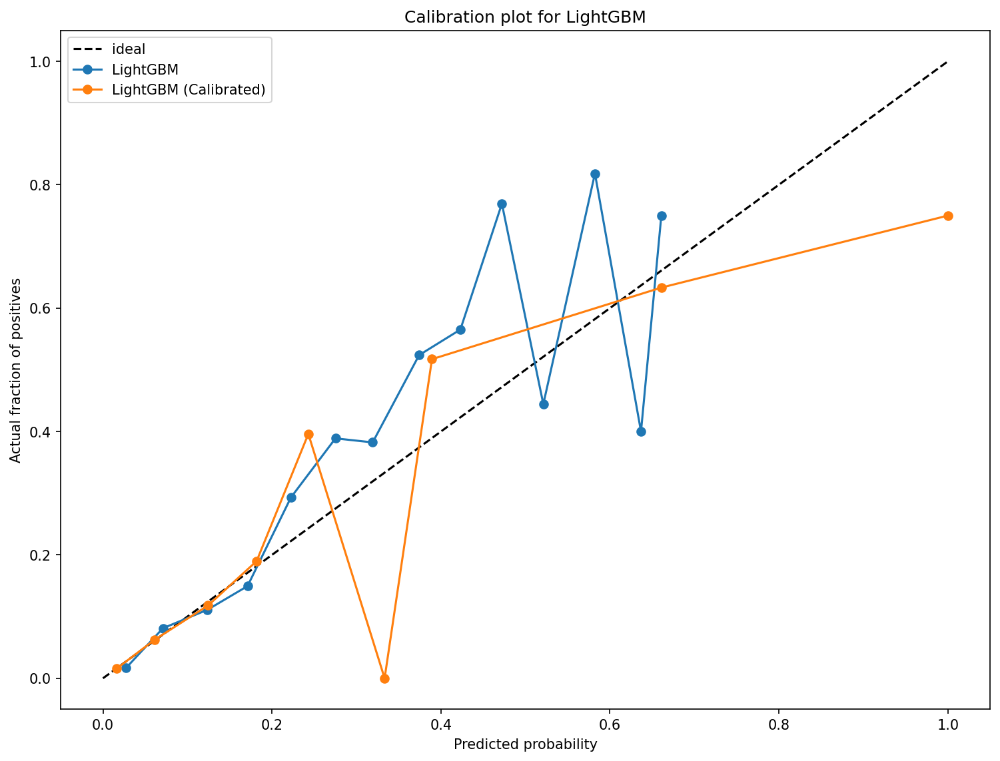

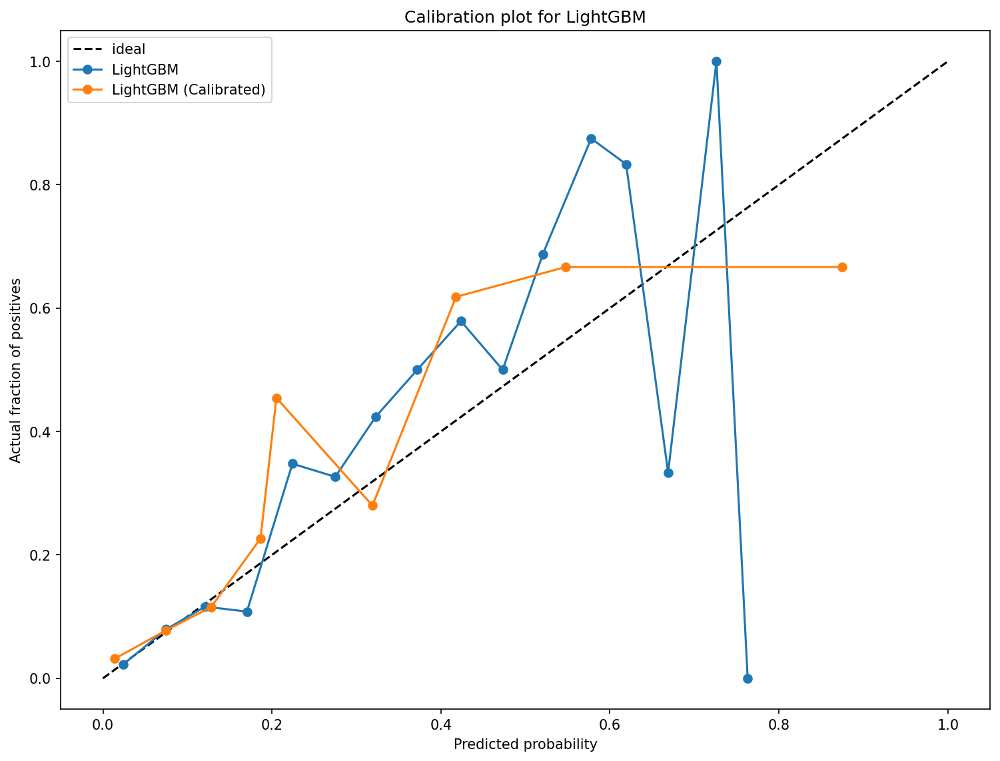

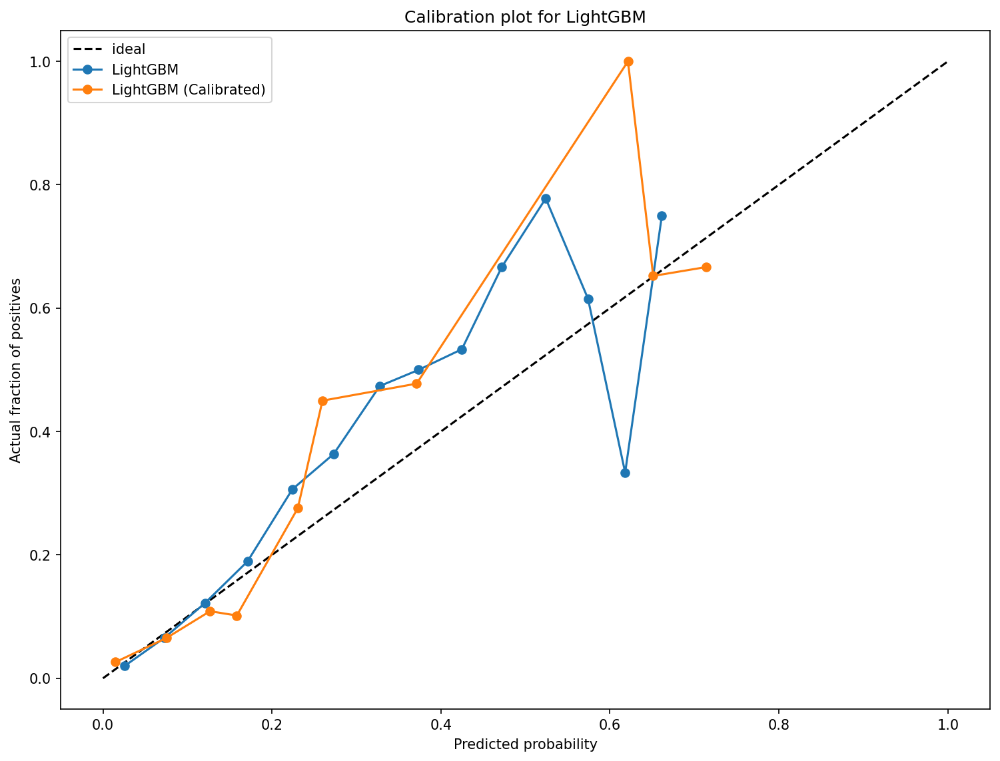

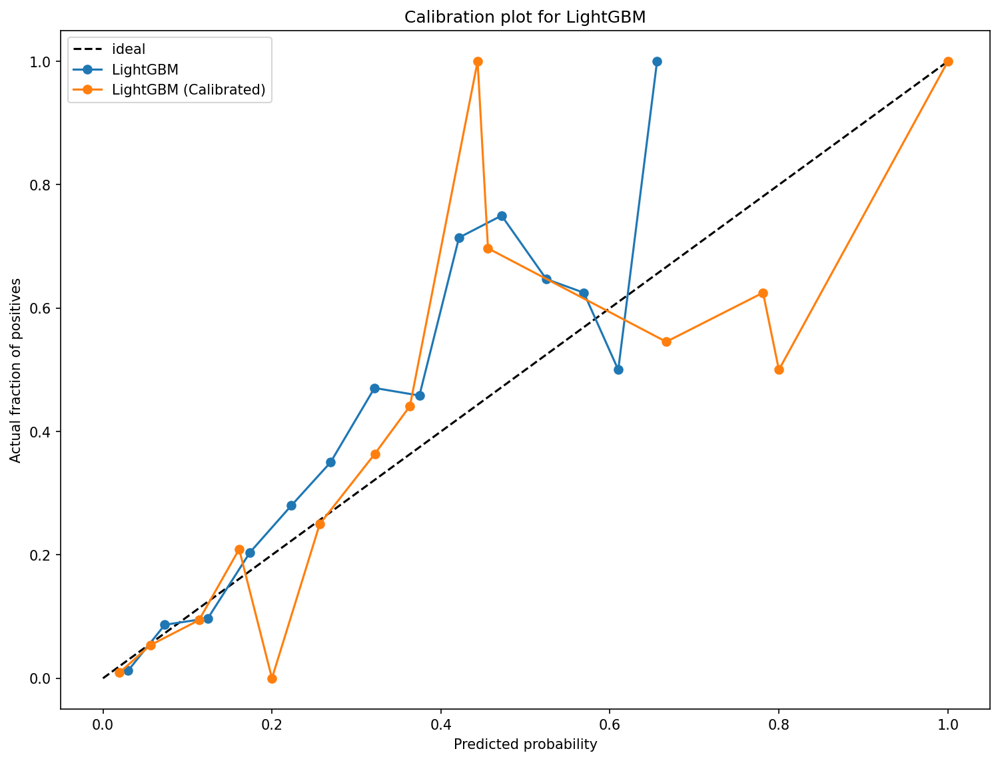

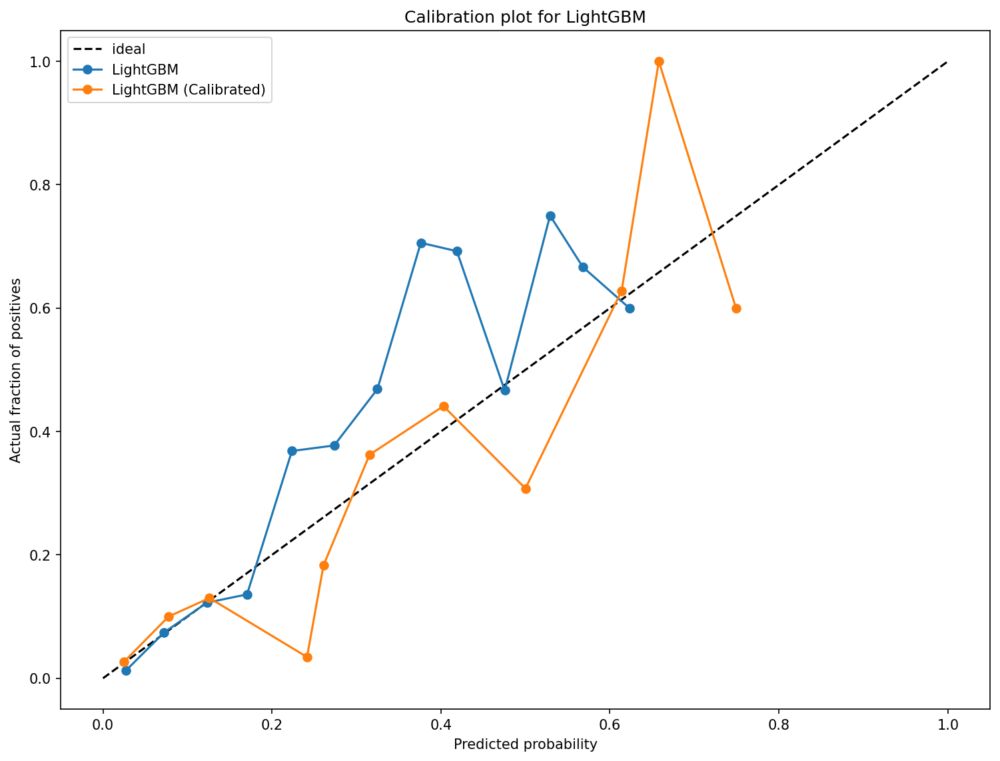

...

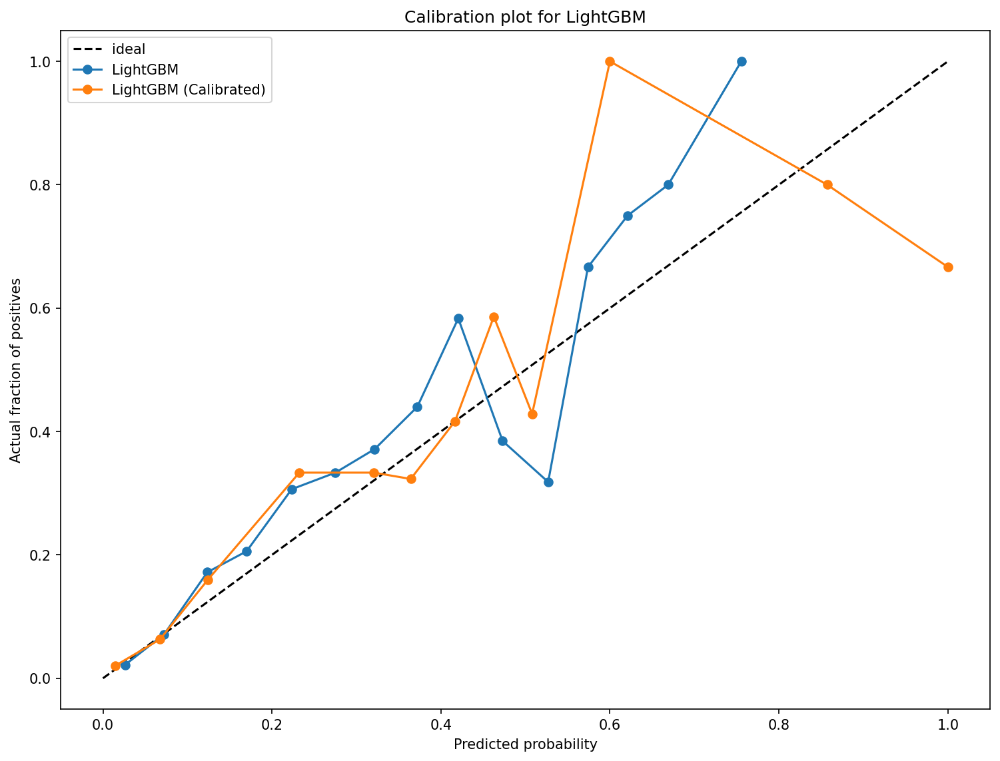

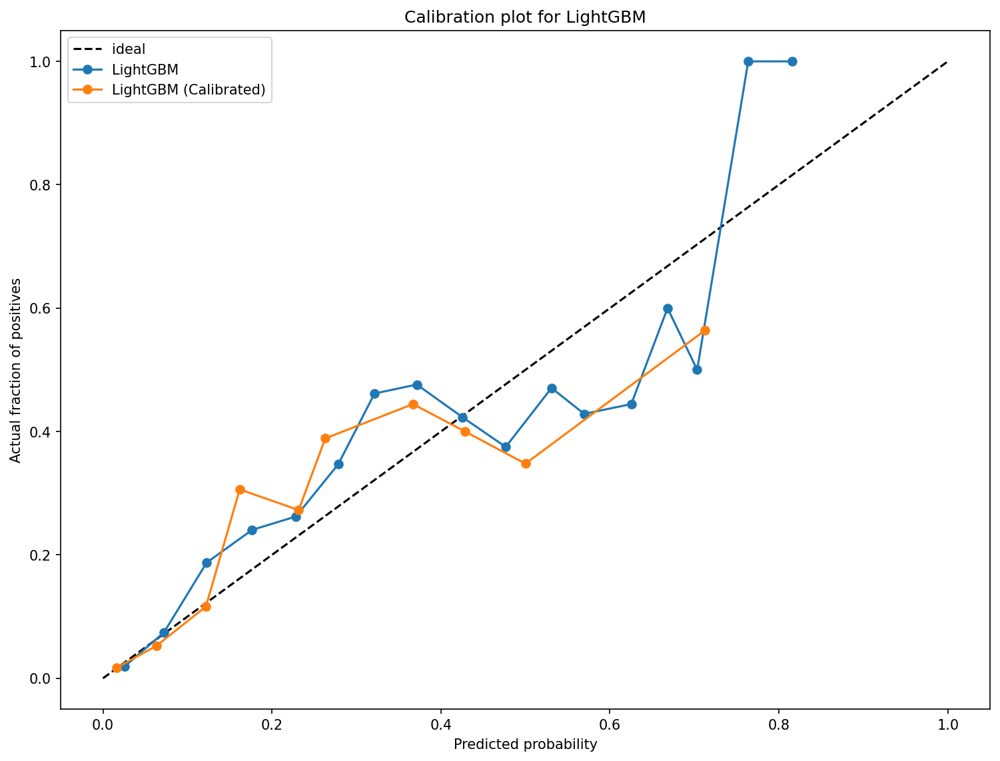

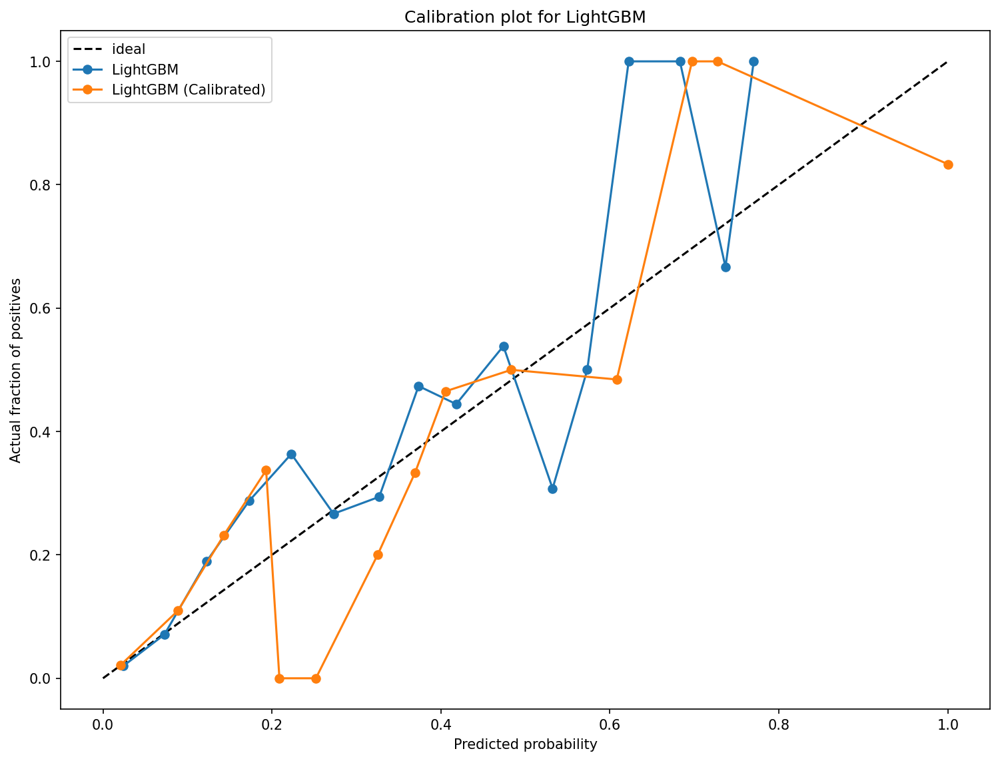

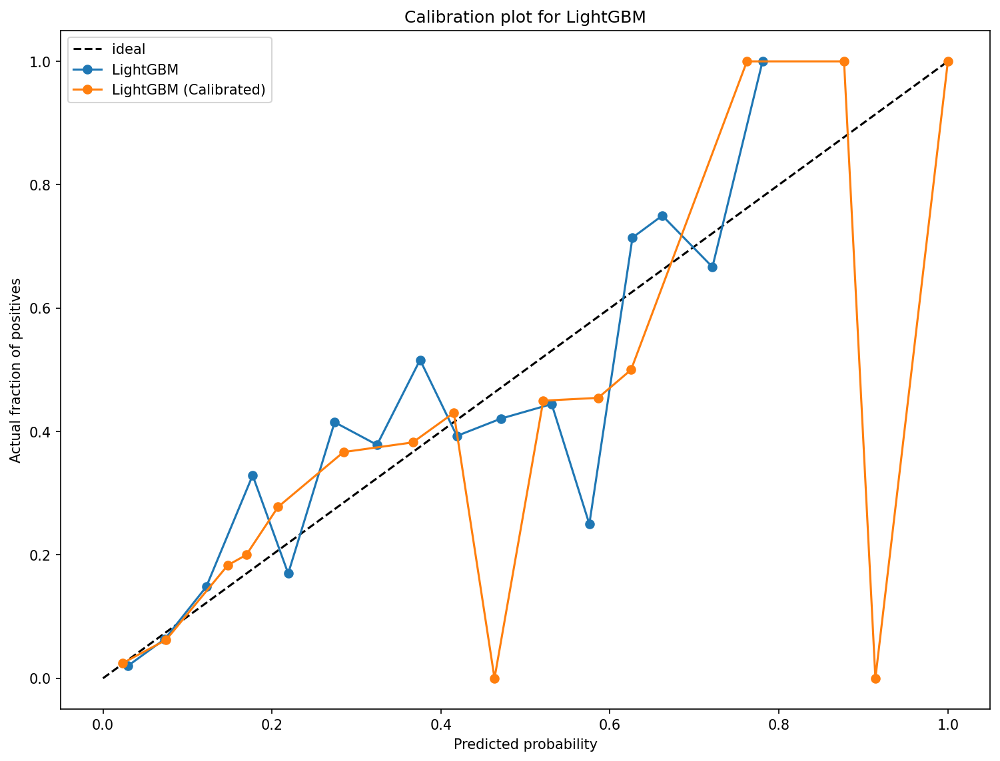

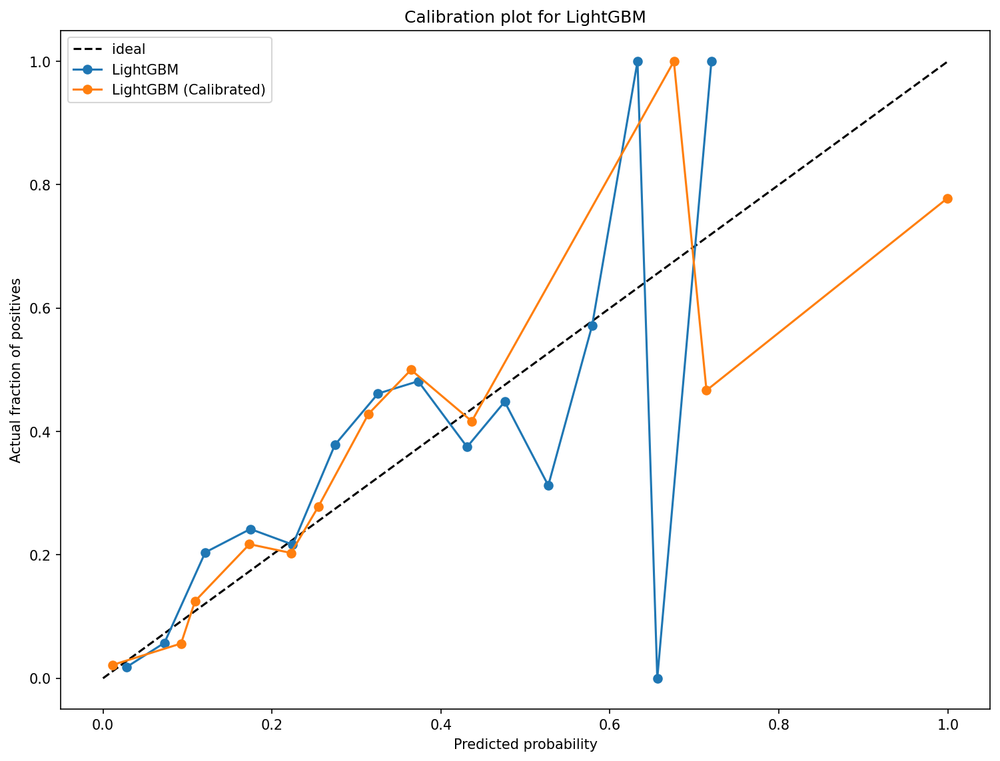

In [6]:
final_auroc_result = []
final_prauc_result = []
final_acc_result = []
final_ppv_result = []
final_npv_result = []
final_sens_result = []
final_spes_result = []

final_tn_result = []
final_fp_result = []
final_fn_result = []
final_tp_result = []

final_TN_last_N_result = []
final_TN_last_AB_result = []
final_FP_last_N_result = []
final_FP_last_AB_result = []
final_FN_last_N_result = []
final_FN_last_AB_result = []
final_TP_last_N_result = []
final_TP_last_AB_result = []

final_best_threshold_list_val = []

final_ece_loss_before_cal = []
final_ece_loss_after_cal = []
final_3rd_day_acc_in_FP = []    ## ***



SPLIT = 0
for random_split in random_index_list:
    
    print("\n************************* SPLIT %d **************************\n" % SPLIT)
    
#     kf = KFold(n_splits=5)
#     kf.get_n_splits(random_split)
#     for train_val_index, test_index in kf.split(random_split):
        
    train_val_index = random_split[:int(0.90*len(random_split))]
    test_index = random_split[int(0.90*len(random_split)):]
    print(len(train_val_index))
    print(len(test_index))

    train_val_data = []
    train_val_dem = []
    train_val_label = []
    for ind in train_val_index:
        train_val_data.extend([data[ind]])
        train_val_dem.extend([dem[ind]])
        train_val_label.extend([label[ind]])

    test_data = []
    test_dem = []
    test_label = []
    patient_indicator = []       ## ***
    ind_ = 0         ## ***
    for ind in test_index:
        test_data.extend([data[ind]])
        test_dem.extend([dem[ind]])
        test_label.extend([label[ind]])
        patient_indicator.extend([ind_]*len(label[ind]))       ## ***
        ind_ += 1       ## ***

    test_data = [i for i in test_data]
    test_data_temp = np.array([j for sub in test_data for j in sub])
    test_data_temp = test_data_temp[:, -1, :]
    test_dem = [i for i in test_dem]
    test_dem_temp = np.array([j for sub in test_dem for j in sub])
    test_label = [i for i in test_label]
    test_label_temp = np.array([j for sub in test_label for j in sub])

    test_temp = np.concatenate((test_data_temp, test_dem_temp), axis=1)

    auroc_result = []
    prauc_result = []
    acc_result = []
    ppv_result = []
    npv_result = []
    sens_result = []
    spes_result = []

    tn_result = []
    fp_result = []
    fn_result = []
    tp_result = []

    TN_last_N_result = []
    TN_last_AB_result = []
    FP_last_N_result = []
    FP_last_AB_result = []
    FN_last_N_result = []
    FN_last_AB_result = []
    TP_last_N_result = []
    TP_last_AB_result = []

    best_threshold_list_val = []

    ece_loss_before_cal = []
    ece_loss_after_cal = []
    
    third_day_acc_in_FP = []  ##   ***

    kf_inner = KFold(n_splits=5)
    kf_inner.get_n_splits(train_val_data)
    fold = 0
    for train_index, val_index in kf_inner.split(train_val_data):
        print(len(train_index))
        print(len(val_index))

        train_data = []
        train_dem = []
        train_label = []
        for ind in train_index:
            train_data.extend([train_val_data[ind]])
            train_dem.extend([train_val_dem[ind]])
            train_label.extend([train_val_label[ind]])

        val_data = []
        val_dem = []
        val_label = []
        for ind in val_index:
            val_data.extend([train_val_data[ind]])
            val_dem.extend([train_val_dem[ind]])
            val_label.extend([train_val_label[ind]])


        train_data = [i for i in train_data]
        train_data_temp = np.array([j for sub in train_data for j in sub])
        train_data_temp = train_data_temp[:, -1, :]
        train_dem = [i for i in train_dem]
        train_dem_temp = np.array([j for sub in train_dem for j in sub])
        train_label = [i for i in train_label]
        train_label_temp = np.array([j for sub in train_label for j in sub])
        train_temp = np.concatenate((train_data_temp, train_dem_temp), axis=1)

        val_data = [i for i in val_data]
        val_data_temp = np.array([j for sub in val_data for j in sub])
        val_data_temp = val_data_temp[:, -1, :]
        val_dem = [i for i in val_dem]
        val_dem_temp = np.array([j for sub in val_dem for j in sub])
        val_label = [i for i in val_label]
        val_label_temp = np.array([j for sub in val_label for j in sub])
        val_temp = np.concatenate((val_data_temp, val_dem_temp), axis=1)

        print("\n************************* CV Fold %d **************************\n" % fold)


        gbm = lgb.LGBMClassifier(n_estimators = 3000,
                         boosting_type = 'gbdt',
                         colsample_bytree = 0.300000000000001,
                         learning_rate = 0.005,
                         max_depth = 10,
                         min_child_samples = 5, 
                         min_child_weight = 5,
                         min_split_gain = 0.0,
                         n_jobs = -1,
                         num_leaves = 40,
                         objective = 'binary',
                         random_state = 0,
                         seed = 0,
                         reg_alpha = 0.0030559559479313415,
                         reg_lambda = 1.0949294490500017e-06, 
                         subsample = 0.9,
                         subsample_for_bin = 200000,
                         subsample_freq = 4,
                         verbose = -1,
                         metric = 'binary_logloss', scale_pos_weight=1)

        cat_idxs = [75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278, 279, 280, 281, 282, 283, 284, 285, 286, 287, 288, 289, 290, 291, 292, 293, 294, 295, 296, 297, 298, 299, 300, 301, 302, 303, 304, 305, 306, 307, 308, 309, 310, 311, 312, 313, 314, 315, 316, 317, 318, 319, 320, 321, 322, 323, 324, 325, 326, 327, 328, 329, 330, 331, 332, 333, 334, 335, 336, 337, 338, 339, 340, 341, 342, 343, 344, 345, 346, 347, 348, 349, 350, 351, 352, 353, 354, 355, 356, 357, 358, 359, 360, 361, 362, 363, 364, 365, 366, 367, 368]
        max_epochs = 3000 if not os.getenv("CI", False) else 2
        gbm.fit(train_temp, abs(train_label_temp), eval_set=[(val_temp, abs(val_label_temp))],early_stopping_rounds=300, categorical_feature = cat_idxs, verbose=-1)


        ##### vaildation evaluation

        y_scores = gbm.predict_proba(val_temp)
        y_scores = y_scores[:,1]
        fpr, tpr, threshold = roc_curve(abs(val_label_temp), y_scores, pos_label=1)
        max_ = 0
        pos = 0
        thres = 0
        for i in range(len(fpr)):
            sensitivity = tpr[i]
            specificity = 1 - fpr[i]
            if sensitivity + specificity - 1 > max_:
                thres = threshold[i]
                max_ = sensitivity + specificity - 1
                pos = i
        if Youden == False:
            thres = 0.5
        pred_y = [0.0] * len(y_scores)
        for ind, value in enumerate(y_scores):
            if value >= thres:
                pred_y[ind] = 1.0
        pred_y = np.array(pred_y)

        auroc = roc_auc_score(y_score=y_scores, y_true=abs(val_label_temp))
        prauc = average_precision_score(abs(val_label_temp), y_scores)

        tn, fp, fn, tp = confusion_matrix(abs(val_label_temp), pred_y).ravel()
        ppv = tp / (tp + fp)
        npv = tn / (tn + fn)
        sens = tp / (tp + fn)
        spes = tn / (tn + fp)
        acc = (tn + tp) / (tn + fp + fn + tp)

        FP_last_N = 0
        FP_last_AB = 0
        FN_last_N = 0
        FN_last_AB = 0
        TP_last_N = 0
        TP_last_AB = 0
        TN_last_N = 0
        TN_last_AB = 0
        for j in range(len(val_label_temp)):
            label_next = abs(val_label_temp[j])
            Comatose, Deceased, Delirious, Discharged, Normal, YYYYYY = val_temp[j][229], val_temp[j][230], val_temp[j][231], val_temp[j][232], val_temp[j][233], val_temp[j][234]

            predicted_label = pred_y[j]
            assert YYYYYY == 0
            if predicted_label != label_next:
                if predicted_label == 0: # FN .
                    if Discharged == 1 or Normal == 1:
                        FN_last_N += 1
                    else:
                        FN_last_AB += 1

                else: #FP
                    if Discharged == 1 or Normal == 1:
                        FP_last_N += 1
                    else:
                        FP_last_AB += 1
            else:
                if predicted_label == 0: # TN
                    if Discharged == 1 or Normal == 1:
                        TN_last_N += 1
                    else:
                        TN_last_AB += 1

                else: #TP
                    if Discharged == 1 or Normal == 1:
                        TP_last_N += 1
                    else:
                        TP_last_AB += 1


        print("Validation AUROC: %.4f, PRAUC: %.4f, ACC: %.4f, PPV: %.4f, NPV: %.4f, Sensitivity: %.4f, Specificity: %.4f. Best threshold %.4f" % (auroc, prauc, acc, ppv, npv, sens, spes, thres))
        print('| TN: %d (%d/%d)' % (tn, TN_last_N, TN_last_AB), '| FP: %d (%d/%d)' % (fp, FP_last_N, FP_last_AB),
          '| FN: %d (%d/%d)' % (fn, FN_last_N, FN_last_AB), '| TP: %d (%d/%d)' % (tp, TP_last_N, TP_last_AB),
          '| Total: %d' % (tn + fp + fn + tp))

        best_threshold_list_val.append(thres)
        joblib.dump(gbm, './result/Added_V50_uncalibrated_lgb_split_'+str(SPLIT)+'_run_'+str(fold)+'.pkl')


        ##### test before calibration

        y_scores_before = gbm.predict_proba(test_temp)
        y_scores_before = y_scores_before[:,1]
#         print(y_scores_before[:50])
        pred_y = [0.0] * len(y_scores_before)
        for ind, value in enumerate(y_scores_before):
            if value >= thres:
                pred_y[ind] = 1.0
        pred_y = np.array(pred_y)
        auroc = roc_auc_score(y_score=y_scores_before, y_true=abs(test_label_temp))
        prauc = average_precision_score(abs(test_label_temp), y_scores_before)
        tn, fp, fn, tp = confusion_matrix(abs(test_label_temp), pred_y).ravel()
        ppv = tp / (tp + fp)
        npv = tn / (tn + fn)
        sens = tp / (tp + fn)
        spes = tn / (tn + fp)
        acc = (tn + tp) / (tn + fp + fn + tp)
        
        ### analyze false postive ***
        FP_num = 0
        FP_num_3rd_acc_num = 0
        for ind_test in range(len(test_label_temp)):
            if int(pred_y[ind_test]) == 1 and int(abs(test_label_temp[ind_test])) != 1:
                FP_num += 1
                if ind_test < len(test_label_temp)-1 and patient_indicator[ind_test+1] == patient_indicator[ind_test] and int(abs(test_label_temp[ind_test+1])) == 1: 
                    FP_num_3rd_acc_num += 1
                    
        third_day_acc_in_FP.append(FP_num_3rd_acc_num/float(FP_num))
        

        FP_last_N = 0
        FP_last_AB = 0
        FN_last_N = 0
        FN_last_AB = 0
        TP_last_N = 0
        TP_last_AB = 0
        TN_last_N = 0
        TN_last_AB = 0
        for j in range(len(test_label_temp)):
            label_next = abs(test_label_temp[j])
            Comatose, Deceased, Delirious, Discharged, Normal, YYYYYY = test_temp[j][229], test_temp[j][230], test_temp[j][231], test_temp[j][232], test_temp[j][233], test_temp[j][234]

            predicted_label = pred_y[j]
            assert YYYYYY == 0
            if predicted_label != label_next:
                if predicted_label == 0: # FN ..
                    if Discharged == 1 or Normal == 1:
                        FN_last_N += 1
                    else:
                        FN_last_AB += 1

                else: #FP
                    if Discharged == 1 or Normal == 1:
                        FP_last_N += 1
                    else:
                        FP_last_AB += 1

            else:
                if predicted_label == 0: # TN
                    if Discharged == 1 or Normal == 1:
                        TN_last_N += 1
                    else:
                        TN_last_AB += 1

                else: #TP
                    if Discharged == 1 or Normal == 1:
                        TP_last_N += 1
                    else:
                        TP_last_AB += 1

        print(
        "Before Calibration:   Test AUROC: %.4f, PRAUC: %.4f, ACC: %.4f, PPV: %.4f, NPV: %.4f, Sensitivity: %.4f, Specificity: %.4f, FP_3rd_day_acc: %.4f" % (
        auroc, prauc, acc, ppv, npv, sens, spes, FP_num_3rd_acc_num/float(FP_num)))   ##   ***
        print('| TN: %d (%d/%d)' % (tn, TN_last_N, TN_last_AB), '| FP: %d (%d/%d)' % (fp, FP_last_N, FP_last_AB),
          '| FN: %d (%d/%d)' % (fn, FN_last_N, FN_last_AB), '| TP: %d (%d/%d)' % (tp, TP_last_N, TP_last_AB),
          '| Total: %d' % (tn + fp + fn + tp))

#         before_temperature_ece = ECE_value(y_scores_before, abs(test_label_temp), BIN)
        before_temperature_ece = brier_score_loss(abs(test_label_temp), y_scores_before, pos_label=1)
        print('ECE Loss Before Calibration: %.8f' % before_temperature_ece)
        ece_loss_before_cal.append(before_temperature_ece)
        
        auroc_result.append(auroc)
        prauc_result.append(prauc)
        acc_result.append(acc)
        ppv_result.append(ppv)
        npv_result.append(npv)
        sens_result.append(sens)
        spes_result.append(spes)
        tn_result.append(tn)
        tp_result.append(tp)
        fn_result.append(fn)
        fp_result.append(fp)

        TN_last_N_result.append(TN_last_N)
        TN_last_AB_result.append(TN_last_AB)
        FP_last_N_result.append(FP_last_N)
        FP_last_AB_result.append(FP_last_AB)
        FN_last_N_result.append(FN_last_N)
        FN_last_AB_result.append(FN_last_AB)
        TP_last_N_result.append(TP_last_N)
        TP_last_AB_result.append(TP_last_AB)
        
#         third_day_acc_in_FP.append(FP_num_3rd_acc_num/float(FP_num))   ##  ***

        ##### test after calibration 

        calibrator = CalibratedClassifierCV(gbm, method='isotonic', cv='prefit')
        calibrator.fit(val_temp, abs(val_label_temp))
        
        ################### need to recompute the threshold on validation set
        y_scores_temp = calibrator.predict_proba(val_temp)
        y_scores_temp = y_scores_temp[:,1]
        fpr, tpr, threshold = roc_curve(abs(val_label_temp), y_scores_temp, pos_label=1)
        max_ = 0
        pos = 0
        thres = 0
        for i in range(len(fpr)):
            sensitivity = tpr[i]
            specificity = 1 - fpr[i]
            if sensitivity + specificity - 1 > max_:
                thres = threshold[i]
                max_ = sensitivity + specificity - 1
                pos = i
        if Youden == False:
            thres = 0.5
        
        ###################

        y_scores_after = calibrator.predict_proba(test_temp)
        y_scores_after = y_scores_after[:,1]
#         print(y_scores_after[:50])
        pred_y = [0.0] * len(y_scores_after)
        for ind, value in enumerate(y_scores_after):
            if value >= thres:
                pred_y[ind] = 1.0
        pred_y = np.array(pred_y)
        auroc = roc_auc_score(y_score=y_scores_after, y_true=abs(test_label_temp))
        prauc = average_precision_score(abs(test_label_temp), y_scores_after)
        tn, fp, fn, tp = confusion_matrix(abs(test_label_temp), pred_y).ravel()
        ppv = tp / (tp + fp)
        npv = tn / (tn + fn)
        sens = tp / (tp + fn)
        spes = tn / (tn + fp)
        acc = (tn + tp) / (tn + fp + fn + tp)

        FP_last_N = 0
        FP_last_AB = 0
        FN_last_N = 0
        FN_last_AB = 0
        TP_last_N = 0
        TP_last_AB = 0
        TN_last_N = 0
        TN_last_AB = 0
        for j in range(len(test_label_temp)):
            label_next = abs(test_label_temp[j])
            Comatose, Deceased, Delirious, Discharged, Normal, YYYYYY = test_temp[j][229], test_temp[j][230], test_temp[j][231], test_temp[j][232], test_temp[j][233], test_temp[j][234]
  
            predicted_label = pred_y[j]
            assert YYYYYY == 0
            if predicted_label != label_next:
                if predicted_label == 0: # FN ...
                    if Discharged == 1 or Normal == 1:
                        FN_last_N += 1
                    else:
                        FN_last_AB += 1

                else: #FP
                    if Discharged == 1 or Normal == 1:
                        FP_last_N += 1
                    else:
                        FP_last_AB += 1

            else:
                if predicted_label == 0: # TN
                    if Discharged == 1 or Normal == 1:
                        TN_last_N += 1
                    else:
                        TN_last_AB += 1

                else: #TP
                    if Discharged == 1 or Normal == 1:
                        TP_last_N += 1
                    else:
                        TP_last_AB += 1


        print(
        "After Calibration:   Test AUROC: %.4f, PRAUC: %.4f, ACC: %.4f, PPV: %.4f, NPV: %.4f, Sensitivity: %.4f, Specificity: %.4f, Best threshold: %.4f" % (
        auroc, prauc, acc, ppv, npv, sens, spes, thres))
        print('| TN: %d (%d/%d)' % (tn, TN_last_N, TN_last_AB), '| FP: %d (%d/%d)' % (fp, FP_last_N, FP_last_AB),
          '| FN: %d (%d/%d)' % (fn, FN_last_N, FN_last_AB), '| TP: %d (%d/%d)' % (tp, TP_last_N, TP_last_AB),
          '| Total: %d' % (tn + fp + fn + tp))

        
        prob_df_cal_before = pd.DataFrame({'y':abs(test_label_temp), 'y_hat': y_scores_before})
        # binning the dataframe, so we can see success rates for bins of probability
        bins = np.arange(0.05, 1.00, 0.05)
        prob_df_cal_before.loc[:,'prob_bin'] = np.digitize(prob_df_cal_before['y_hat'], bins)
        prob_df_cal_before.loc[:,'prob_bin_test'] = prob_df_cal_before['prob_bin'].replace(dict(zip(range(len(bins) + 1), list(bins) + [1.00])))

        prob_df_cal_after = pd.DataFrame({'y':abs(test_label_temp), 'y_hat': y_scores_after})
        # binning the dataframe, so we can see success rates for bins of probability
        bins = np.arange(0.05, 1.00, 0.05)
        prob_df_cal_after.loc[:,'prob_bin'] = np.digitize(prob_df_cal_after['y_hat'], bins)
        prob_df_cal_after.loc[:,'prob_bin_test'] = prob_df_cal_after['prob_bin'].replace(dict(zip(range(len(bins) + 1), list(bins) + [1.00])))

        
        #         prob_df_cal_before['y_hat_test'] = y_scores_after
#         prob_df_cal_before.to_csv('./result/test_cal_result_split_'+str(SPLIT)+'_run_'+str(fold) +'.csv', index=False)
#         opening figure
        plt.figure(figsize=(12,9), dpi=150)

#         plotting ideal line
        plt.plot([0,1],[0,1], 'k--', label='ideal')

        # plotting calibration for lgbm
        calibration_y = prob_df_cal_before.groupby('prob_bin_test')['y'].mean()
        calibration_x = prob_df_cal_before.groupby('prob_bin_test')['y_hat'].mean()
        plt.plot(calibration_x, calibration_y, marker='o', label='LightGBM')


        calibration_y_test = prob_df_cal_after.groupby('prob_bin_test')['y'].mean()
        calibration_x_test = prob_df_cal_after.groupby('prob_bin_test')['y_hat'].mean()
        plt.plot(calibration_x_test, calibration_y_test, marker='o', label='LightGBM (Calibrated)')

        # legend and titles
        plt.title('Calibration plot for LightGBM')
        plt.xlabel('Predicted probability')
        plt.ylabel('Actual fraction of positives')
        plt.legend()
        
        np.save('./result/Added_V50_prediction_on_test_split_'+str(SPLIT)+'_run_'+str(fold)+'.npy', y_scores_after)
        joblib.dump(calibrator, './result/Added_V50_calibrated_lgb_split_'+str(SPLIT)+'_run_'+str(fold)+'.pkl')


        explainer = shap.TreeExplainer(gbm)
        shap_values = explainer.shap_values(test_temp)
        np.save('./result/Added_V50_shap_values_split_'+ str(SPLIT)+'_run_'+str(fold)+'.npy', shap_values)
        fold += 1

#         after_temperature_ece = ECE_value(y_scores_after, abs(test_label_temp), BIN)
        after_temperature_ece = brier_score_loss(abs(test_label_temp), y_scores_after, pos_label=1)
        print('ECE Loss After Calibration: %.8f' % after_temperature_ece)
        ece_loss_after_cal.append(after_temperature_ece)

    result_dict = {'PRAUC': prauc_result, 'AUROC': auroc_result, 'ACC': acc_result, 'Recall': sens_result, 'Specificity': spes_result, 'PPV': ppv_result, 'NPV':npv_result, 'TN': tn_result, 'TP': tp_result, 'FN':fn_result, 'FP':fp_result, 'TN_last_N_result':TN_last_N_result,  'TN_last_AB_result':TN_last_AB_result, 'FN_last_N_result':FN_last_N_result,  'FN_last_AB_result':FN_last_AB_result, 'Threshold':best_threshold_list_val}
    np.save('./result/Added_V50_summary_result_split_'+str(SPLIT)+'.npy', result_dict)

    final_auroc_result.extend(auroc_result)
    final_prauc_result.extend(prauc_result)
    final_acc_result.extend(acc_result)
    final_ppv_result.extend(ppv_result)
    final_npv_result.extend(npv_result)
    final_sens_result.extend(sens_result)
    final_spes_result.extend(spes_result)

    final_tn_result.extend(tn_result)
    final_fp_result.extend(fp_result)
    final_fn_result.extend(fn_result)
    final_tp_result.extend(tp_result)

    final_TN_last_N_result.extend(TN_last_N_result)
    final_TN_last_AB_result.extend(TN_last_AB_result)
    final_FP_last_N_result.extend(FP_last_N_result)
    final_FP_last_AB_result.extend(FP_last_AB_result)
    final_FN_last_N_result.extend(FN_last_N_result)
    final_FN_last_AB_result.extend(FN_last_AB_result)
    final_TP_last_N_result.extend(TP_last_N_result)
    final_TP_last_AB_result.extend(TP_last_AB_result)

    final_best_threshold_list_val.extend(best_threshold_list_val)
    final_ece_loss_before_cal.extend(ece_loss_before_cal)
    final_ece_loss_after_cal.extend(ece_loss_after_cal)
    
    final_3rd_day_acc_in_FP.extend(third_day_acc_in_FP)  ## ***
        
    SPLIT += 1

print('AUROC mean %.4f,  std %.4f' % (np.mean(final_auroc_result), np.std(final_auroc_result)))
print('PRAUC mean %.4f,  std %.4f' % (np.mean(final_prauc_result), np.std(final_prauc_result)))
print('ACCURACY mean %.4f,  std %.4f' % (np.mean(final_acc_result), np.std(final_acc_result)))
print('PPV mean %.4f,  std %.4f' % (np.mean(final_ppv_result), np.std(final_ppv_result)))
print('NPV mean %.4f,  std %.4f' % (np.mean(final_npv_result), np.std(final_npv_result)))
print('RECALL mean %.4f,  std %.4f' % (np.mean(final_sens_result), np.std(final_sens_result)))
print('SPESIFICITY mean %.4f,  std %.4f' % (np.mean(final_spes_result), np.std(final_spes_result)))

print('\nTN_last_N mean %.4f,  std %.4f' % (np.mean(final_TN_last_N_result), np.std(final_TN_last_N_result)))
print('TN_last_AB mean %.4f,  std %.4f' % (np.mean(final_TN_last_AB_result), np.std(final_TN_last_AB_result)))
print('FP_last_N mean %.4f,  std %.4f' % (np.mean(final_FP_last_N_result), np.std(final_FP_last_N_result)))
print('FP_last_AB mean %.4f,  std %.4f' % (np.mean(final_FP_last_AB_result), np.std(final_FP_last_AB_result)))
print('FN_last_N mean %.4f,  std %.4f' % (np.mean(final_FN_last_N_result), np.std(final_FN_last_N_result)))
print('FN_last_AB mean %.4f,  std %.4f' % (np.mean(final_FN_last_AB_result), np.std(final_FN_last_AB_result)))
print('TP_last_N mean %.4f,  std %.4f' % (np.mean(final_TP_last_N_result), np.std(final_TP_last_N_result)))
print('TP_last_AB mean %.4f,  std %.4f' % (np.mean(final_TP_last_AB_result), np.std(final_TP_last_AB_result)))

print('final_3rd_day_acc_in_FP %.4f,  std %.4f' % (np.mean(final_3rd_day_acc_in_FP), np.std(final_3rd_day_acc_in_FP)))   ## ***

print('\nBrier score before calibration mean %.4f, std %.4f' % (np.mean(final_ece_loss_before_cal), np.std(final_ece_loss_before_cal)))
print('Brier score after calibration mean %.4f, std %.4f' % (np.mean(final_ece_loss_after_cal), np.std(final_ece_loss_after_cal)))

import scipy

def mean_confidence_interval(data, confidence=0.95):
    a = 1.0 * np.array(data)
    n = len(a)
    m, se = np.mean(a), scipy.stats.sem(a)
    h = se * scipy.stats.t.ppf((1 + confidence) / 2., n-1)
    return m, m-h, m+h


auroc_list = []
prauc_list = []
acc_list = []
recall_list = []
spes_list = []
ppv_list = []
npv_list = []


for SPLIT in range(RAND_TIME):
    result_dict = np.load('./result/Added_V50_summary_result_split_'+str(SPLIT)+'.npy', allow_pickle=True).item()
    auroc_list.extend(result_dict['AUROC'])
    prauc_list.extend(result_dict['PRAUC'])
    acc_list.extend(result_dict['ACC'])
    recall_list.extend(result_dict['Recall'])
    spes_list.extend(result_dict['Specificity'])
    ppv_list.extend(result_dict['PPV'])
    npv_list.extend(result_dict['NPV'])


var = "%"

m, b, t = mean_confidence_interval(auroc_list)
print('AUROC: %.3f (%.3f, %.3f) ' % (m, b, t))

m, b, t = mean_confidence_interval(prauc_list)
print('PRAUC: %.3f (%.3f, %.3f) ' % (m, b, t))

m, b, t = mean_confidence_interval(acc_list)
print('Accuracy: %.3f (%.3f, %.3f) ' % (m, b, t))

m, b, t = mean_confidence_interval(recall_list)
print('Recall: %.3f (%.3f, %.3f) ' % (m, b, t))

m, b, t = mean_confidence_interval(spes_list)
print('Specificity: %.3f (%.3f, %.3f) ' % (m, b, t))

m, b, t = mean_confidence_interval(ppv_list)
print('PPV: %.3f (%.3f, %.3f) ' % (m, b, t))

m, b, t = mean_confidence_interval(npv_list)
print('NPV: %.3f (%.3f, %.3f) ' % (m, b, t))

m, b, t = mean_confidence_interval(final_3rd_day_acc_in_FP)
print('final_3rd_day_acc_in_FP: %.3f (%.3f, %.3f) ' % (m, b, t))

m, b, t = mean_confidence_interval(final_ece_loss_before_cal)
print('final_ece_loss_before_cal: %.3f (%.3f, %.3f) ' % (m, b, t))

m, b, t = mean_confidence_interval(final_ece_loss_after_cal)
print('final_ece_loss_after_cal: %.3f (%.3f, %.3f) ' % (m, b, t))

            